

<p align="center">
    <img src="https://github.com/GeostatsGuy/GeostatsPy/blob/master/TCG_color_logo.png?raw=true" width="220" height="240" />

</p>


## Machine Learning to detect Rig State (Sliding vs. Rotary Drilling)

#### Ysabel Witt-Doerring
#### Petroleum and Geosystems Engineering, Cockrell School of Engineering

### Subsurface Machine Learning Course, The University of Texas at Austin
#### Hildebrand Department of Petroleum and Geosystems Engineering, Cockrell School of Engineering
#### Department of Geological Sciences, Jackson School of Geosciences




_____________________

Workflow supervision and review by:

#### Instructor: Prof. Michael Pyrcz, Ph.D., P.Eng., Associate Professor, The Univeristy of Texas at Austin
##### [Twitter](https://twitter.com/geostatsguy) | [GitHub](https://github.com/GeostatsGuy) | [Website](http://michaelpyrcz.com) | [GoogleScholar](https://scholar.google.com/citations?user=QVZ20eQAAAAJ&hl=en&oi=ao) | [Book](https://www.amazon.com/Geostatistical-Reservoir-Modeling-Michael-Pyrcz/dp/0199731446) | [YouTube](https://www.youtube.com/channel/UCLqEr-xV-ceHdXXXrTId5ig)  | [LinkedIn](https://www.linkedin.com/in/michael-pyrcz-61a648a1)

#### Course TA: Jack Xiao, Graduate Student, The University of Texas at Austin
##### [Twitter](https://twitter.com/jackxiao6) | [LinkedIn](https://www.linkedin.com/in/yuchen-jack-xiao-b1b20876/)


### Executive Summary

Current rig state detection is done using a series of conditional statements. For example, sliding mode could be simply determined from when bit depth equaled hole depth and drill string rotations per minute (RPM) equaled zero. Now as pipe rocking (rotating the pipe back and forth during sliding to help overcome wellbore friction) becomes more common place it is harder to determining this rig state when completing big data analytics from a simple conditional statement. This project is a classification problem, in which rig state, rotary drilling (making hole by rotating the drill pipe and motor) vs. sliding (making hole using the motor only) is determined.PyTorch being used to build a simple neutral net to classify the rig state. By selecting the right features, learning rate, and number of epochs it is possible to accurate identify sliding vs. drilling. As rig site computing limitation and rig communciation systems improve it is possible to use machine learning to accurately identify rig states. 


### Import Packages

In [28]:
import numpy as np                        # arrays and matrix math
import pandas as pd                       # DataFrames and plotting
# from enum import Enum
# import itertools
# from functools import reduce

import matplotlib                         # plotting
import matplotlib.pyplot as plt           # plotting
import matplotlib.dates as mdates         # date format on graphs
import mplcursors                         # visualisations (help when labelling data)
import re                                 # regex for visualisation

import geostatspy.GSLIB as GSLIB          # GSLIB utilies, visualization and wrapper
import geostatspy.geostats as geostats    # GSLIB methods convert to Python 
from scipy import stats                   # summary statistics for model 
from scipy import linalg                  # for linear regression
import pandas.plotting as pd_plot         # matrix scatter

import torch                              # machine
import torch.nn.functional as F           # activation functions
from sklearn import preprocessing         # normalising data 

from sklearn import metrics as mm         # metrics for results 
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error,classification_report,confusion_matrix # metrics for results
from math import sqrt                     # math for results

import seaborn as sns                     #import for confusion matrix
import warnings; warnings.simplefilter('ignore')        # Hide warnings (associated with stand visualisations)






For formatting and centering outputs:

In [29]:
from IPython.display import display, HTML #centre figures 

display(HTML("""
<style>
.output {
    display: flex;
    align-items: center;
    text-align: center;
}
</style>
"""))

### Functions

The following functions will be used in the workflow:

In [30]:
# Preprocessing for drilling data 

def preprocess_data(data):
        if isinstance(data.index, pd.DatetimeIndex): # checking if already the index is datetime
            pass
        else:
            data.sort_values(by='Date/Time')
        # check if all the channels are there
        data = data.replace(-999.25, np.nan)
        data = data.replace(-999, np.nan)
        blkvel_calc = np.diff(data['BPOS'])
        blkvel_calc = np.append(0, blkvel_calc)
        data = data.assign(BLKVEL_CALC=blkvel_calc)
        data = data.assign(ABS_BLKVEL_CALC=np.abs(blkvel_calc))
        data = data.assign(BLOCK_STATE=['d' if b < 0 else 'u' if b > 0 else 's' for b in blkvel_calc])
        # update the index
        data['Date/Time'] = pd.to_datetime(data['Date/Time'].values, infer_datetime_format=True, errors='coerce',
                                           format='%Y-%m-%d %H:%M:%S')
        data['Date/Time'] = data["Date/Time"].dt.tz_localize(None)
        data.index = data["Date/Time"] #replace index w/ Date/Time
# #         # forward fill for 30 secs
#         data = forward_fill_30secs(data)
#         data['HKLD'] = forward_fill_30secs(data['HKLD'])
        data['SPPA'] = forward_fill_30secs(data['SPPA'])
        data['RPM'] = forward_fill_30secs(data['RPM'])
        data['BPOS'] = forward_fill_30secs(data['BPOS'])
        data['DEPT'] = forward_fill_30secs(data['DEPT'])
        data['HDTH'] = forward_fill_30secs(data['HDTH'])
        data['ROP'] = forward_fill_30secs(data['ROP'])
        data['STOR'] = forward_fill_30secs(data['STOR'])
        data['SWOB'] = forward_fill_30secs(data['SWOB'])
    
        return data
    
def compute_timestep(data):
    return np.rint(np.mean(np.diff(data.index)) / np.timedelta64(1, 's'))

def forward_fill_30secs(data):
    timestep = compute_timestep(data)
    ffill_nb = 30
    if timestep > 0:
        if int(np.rint(30 / timestep)):
            ffill_nb = int(np.rint(30 / timestep))
        else:
            ffill_nb = 30  # hardcode to 30
    return data.ffill(limit=ffill_nb)

In [31]:
# Stand detection for stand by stand visualisations, from Oney Erge, https://github.com/iodriller

class initiate_partitioning:
    def __init__(self):
        self.tubular_element_partitions = []
        self.run_partitions = []
        self.data = None

    def run_classifications(self, data):
        self.data = data
        self.__bootstrap_partitions()
        return self.data, self.tubular_element_partitions

    def __bootstrap_partitions(self):
        rs = rig_states()
        self.data = self.data.assign(RIG_STATE=rs.calculate_rig_states(self.data))

        te = tubular_element()
        self.tubular_element_partitions = te.partition_data(self.data)

        
class rig_states:
    def __init__(self):
        self.pressure_channel = 'SPPA'  # ['SPPA', 'FLWI', 'TSPM']
        self.rotary_channel = 'RPM'  # ['RPM', 'STOR']
        self.pump_thresholds = {
            'sppa_threshold': 400,  # psi
            'flow_threshold': 50,  # gpm
            'stroke_threshold': 5  # spm
        }
        self.rotary_thresholds = {
            'rpm_threshold': 5,  # c/min
            'stor_threshold': 0.1  # kft.lbf
        }
        self.onbottom_threshold = 0.1  # ft - difference between hdth and dept
        self.hkld_threshold = 60  # klbf - for slips detection

    def calculate_rig_states(self, df):

        Rig_Activities = []
        Rig_States = []

        if len(df) > 1:
            slip_stat = self.is_inslips(df['HKLD'], self.hkld_threshold)
            bonb = self.is_onbottom(df['HDTH'], df['DEPT'], self.onbottom_threshold)
            pumping = self.is_pumping(self.pressure_channel, self.pump_thresholds, df[self.pressure_channel])
            rotating = self.is_rotating(self.rotary_channel, self.rotary_thresholds, df[self.rotary_channel])

            blkvel_calc = df['BLKVEL_CALC']
            block_state = np.zeros((len(df.index)))
            block_state[np.where(blkvel_calc < 0)] = 0
            block_state[np.where(blkvel_calc > 0)] = 1
            block_state[np.where(blkvel_calc == 0)] = 2
            Rig_Activities = [slip_stat, bonb, pumping, rotating, block_state]  # is not used now

            empty_indices = np.unique(np.concatenate(((self.is_empty(self.pressure_channel, df),
                                                       self.is_empty(self.rotary_channel, df),
                                                       self.is_empty(['BPOS'], df),
                                                       self.is_empty(['HKLD'], df)))))

            Rig_States = self.do_calculate(slip_stat, bonb, pumping, rotating, block_state, empty_indices, df)
            
        return Rig_States

    def is_pumping(self, pressure_channel, pump_thresholds, df_sub):
        if pressure_channel == 'SPPA':
            return df_sub > pump_thresholds['sppa_threshold']
        elif pressure_channel == 'FLWI':
            return df_sub > pump_thresholds['flow_threshold']
        elif pressure_channel == 'TSPM':
            return df_sub > pump_thresholds['stroke_threshold']

    def is_rotating(self, rotary_channel, rotary_thresholds, df_sub):
        if rotary_channel == 'RPM':
            return df_sub > rotary_thresholds['rpm_threshold']
        elif rotary_channel == 'STOR':
            return df_sub > rotary_thresholds['stor_threshold']

    @staticmethod
    def is_empty(channel, df_sub):
        result = np.where((df_sub[channel] < -900) | (np.isnan(df_sub[channel])) | (df_sub[channel] is None))
        return result[0]

    @staticmethod
    def is_onbottom(hdth, depth, onbottom_threshold):
        return np.abs(hdth - depth) < onbottom_threshold

    @staticmethod
    def is_inslips(hkld, hkld_threshold):
        return hkld < hkld_threshold

    def do_calculate(self, slip_stat, bonb, pumping, rotating, block_state, empty_indices, df):

        Rig_States = np.zeros((len(df.index)))

        Rig_States[empty_indices] = 15

        Rig_States[np.where(bonb == True)] = 1

        Rig_States[np.where((bonb == False) & (block_state == 0) & (pumping == True) & (rotating == True))] = 3
        Rig_States[np.where((bonb == False) & (block_state == 0) & (pumping == True) & (rotating == False))] = 4
        Rig_States[np.where((bonb == False) & (block_state == 0) & (pumping == False) & (rotating == True))] = 5
        Rig_States[np.where((bonb == False) & (block_state == 0) & (pumping == False) & (rotating == False))] = 6

        Rig_States[np.where((bonb == False) & (block_state == 1) & (pumping == True) & (rotating == True))] = 7
        Rig_States[np.where((bonb == False) & (block_state == 1) & (pumping == True) & (rotating == False))] = 8
        Rig_States[np.where((bonb == False) & (block_state == 1) & (pumping == False) & (rotating == True))] = 9
        Rig_States[np.where((bonb == False) & (block_state == 1) & (pumping == False) & (rotating == False))] = 10

        Rig_States[np.where((bonb == False) & (block_state == 2) & (pumping == True) & (rotating == True))] = 11
        Rig_States[np.where((bonb == False) & (block_state == 2) & (pumping == True) & (rotating == False))] = 12
        Rig_States[np.where((bonb == False) & (block_state == 2) & (pumping == False) & (rotating == True))] = 13
        Rig_States[np.where((bonb == False) & (block_state == 2) & (pumping == False) & (rotating == False))] = 14

        Rig_States[np.where(slip_stat == True)] = 2
        
        return Rig_States
    
    
class tubular_element:
    def __init__(self, slips_bpos_low_boundary=5.0, slips_bpos_high_boundary=140.0):
        self.slips_bpos_low_boundary = slips_bpos_low_boundary
        self.slips_bpos_high_boundary = slips_bpos_high_boundary

    def partition_data(self, df):
        print(df["RIG_STATE"].values)
        rig_states = df["RIG_STATE"].values
        bpos = df["BPOS"].values
        going_into_slips_inds = np.where((rig_states[:-1] != 2) & (rig_states[1:] == 2))[0]
        coming_out_of_slips_inds = np.where((rig_states[:-1] == 2) & (rig_states[1:] != 2))[0]

        inds_ = np.searchsorted(going_into_slips_inds, coming_out_of_slips_inds)

        inds_not_zero = np.where(inds_ != 0)[0]  # remove potential coming out of slips occurring before first in slips

        slips_starts = going_into_slips_inds[inds_[inds_not_zero] - 1]
        slips_stops = coming_out_of_slips_inds[inds_not_zero]

        slips_starts_bpos = bpos[slips_starts]
        slips_stops_bpos = bpos[slips_stops]

        bpos_diff = slips_stops_bpos - slips_starts_bpos
        bpos_diff_not_nan = np.where(~np.isnan(bpos_diff))[0]

        connections = np.where((np.abs(bpos_diff[bpos_diff_not_nan]) >= self.slips_bpos_low_boundary) &
                               (np.abs(bpos_diff[bpos_diff_not_nan]) <= self.slips_bpos_high_boundary))[0]

        slips_starts_connections = slips_starts[bpos_diff_not_nan][connections]
        slips_stops_connections = slips_stops[bpos_diff_not_nan][connections]

        tubular_element_lengths = bpos_diff[bpos_diff_not_nan][connections][:-1]
        tubular_element_added = tubular_element_lengths > 0
        tubular_element_lengths = np.abs(tubular_element_lengths)
        tubular_element_starts = slips_starts_connections[:-1] + 1  # +1 to include first data point in slips
        tubular_element_stops = slips_starts_connections[1:] + 1  # +1 to include first data point in slips
        tubular_element_connection_stops = slips_stops_connections[:-1]

        tubular_element_partitions = []
        for i in range(len(tubular_element_lengths)):
            start = tubular_element_starts[i]
            stop = tubular_element_stops[i]
            connection_stop = tubular_element_connection_stops[i]
            data = df[start:stop + 1]  # +1 to include stop point
            tubular_element_partition = {'index': i + 1,  # 1-indexed for Matlab purposes
                                         'start_time': data.index[0],
                                         'end_time': data.index[-1],
                                         'added': tubular_element_added[i],
                                         'length': tubular_element_lengths[i],
                                         'connection': {
                                             'start_time': data.index[0],
                                             'end_time': df.index[connection_stop + 1],  # +1 to include stop point
                                         },
                                         'drilling_partitions': [],
                                         'tripping_in_partitions': [],
                                         'tripping_out_partitions': []}
            tubular_element_partitions.append(tubular_element_partition)

        return tubular_element_partitions


### Load Data

The following workflow applies to the .csv file 'Time.csv', which is 1 Hz surface EDR data from a single bit run 

Teh data set includes the following features:

* **Date/Time** - Date/Time in HH:MM:SS DD:MM:YYYY 
* **RPM** - Surface rotary in rev/min
* **STOR** - Surfae orque in kft.lbs
* **DEPT** - Bit depth in ft
* **BPOS** - Block position in ft
* **GTF** - Gravity tool face in deg
* **HDTH** - Hole depth in ft
* **HKLD** - Hookload in ft
* **MTF** - Magnetic tool face in deg
* **SPPA** - Standpipe pressure in psi
* **ROP** - Rate of penetration in ft/hr
* **SWOB** - Surface weight on bit on klbs



In [32]:
df = pd.read_csv(r'C:\Users\ykw68\OneDrive\2. UT Courses\8. PGE 383 - Subsurface Machine Learning\Assignments\Project\3\Time.csv', skiprows=[1,2]) # import the data and skips the units row 
df.head() #check import

,Date/Time,RPM,STOR,DEPT,BPOS,GTF,HDTH,HKLD,MTF,SPPA,ROP,SWOB
0,06:00:01 03-Dec-2015,0.0,0.714,13545.9004,23.5,-999.25,13551.0,38.7,-999.25,0.0,0.0,0.0
1,06:00:02 03-Dec-2015,0.0,0.714,13545.9004,23.5,-999.25,13551.0,38.6,-999.25,0.0,0.0,0.0
2,06:00:03 03-Dec-2015,0.0,0.714,13545.9004,23.5,-999.25,13551.0,38.7,-999.25,0.0,0.0,0.0
3,06:00:04 03-Dec-2015,0.0,0.714,13545.9004,23.5,-999.25,13551.0,38.7,-999.25,0.0,0.0,0.0
4,06:00:05 03-Dec-2015,0.0,0.714,13545.9004,23.5,259.00,13551.0,38.6,-999.25,0.0,0.0,0.0


The second data set that needs to be imported from a .csv file is 'Slides.csv', this is a series of manually labelled time intervals where the drill string was sliding.

The data set includes the following features:

* **start_time** - Start of sliding interval in MM:DD:YY HH:MM:SS
* **start_depth** - Start depth of sliding interval in ft
* **end_time** - End of sliding interval in MM:DD:YY HH:MM:SS
* **end_depth** - End depth of sliding interval in ft
* **interval** - Start depth - end depth in ft


In [33]:
df_slides = pd.read_csv(r'C:\Users\ykw68\OneDrive\2. UT Courses\8. PGE 383 - Subsurface Machine Learning\Assignments\Project\3\Slides.csv') # import labelled data
df_slides.head() #check import

,start_time,start_depth,end_time,end_depth,interval
0,12-03-15 20:15:00,2096.8999,12-03-15 20:19:00,2107.2000,10.3001
1,12-03-15 20:36:00,2192.3999,12-03-15 20:39:00,2198.6001,6.2002
2,12-03-15 20:58:00,2287.2000,12-03-15 21:01:00,2292.8999,5.6999
3,12-03-15 21:35:11,2467.5000,12-03-15 21:39:02,2478.7000,11.2000
4,12-03-15 22:11:37,2655.5000,12-03-15 22:16:30,2667.8000,12.3000


### Processing data 

The surface data needs to be preprocessed, to ensure outliers, (ie. -999.25) are replaced by NaN etc... as well as to reset the index to Date/Time (for visualisations)
Also runs stand detection so each stand can be graphed individually to check that the sliding data has been properly labelled.


In [34]:
df = preprocess_data(df) #Preprocess drilling data 
df, tubular_elements = initiate_partitioning().run_classifications(df)#Run stand detection 
df.describe().transpose() #check data

[2. 2. 2. ... 2. 2. 2.]


,count,mean,std,min,25%,50%,75%,max
RPM,544755.0,12.816464,17.498457,0.00,0.00000,0.0000,32.0000,93.0000
STOR,544755.0,5.008939,6.698085,0.71,0.71400,0.7140,8.1820,33.5110
DEPT,544755.0,10075.950939,5563.532842,0.00,5650.30005,11340.2998,15027.2998,17018.0000
BPOS,544755.0,65.753500,33.141002,0.00,34.50000,70.0000,95.3000,130.3000
GTF,96848.0,210.555293,95.680781,-2.00,141.00000,259.0000,270.0000,354.0000
HDTH,544755.0,12352.908875,5296.311904,0.00,7884.94995,14600.0996,17005.0000,17018.0000
HKLD,544752.0,108.445755,66.468325,2.60,38.20000,110.6000,166.0000,364.0000
MTF,1253.0,189.825219,99.375569,-2.00,110.00000,194.0000,273.0000,357.0000
SPPA,544755.0,1946.385981,1990.455510,0.00,0.00000,1442.0000,3792.0000,5720.0000
ROP,544755.0,102.551191,195.771752,0.00,0.00000,0.0000,91.8200,3216.6399


Drop unnecessary columns from dataframe:

In [35]:
df = df.drop(columns =['GTF', 'MTF','BLKVEL_CALC','ABS_BLKVEL_CALC','RIG_STATE'],axis = 1) 
df.describe().transpose() #check data

,count,mean,std,min,25%,50%,75%,max
RPM,544755.0,12.816464,17.498457,0.00,0.00000,0.0000,32.0000,93.0000
STOR,544755.0,5.008939,6.698085,0.71,0.71400,0.7140,8.1820,33.5110
DEPT,544755.0,10075.950939,5563.532842,0.00,5650.30005,11340.2998,15027.2998,17018.0000
BPOS,544755.0,65.753500,33.141002,0.00,34.50000,70.0000,95.3000,130.3000
HDTH,544755.0,12352.908875,5296.311904,0.00,7884.94995,14600.0996,17005.0000,17018.0000
HKLD,544752.0,108.445755,66.468325,2.60,38.20000,110.6000,166.0000,364.0000
SPPA,544755.0,1946.385981,1990.455510,0.00,0.00000,1442.0000,3792.0000,5720.0000
ROP,544755.0,102.551191,195.771752,0.00,0.00000,0.0000,91.8200,3216.6399
SWOB,544755.0,21.841439,33.303293,0.00,0.00000,2.3000,33.5000,163.1000


The labelled data in 'Slides.csv' needs to be added to the original dataframe, df: 

In [36]:
df['sliding']=np.repeat(0,len(df.index)) # create a sliding column and make all zeros
df2 = df.reset_index(drop=True) # create a copy of original df and reset index
df2.index = df2["Date/Time"]

for start_time, end_time in zip(df_slides['start_time'], df_slides['end_time']): #label sliding intervals as defined by "Slides.csv" as 1
    start = np.where(df.index == start_time)[0]
    end = np.where(df.index == end_time)[0]
    df2['sliding'][start[0]:end[0]] = 1
    
df['sliding'] = df2['sliding'].values #create new column in df with sliding/not sliding labels
df2['sliding'].describe() #check sliding columns contains all 1's and 0's

count    544755.000000
mean          0.117636
std           0.322177
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: sliding, dtype: float64

### Basic Data Checking and Visualization

Check that the labels are accuratly identifying sliding: 


In [37]:
stand_start = 37 #define which stands to print
stand_end = 195

This will plot each stand of drilling data with any sliding labelled by the 'slides.csv' file shaded in magenta. This ensures that the data is accurately labelled for the neural network

38


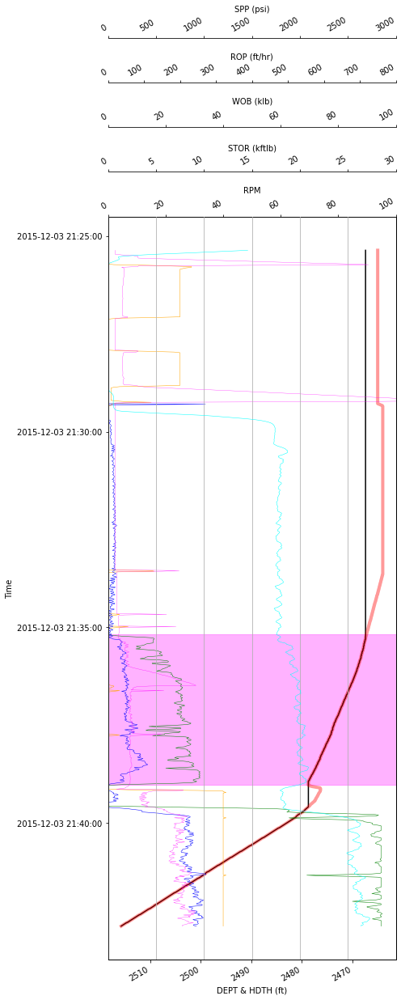

39


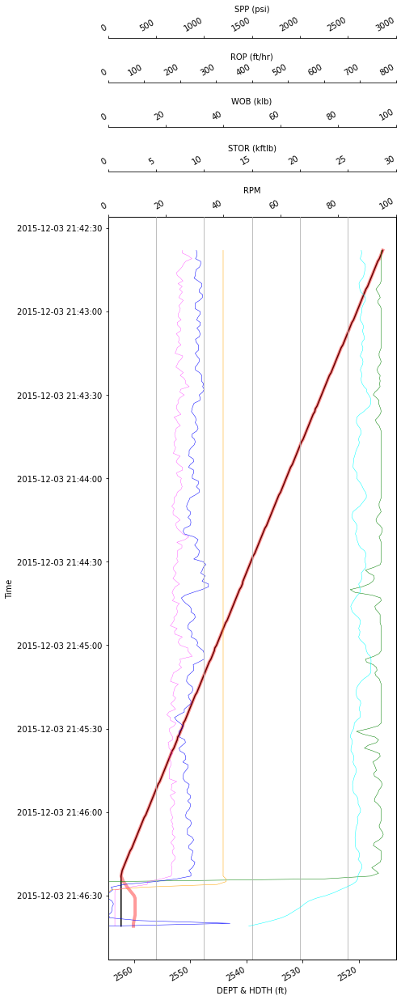

40


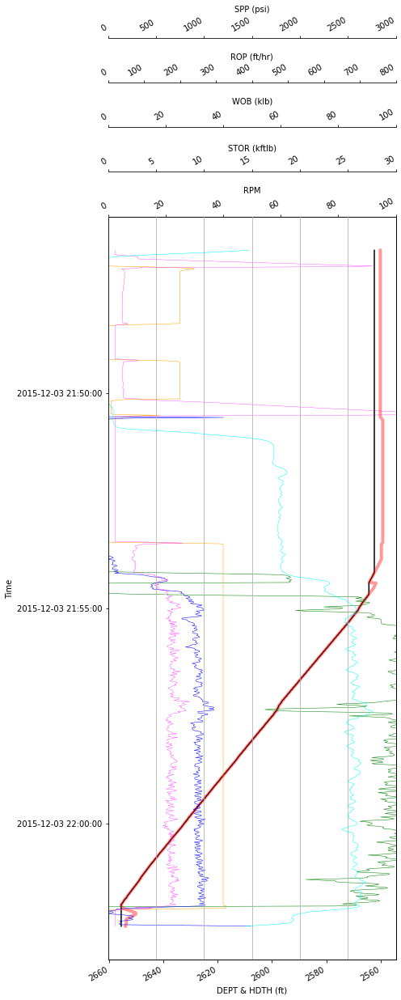

41


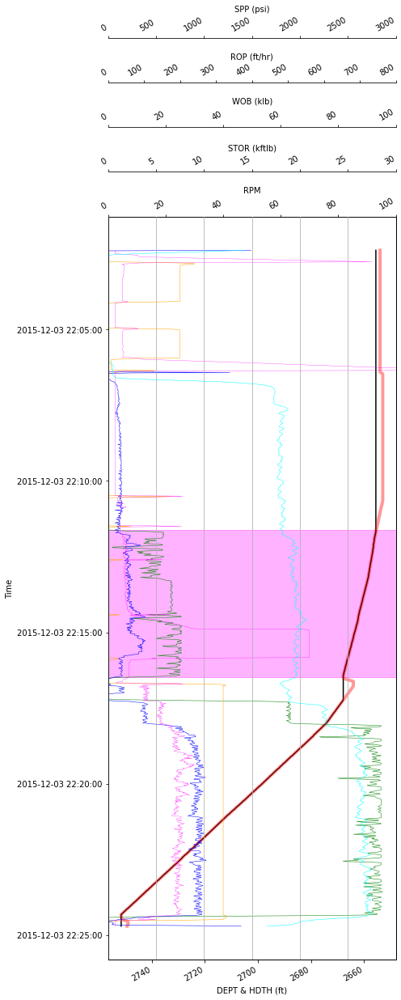

42


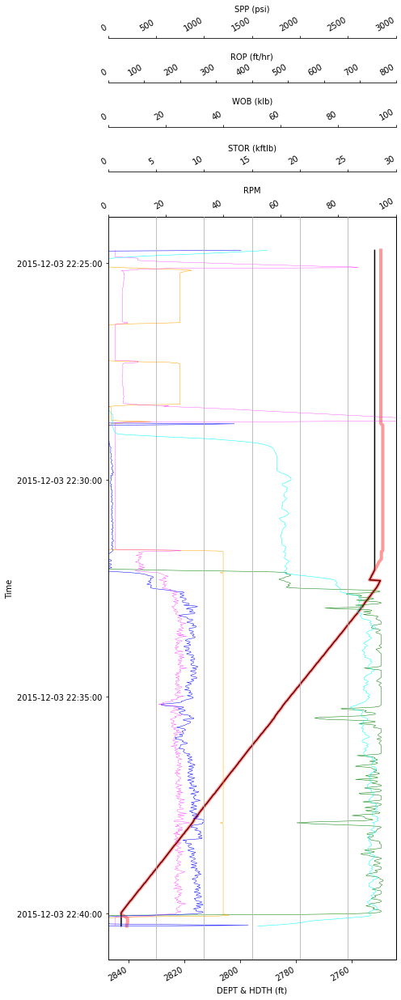

43


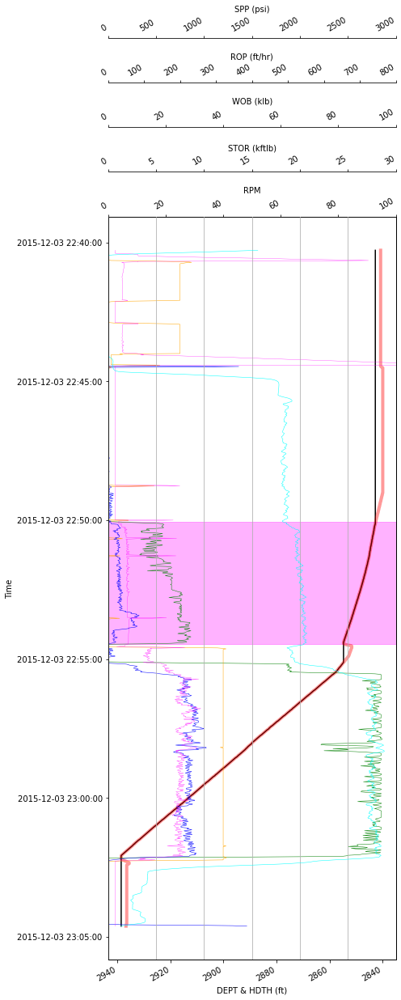

44


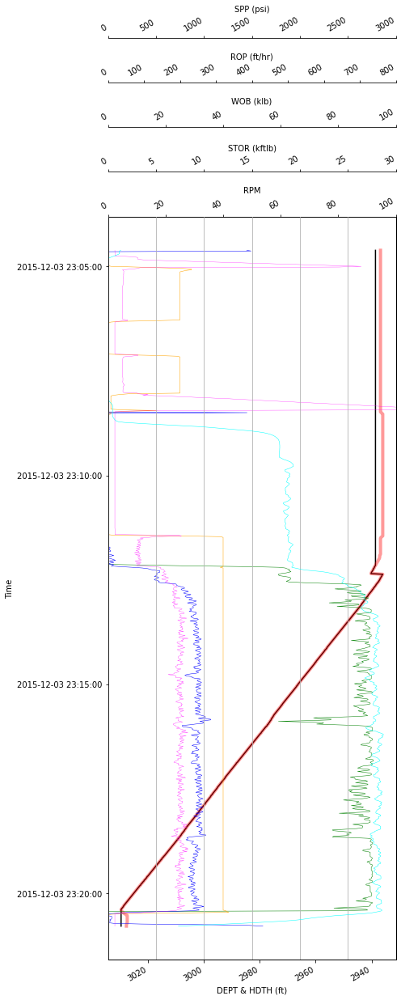

45


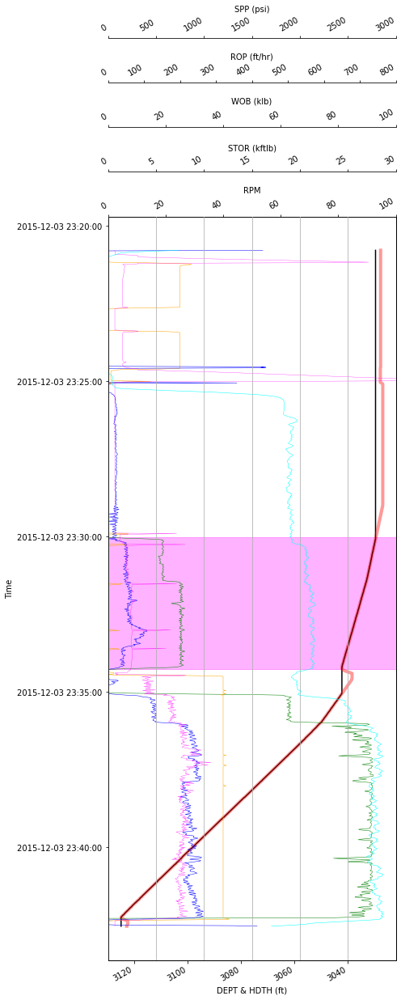

46


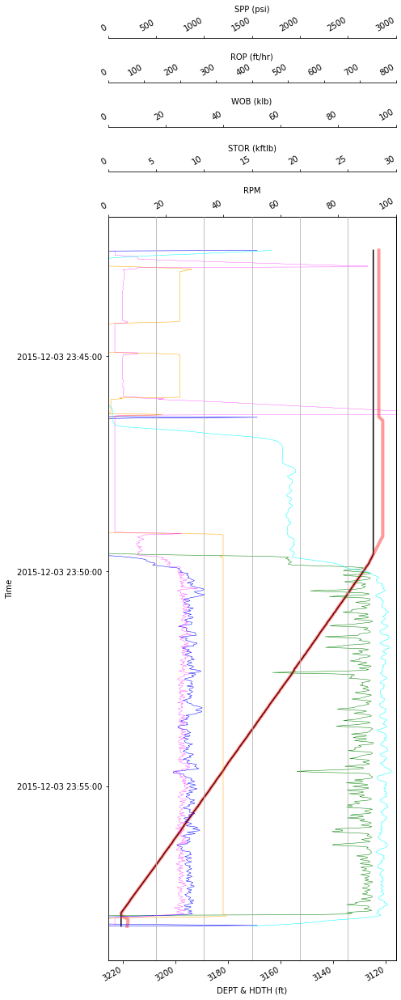

47


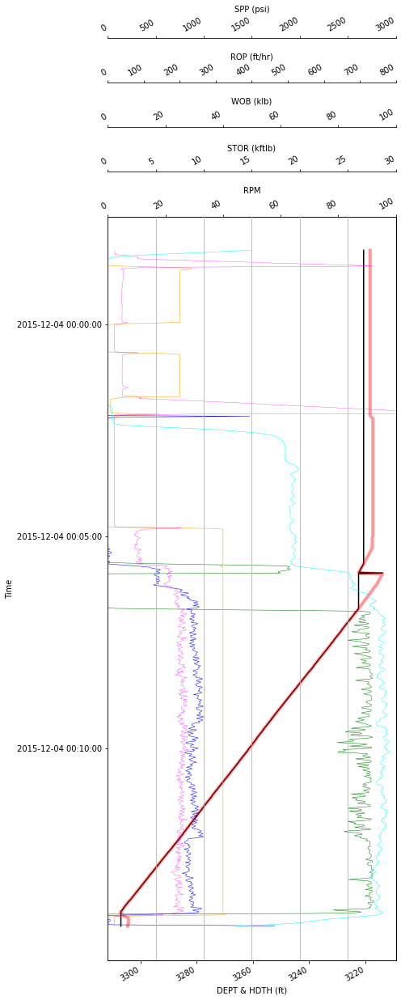

48


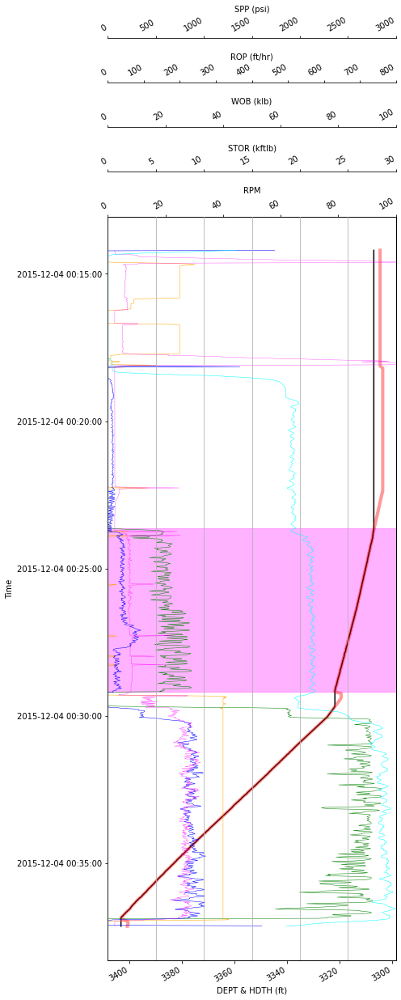

49


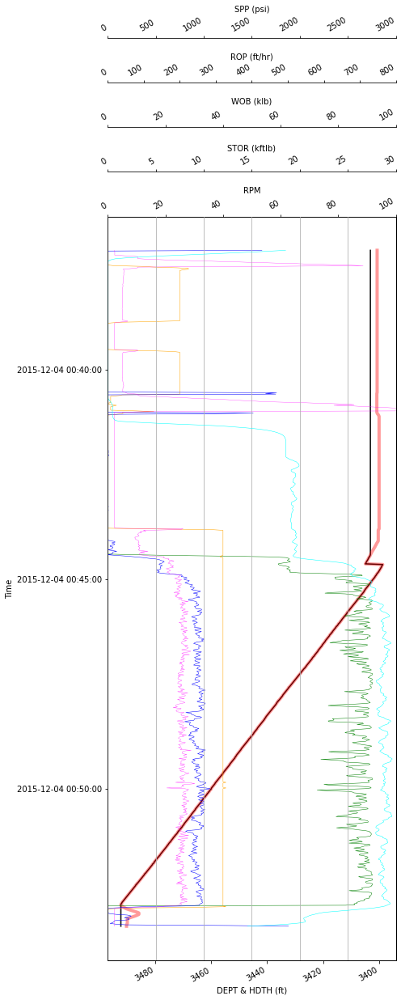

50


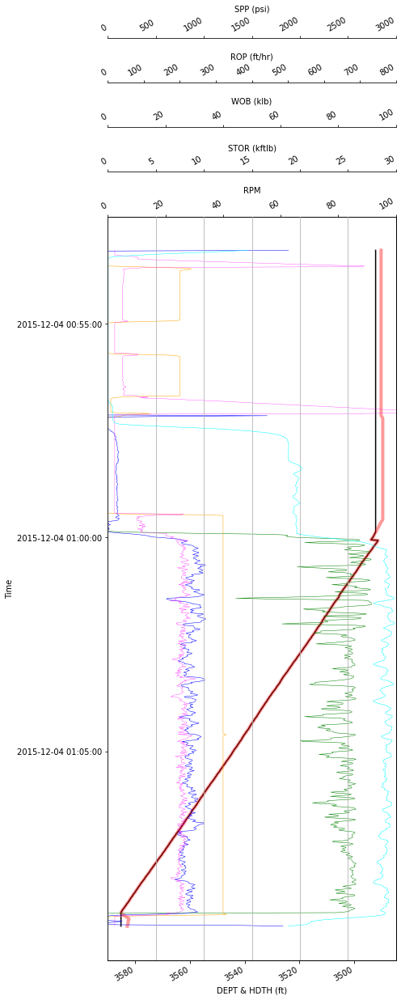

51


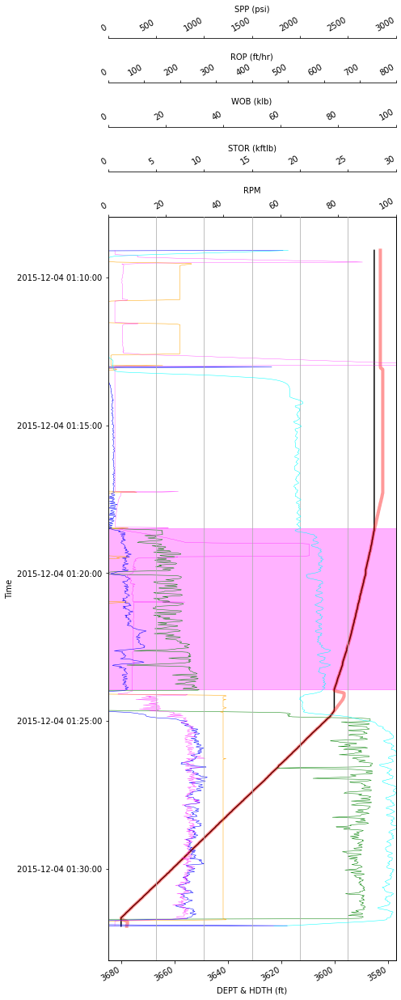

52


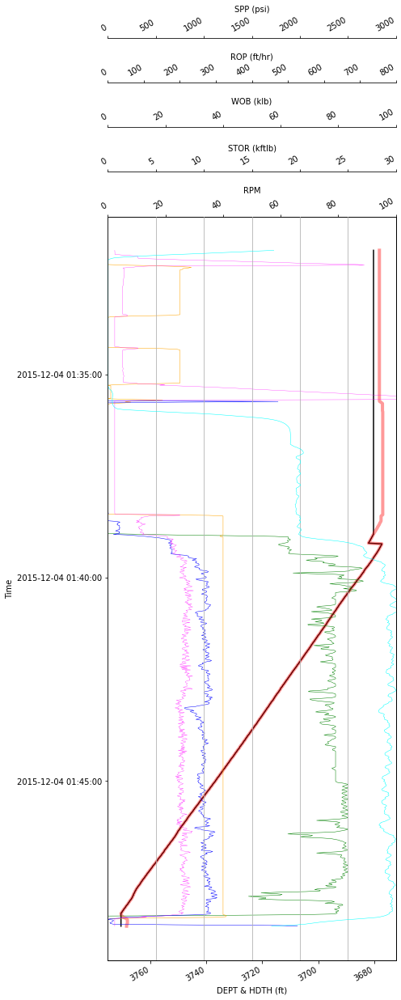

53


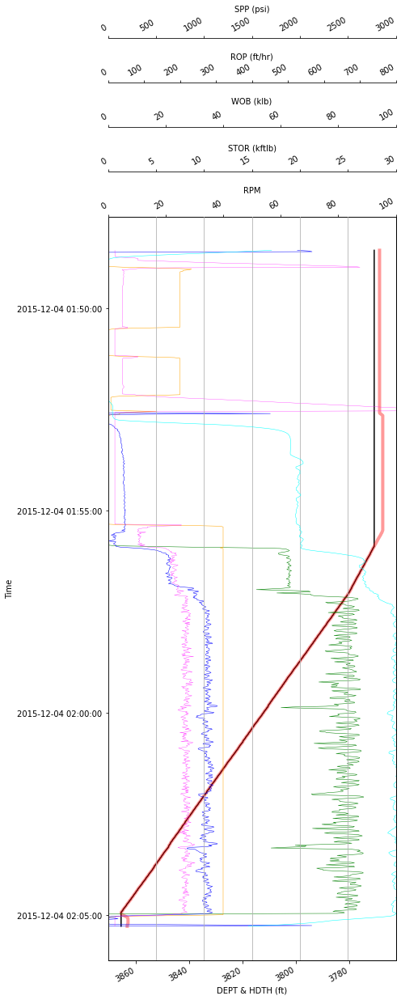

54


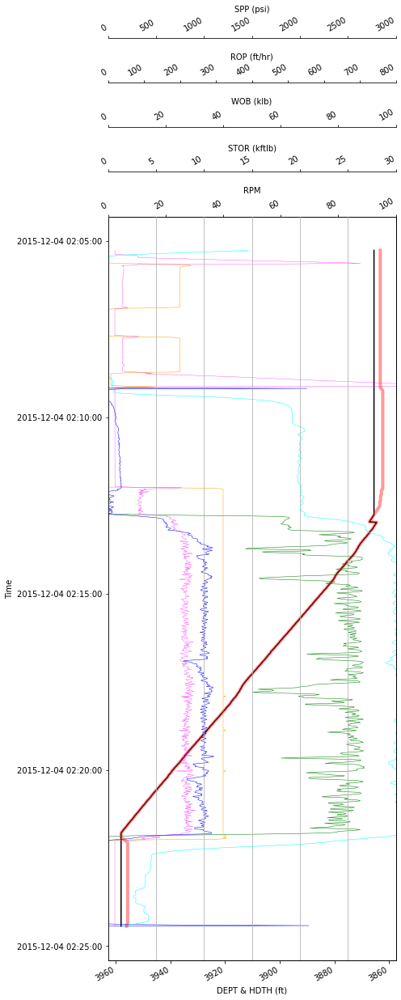

55


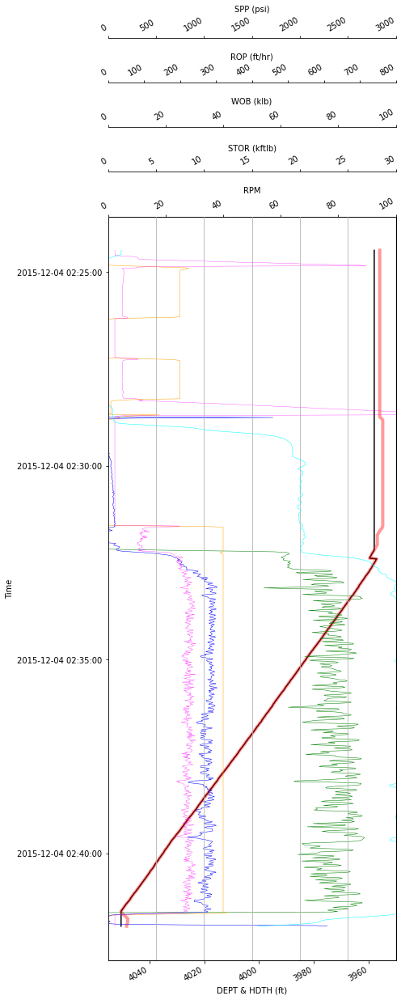

56


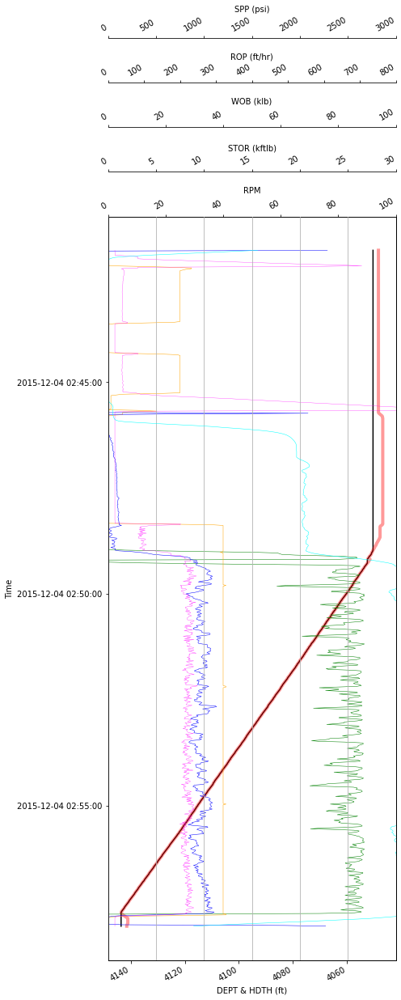

57


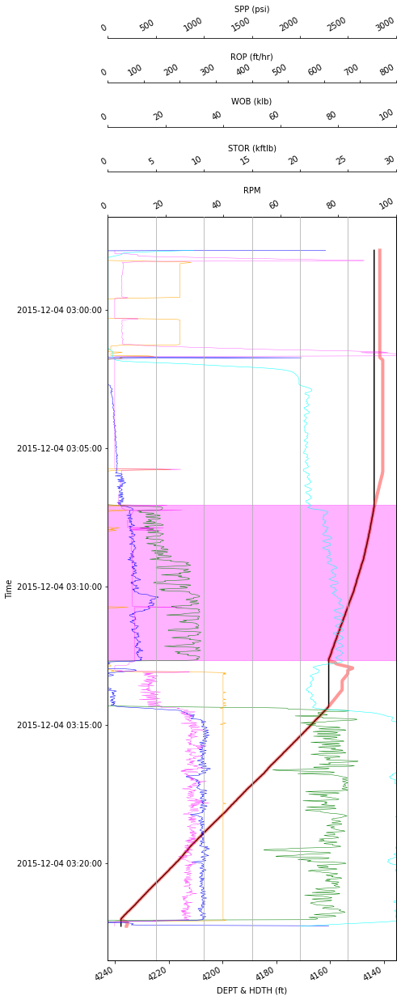

58


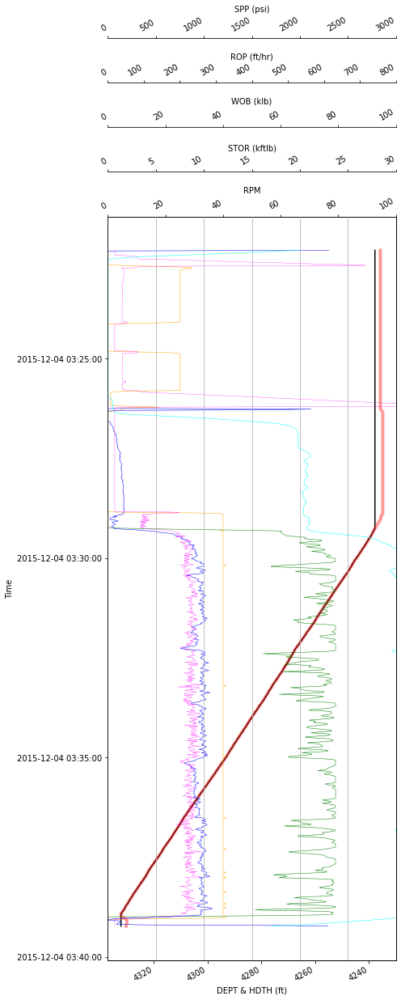

59


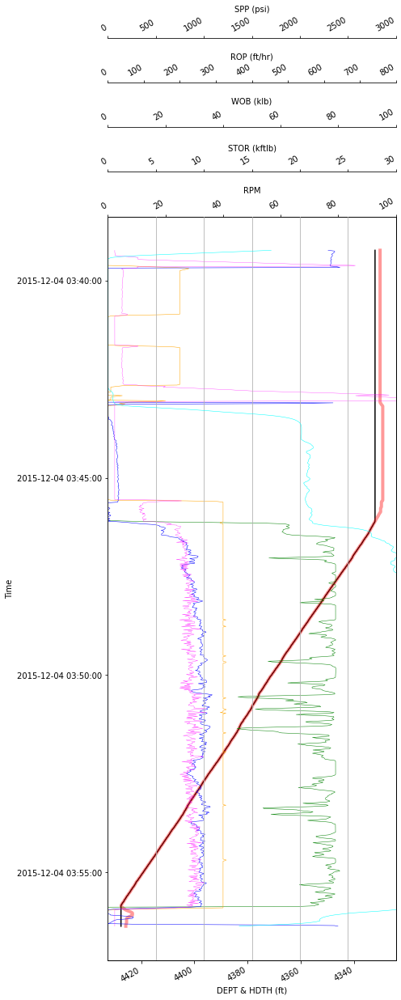

60


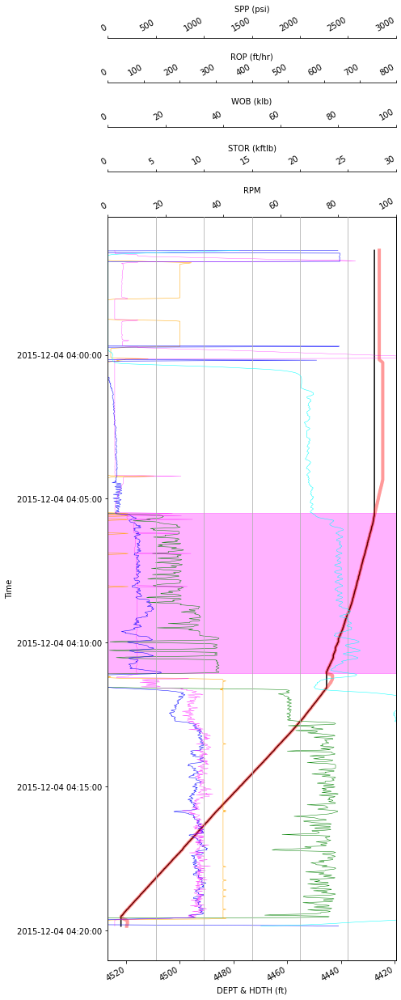

61


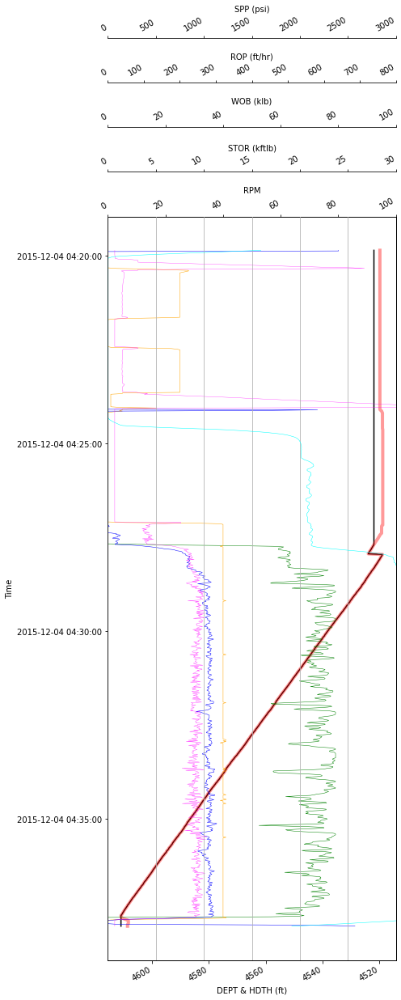

62


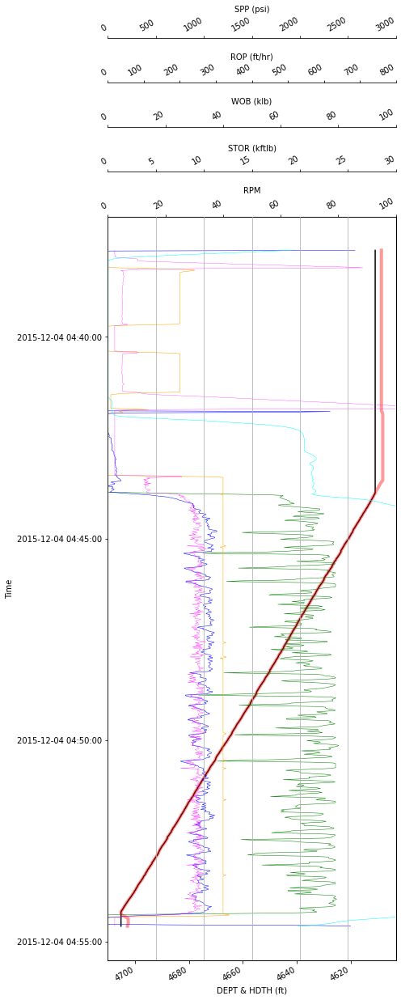

63


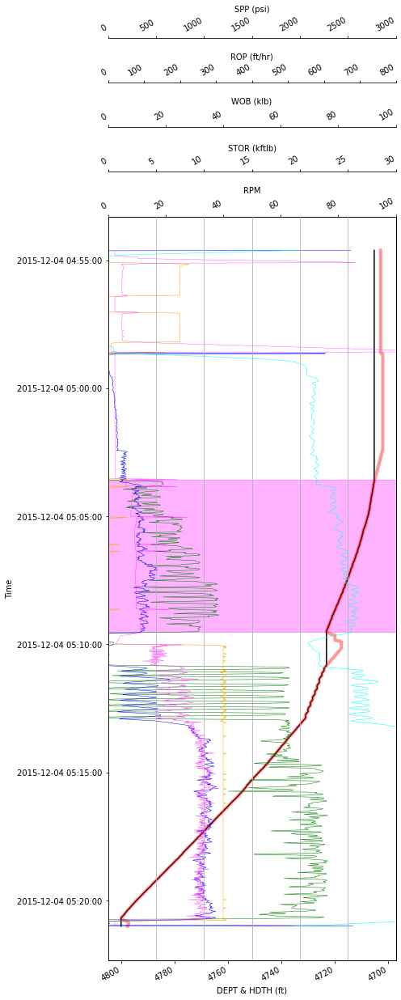

64


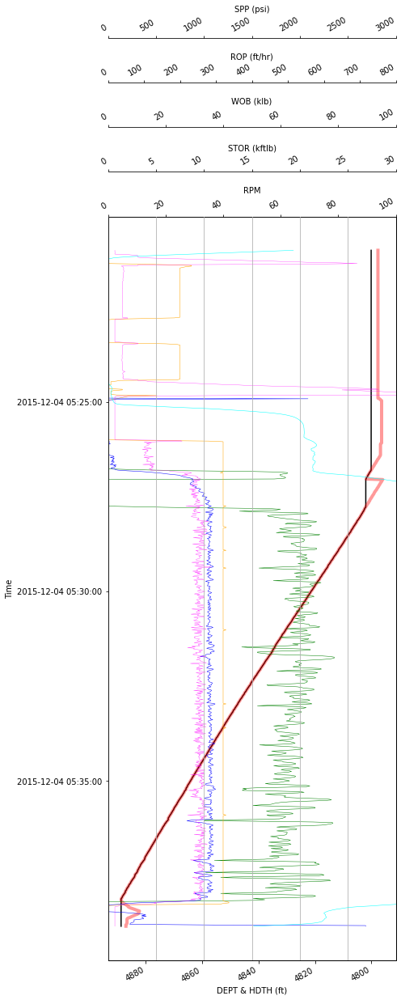

65


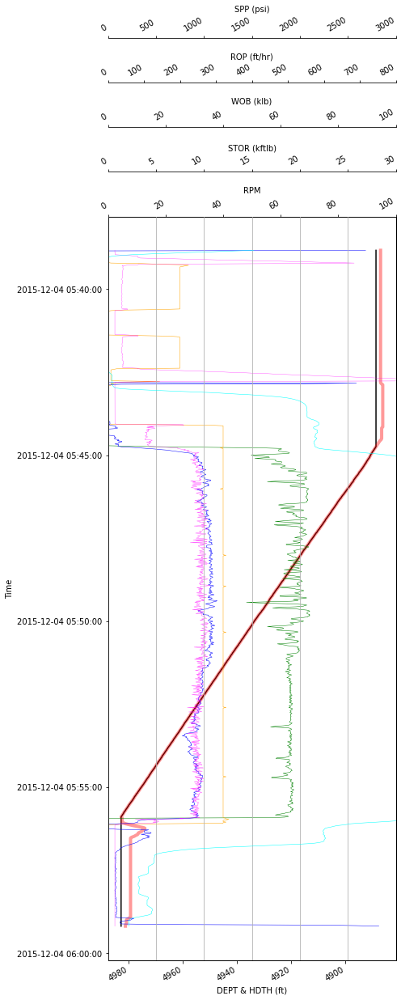

66


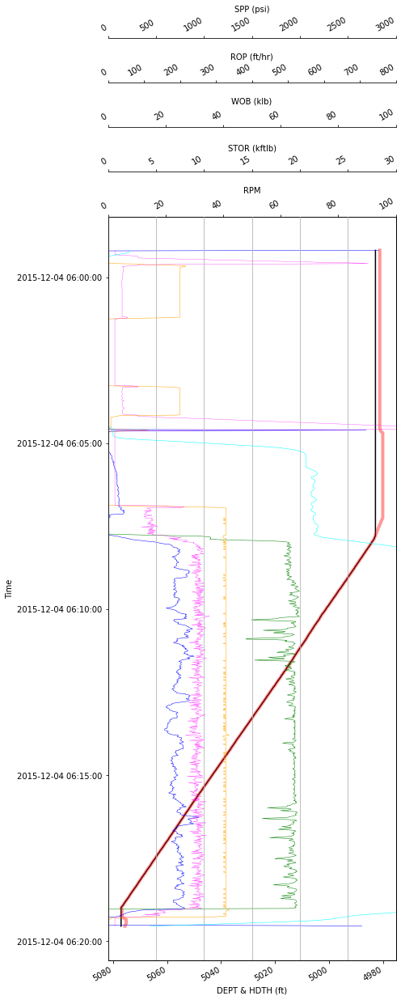

67


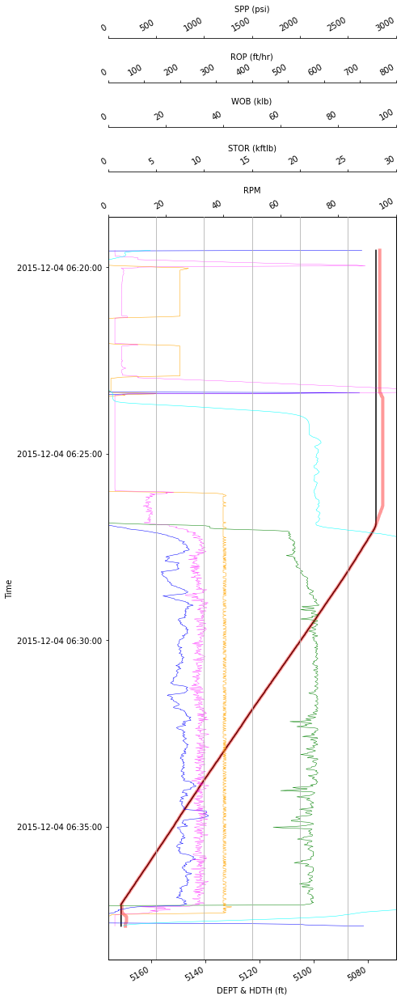

68


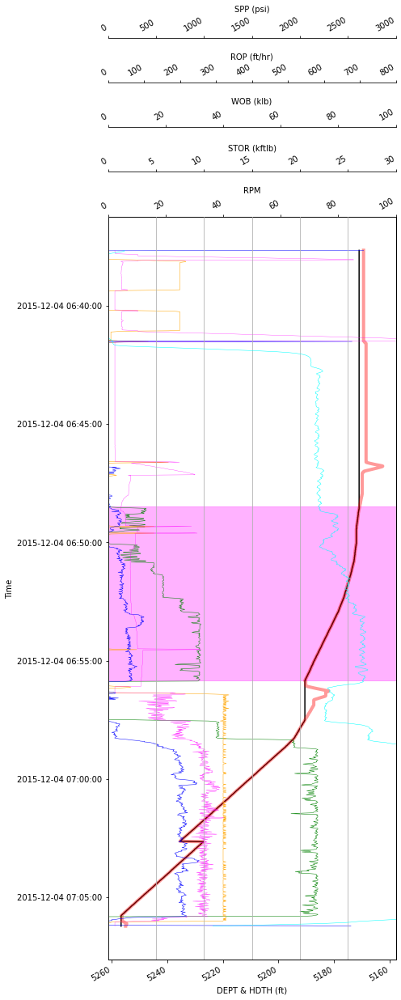

69


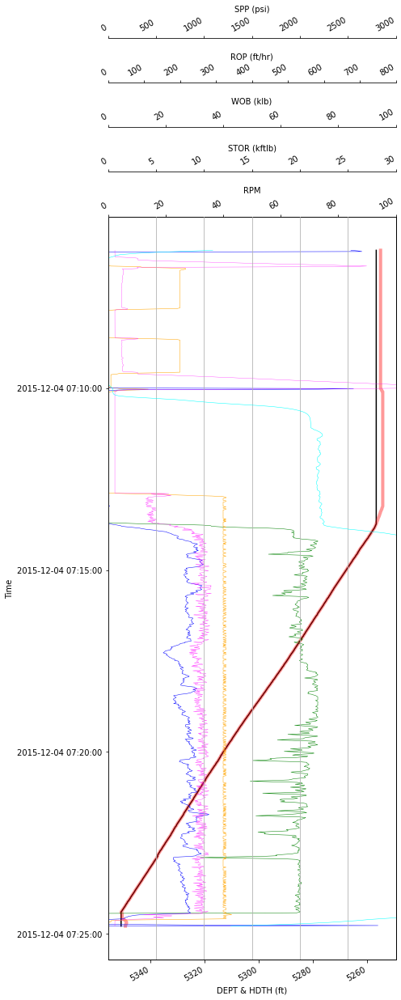

70


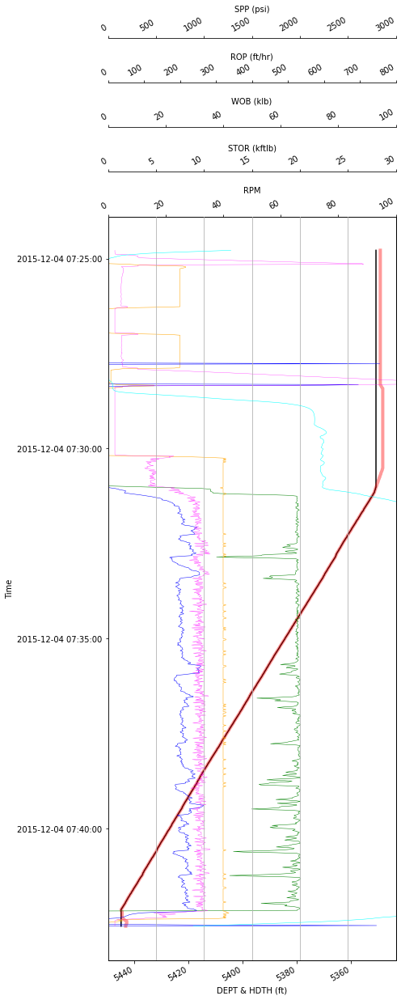

71


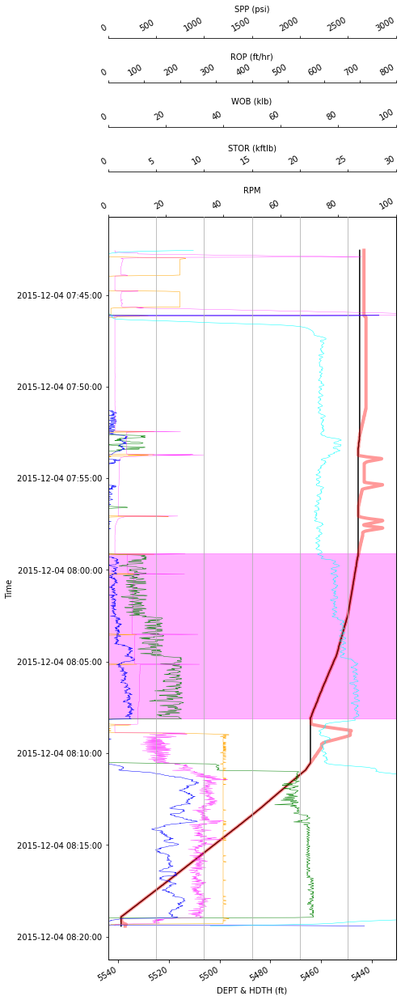

72


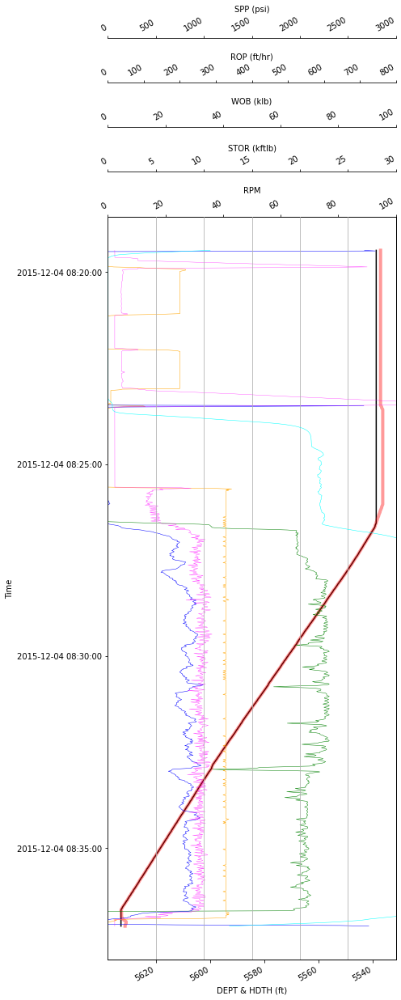

73


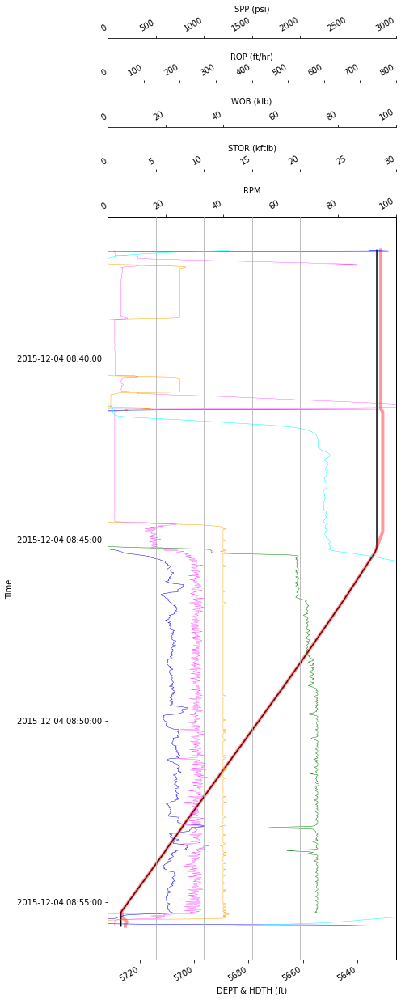

74


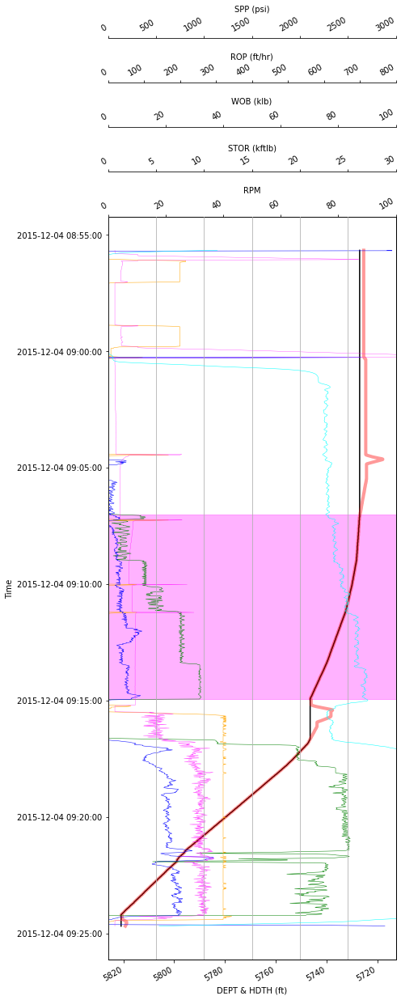

75


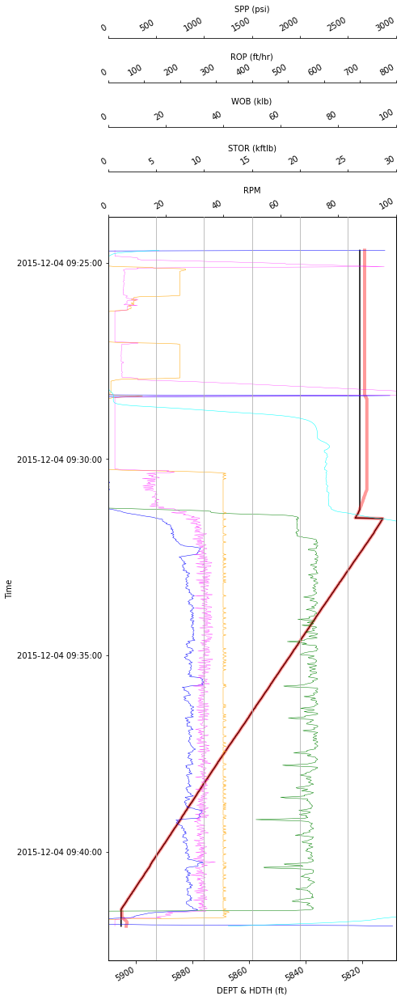

76


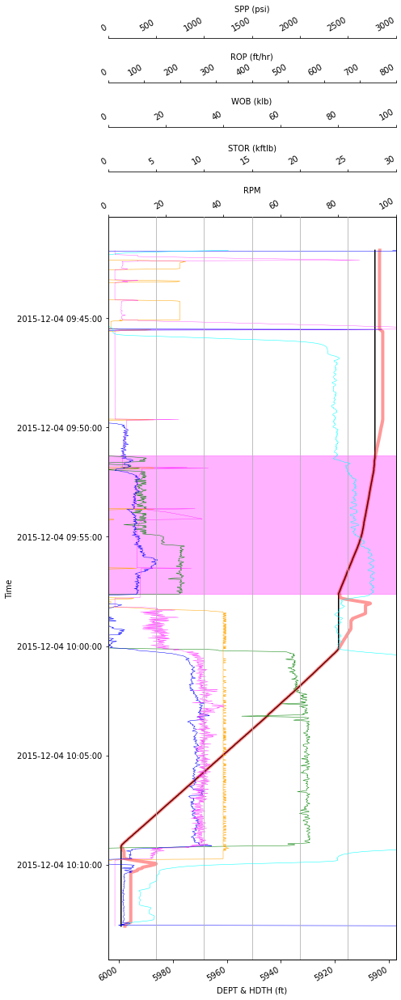

77


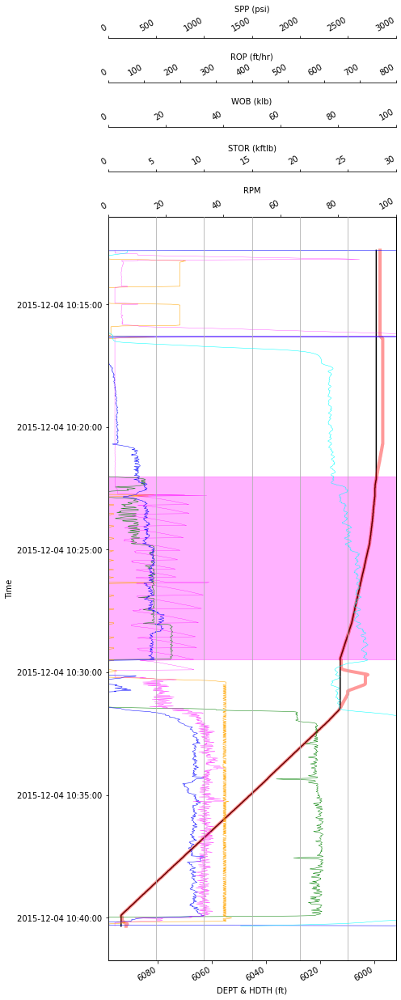

78


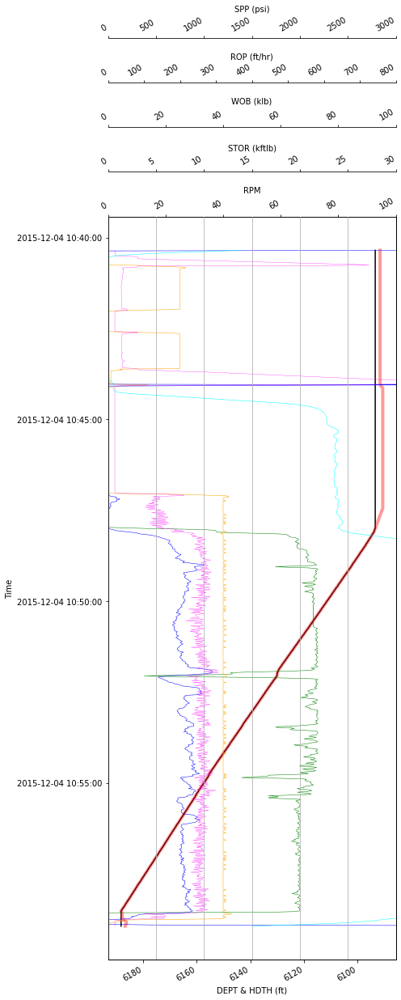

79


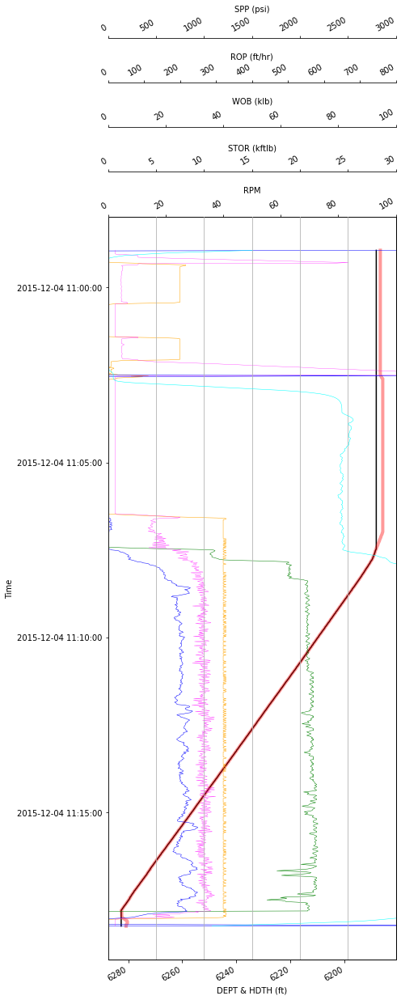

80


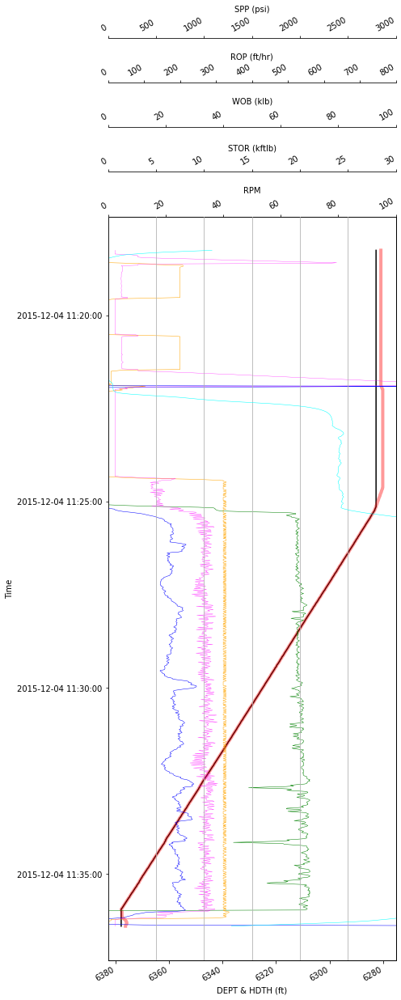

81


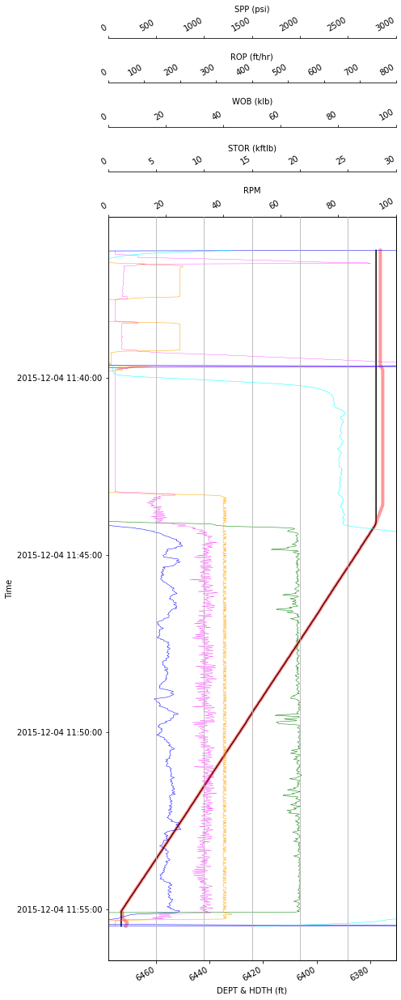

82


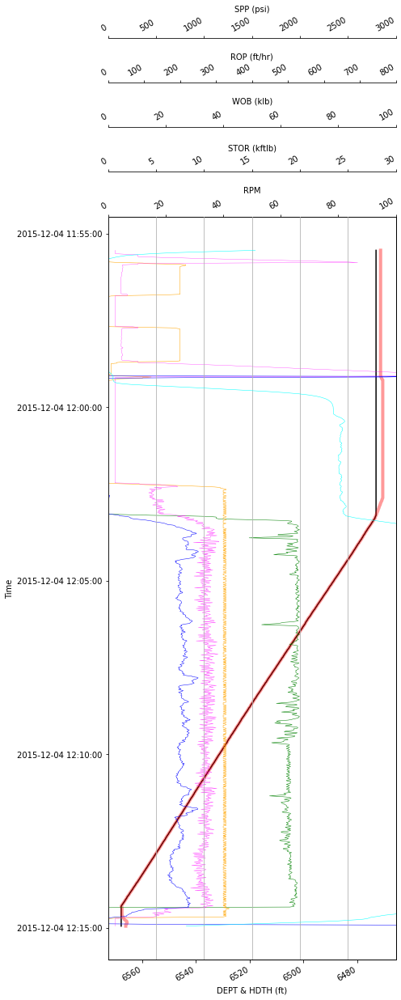

83


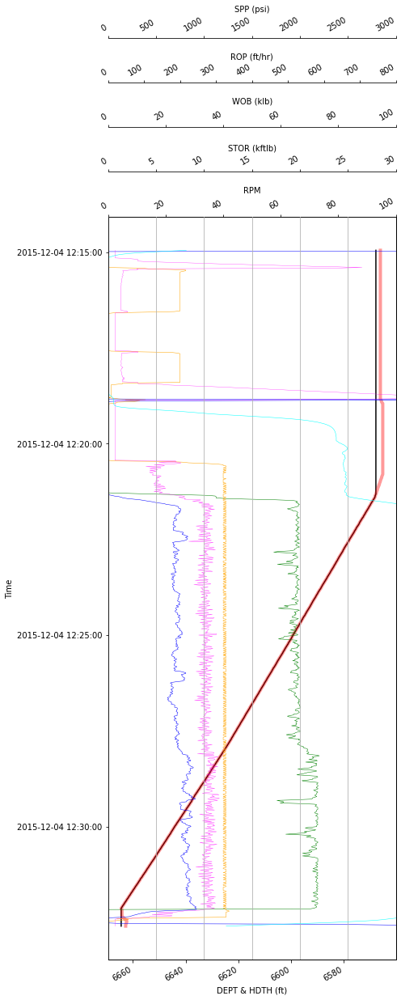

84


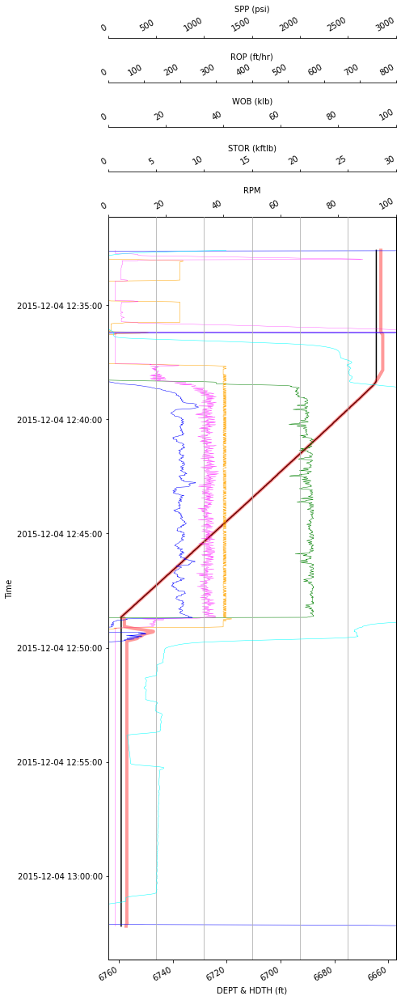

85


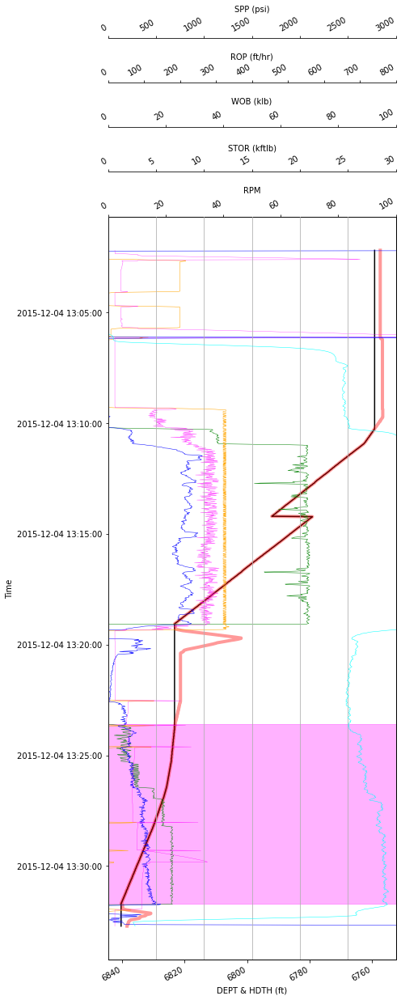

86


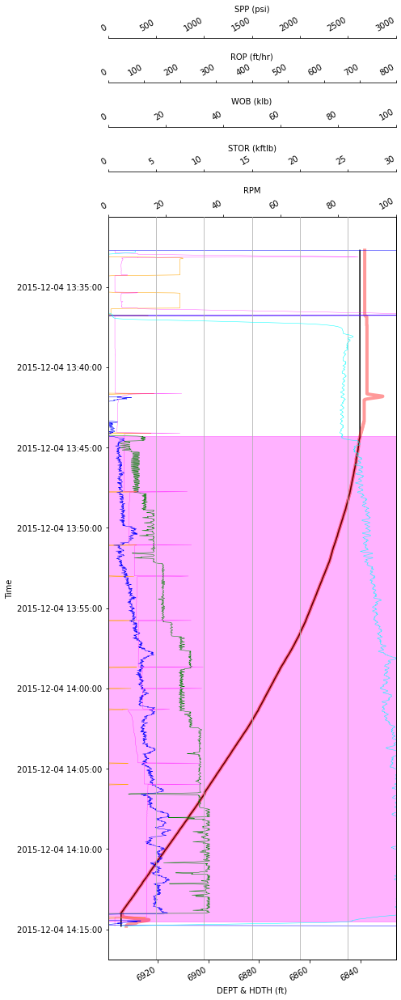

87


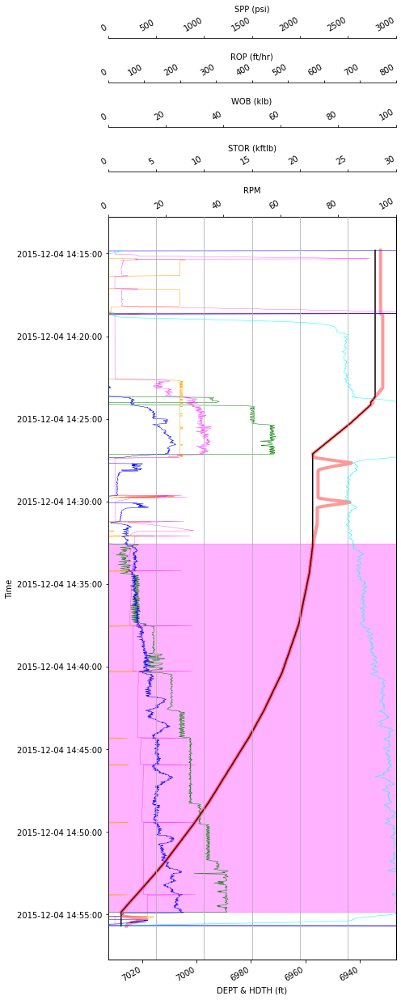

88


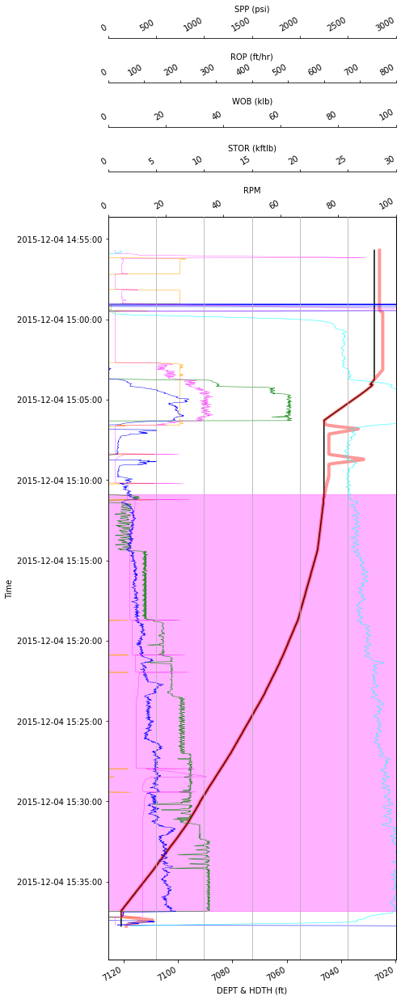

89


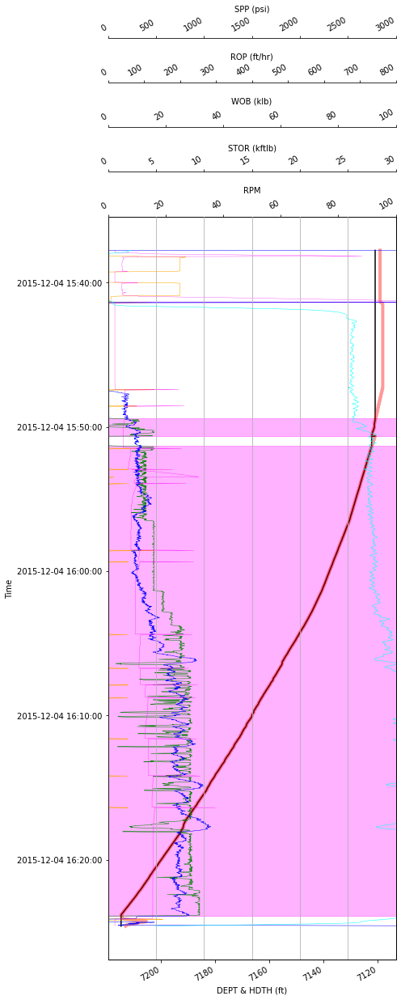

90


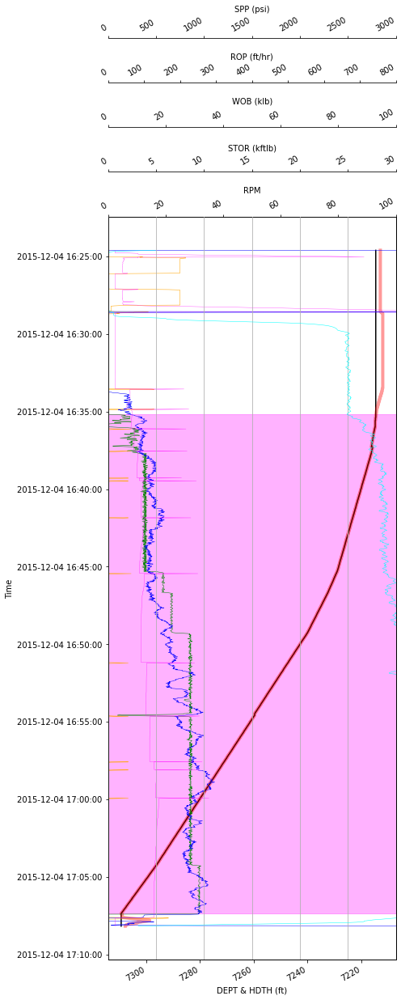

91


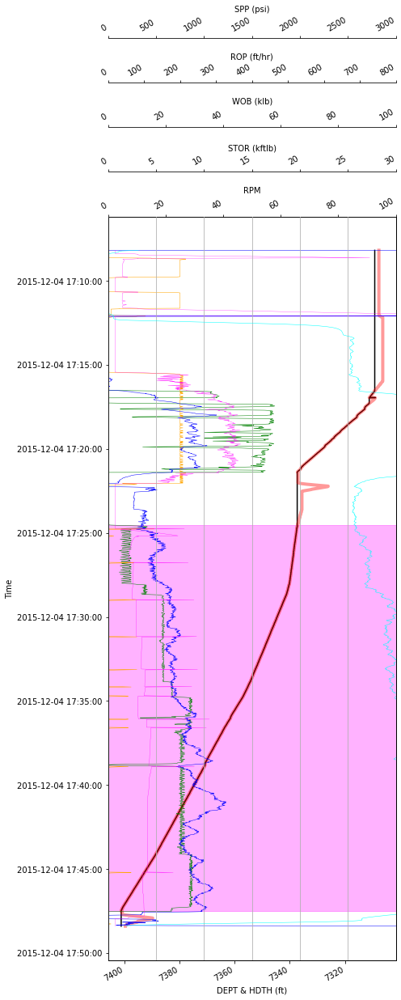

92


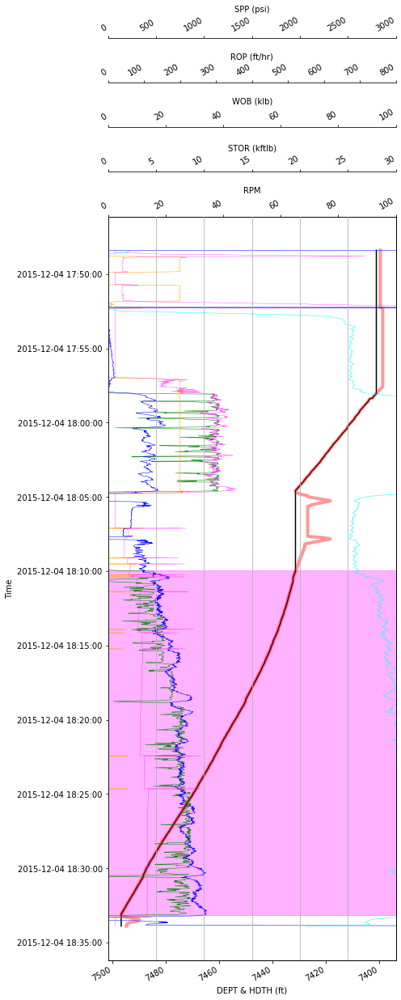

93


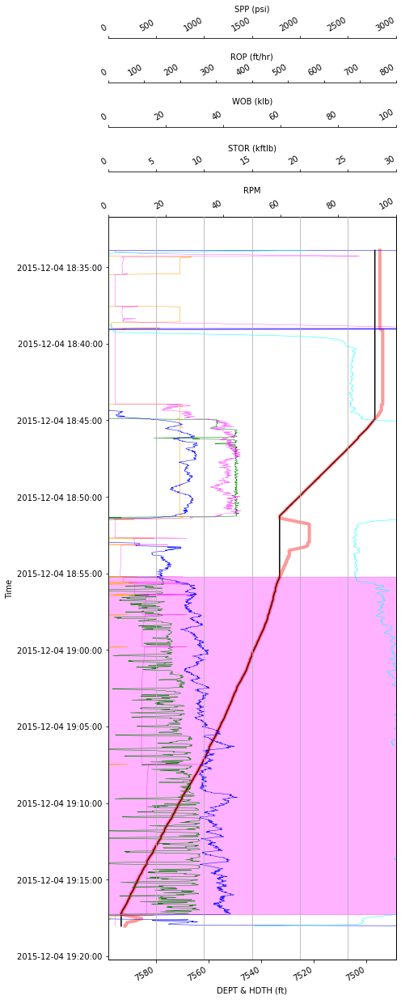

94


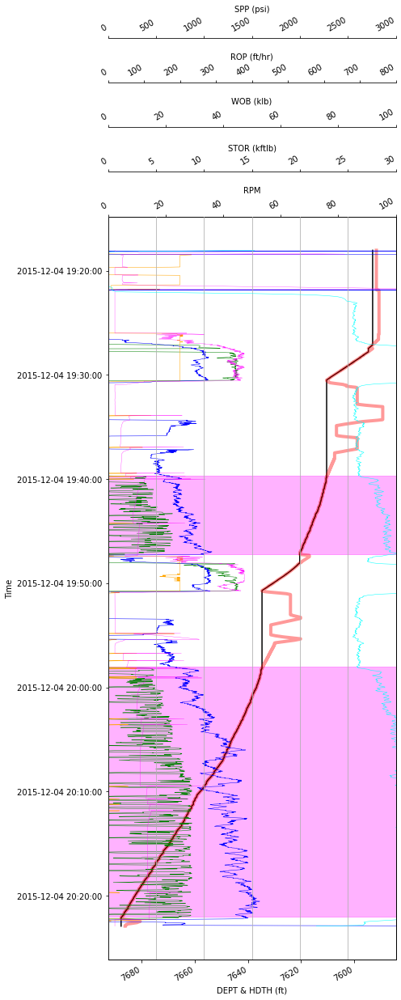

95


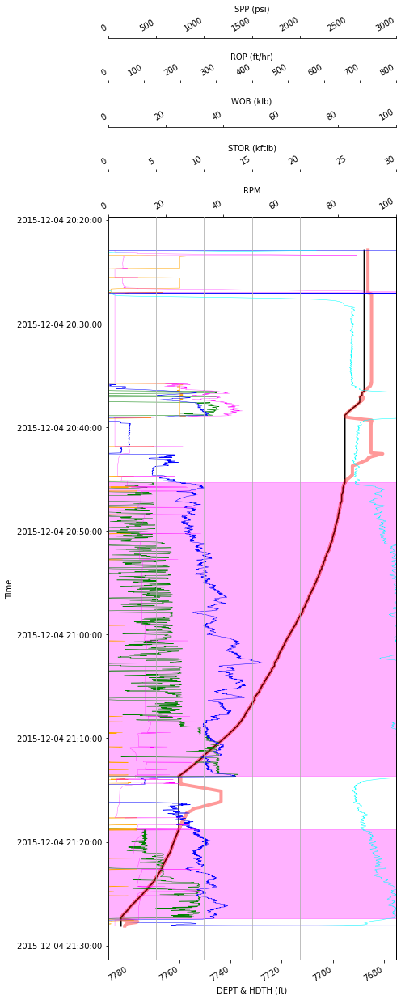

96


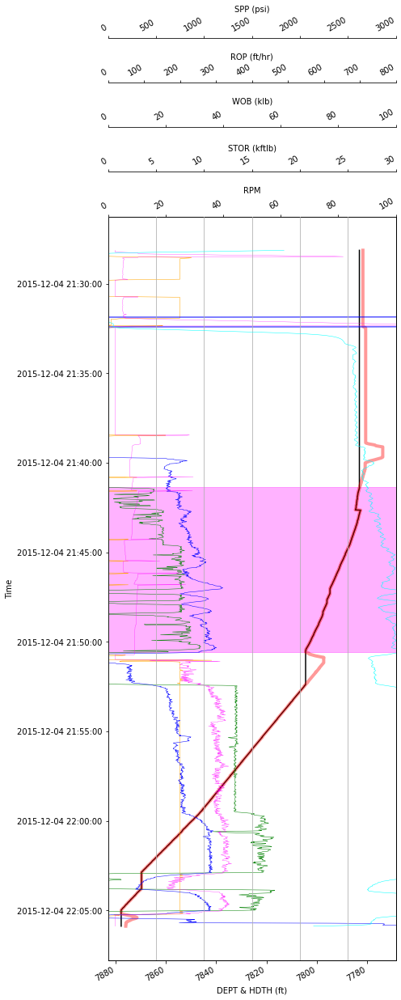

97


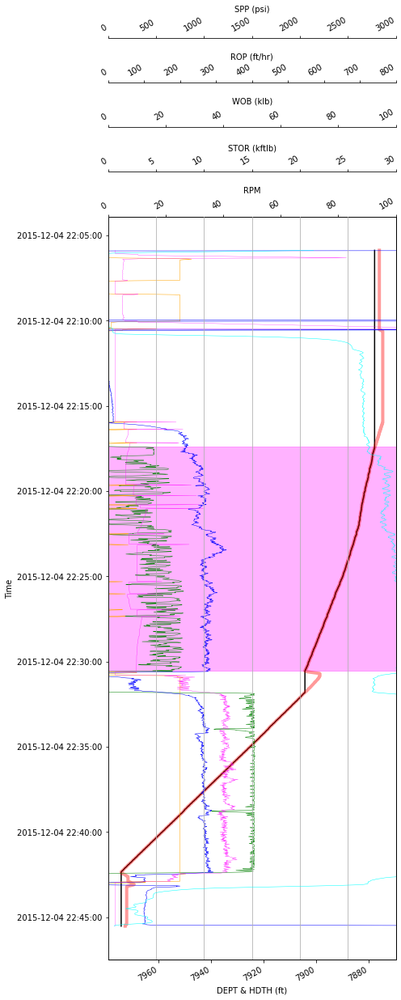

98


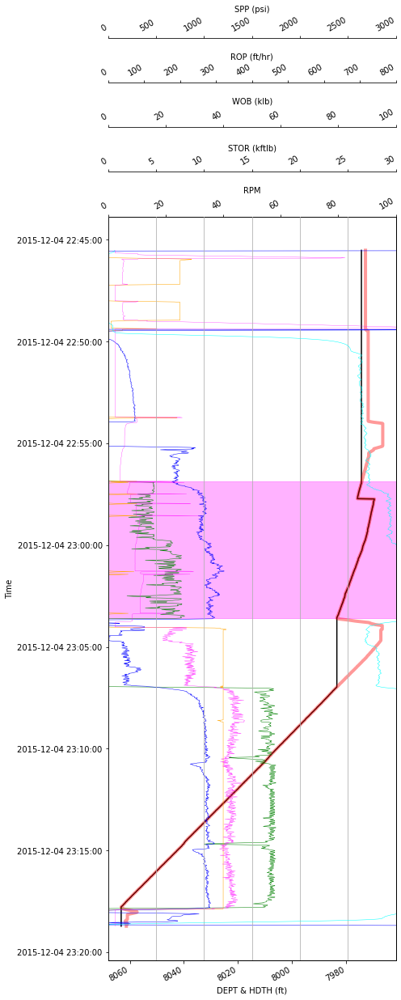

99


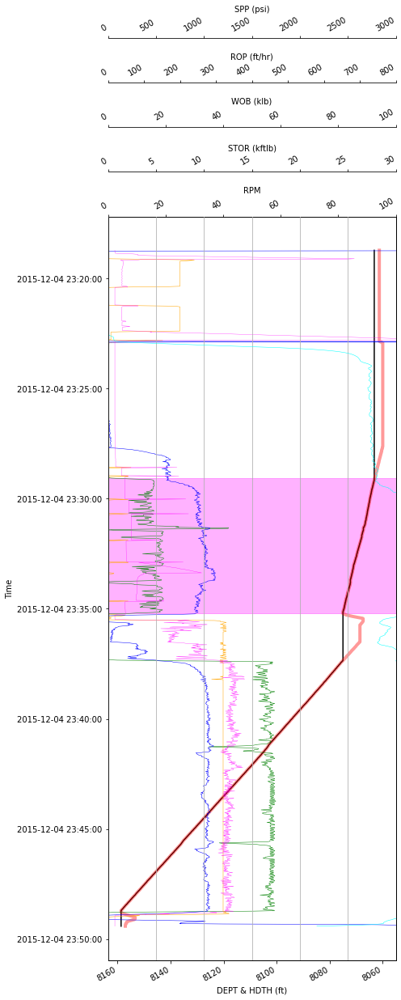

100


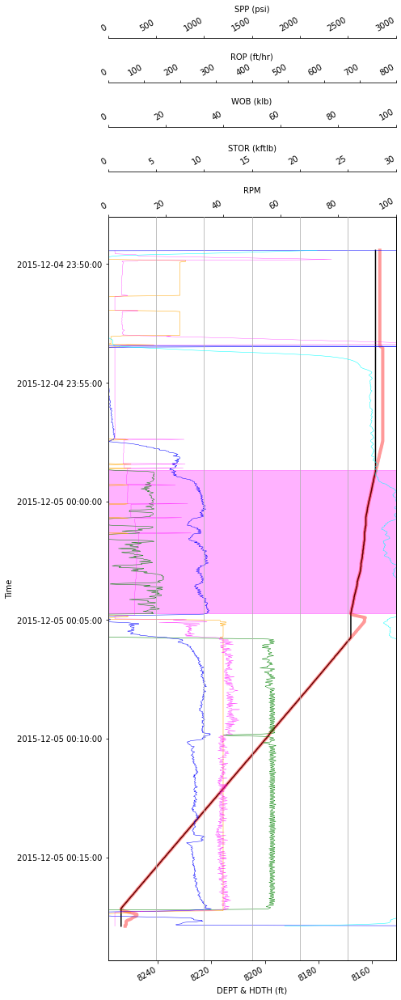

101


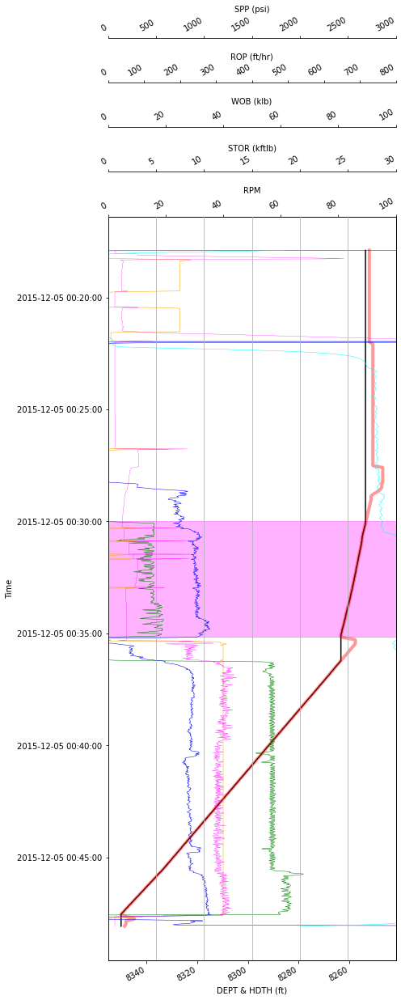

102


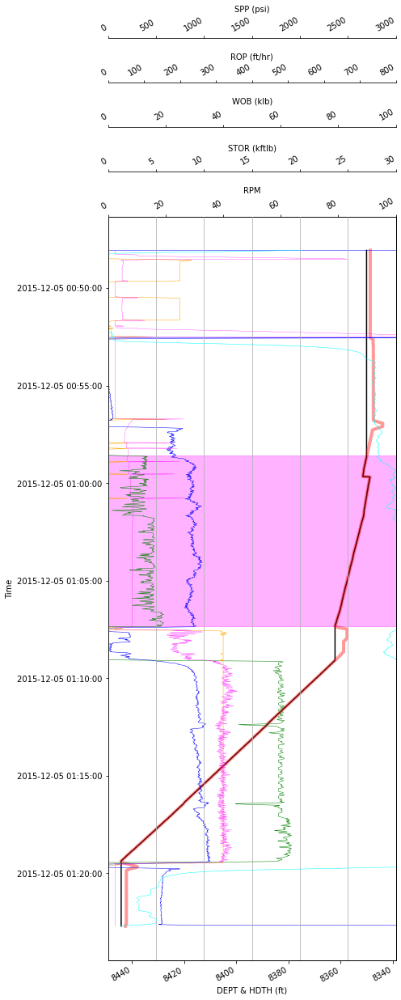

103


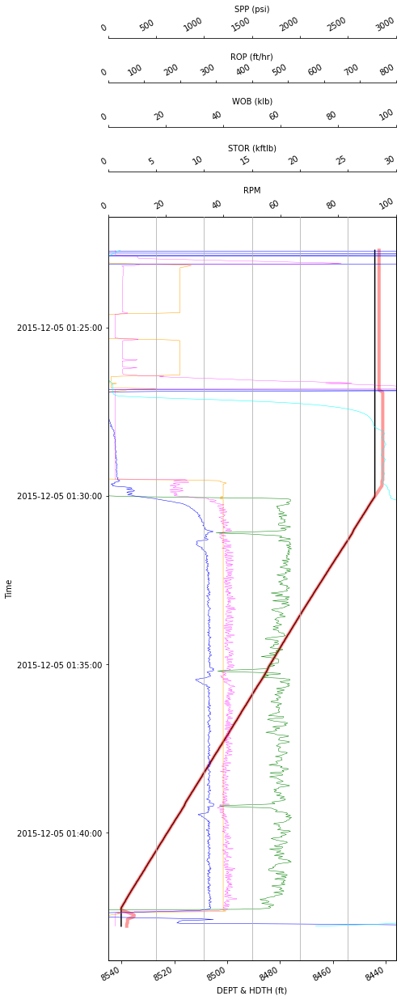

104


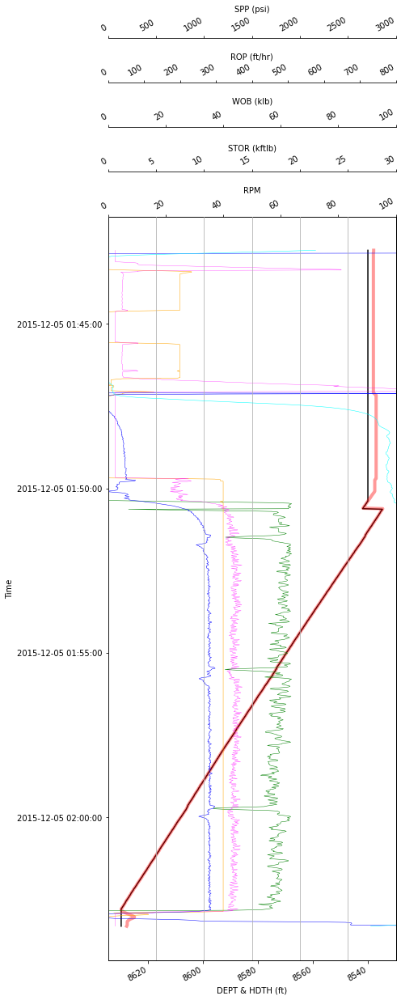

105


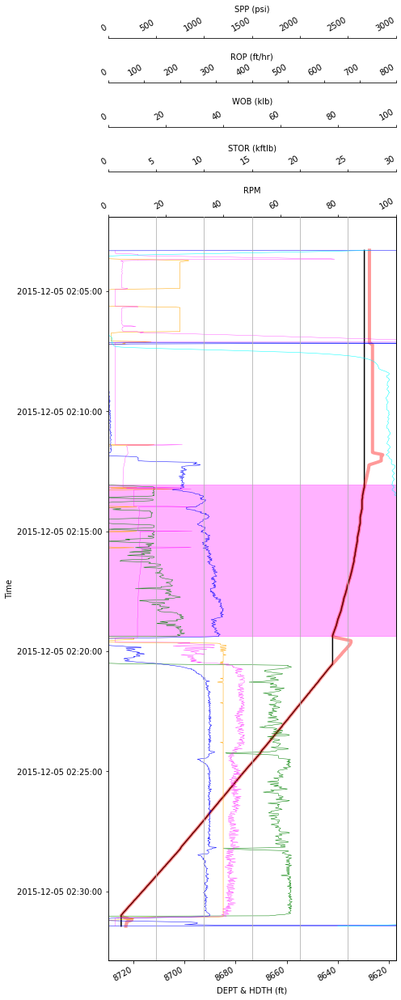

106


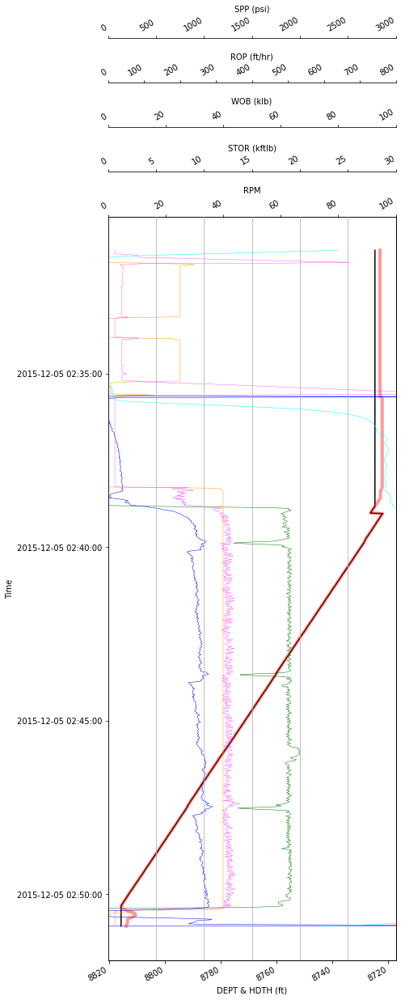

107


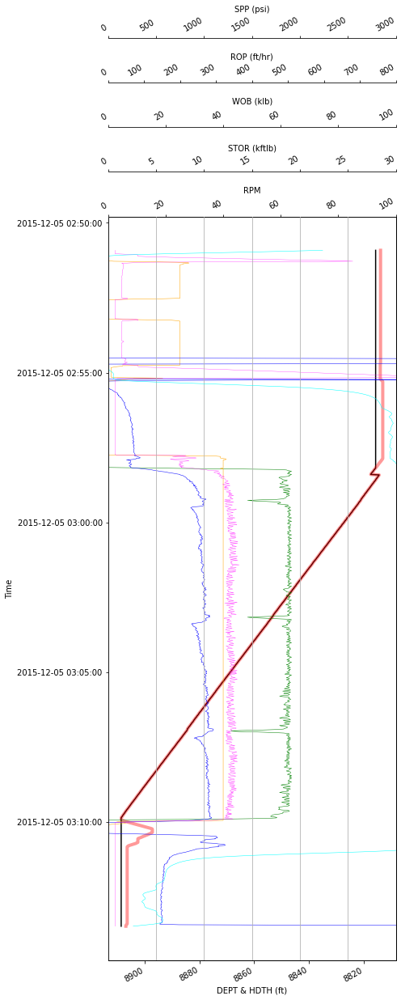

108


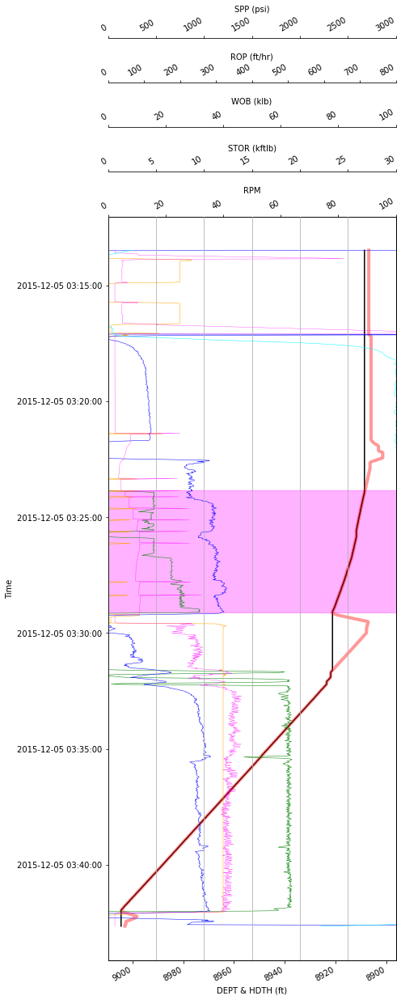

109


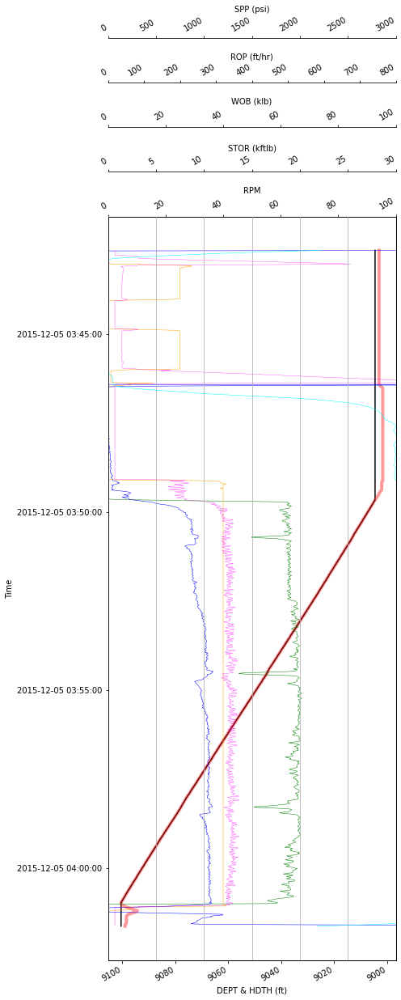

110


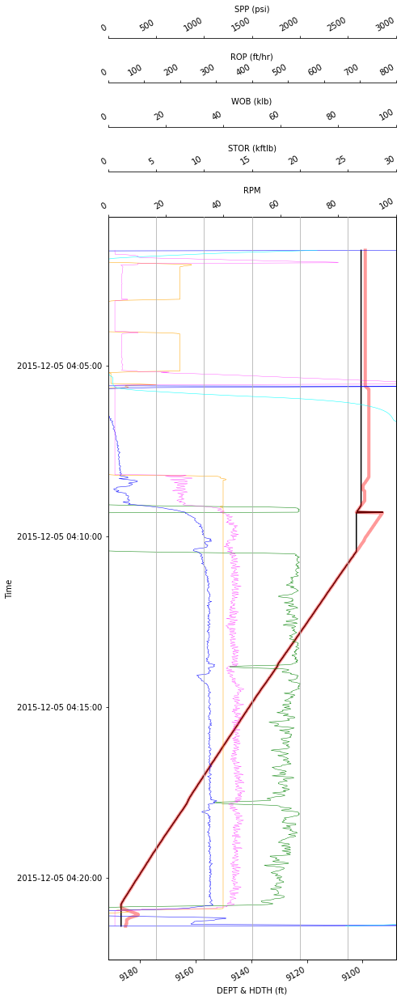

111


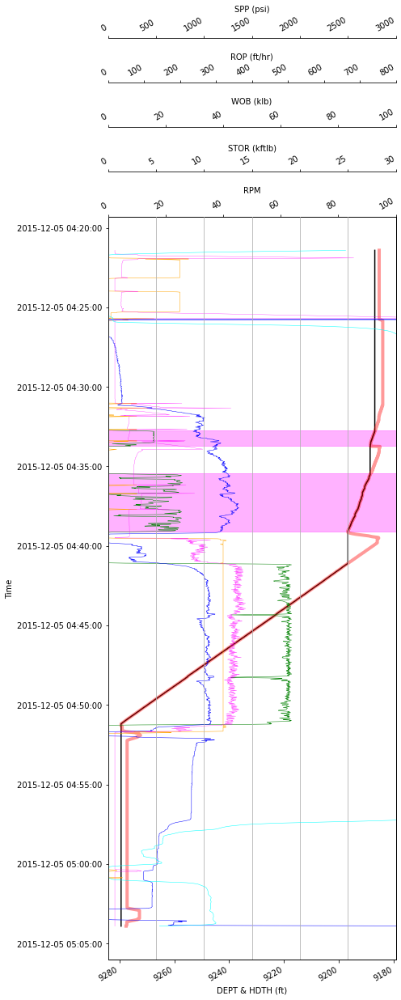

112


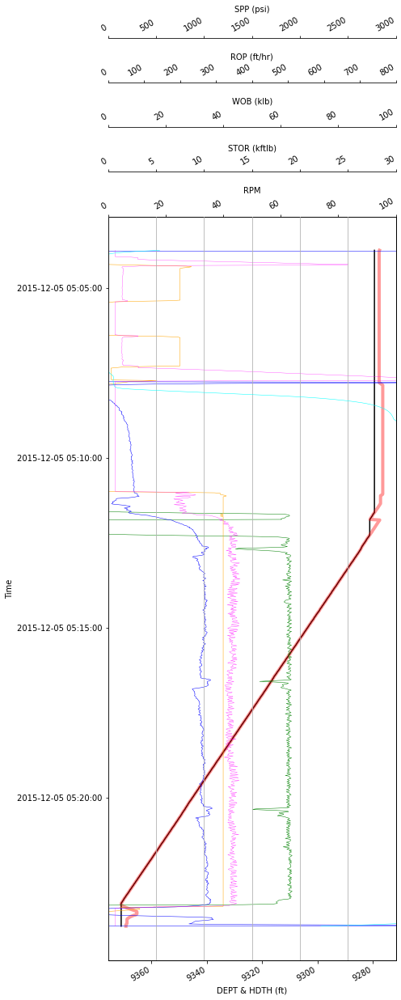

113


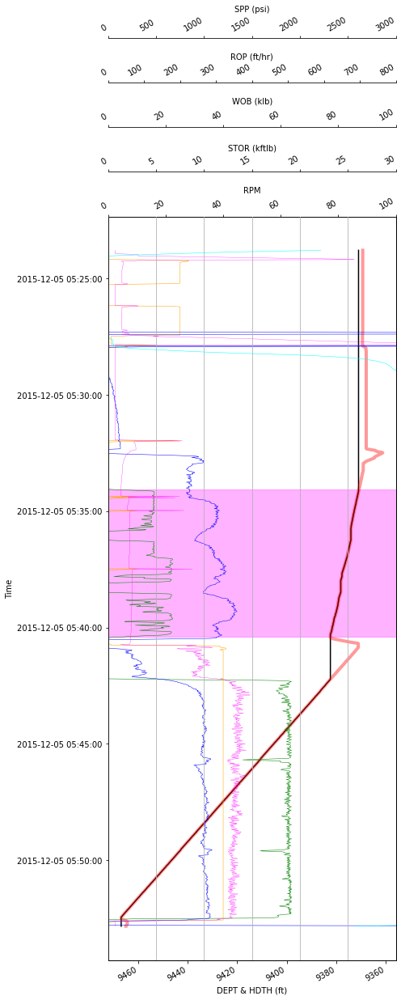

114


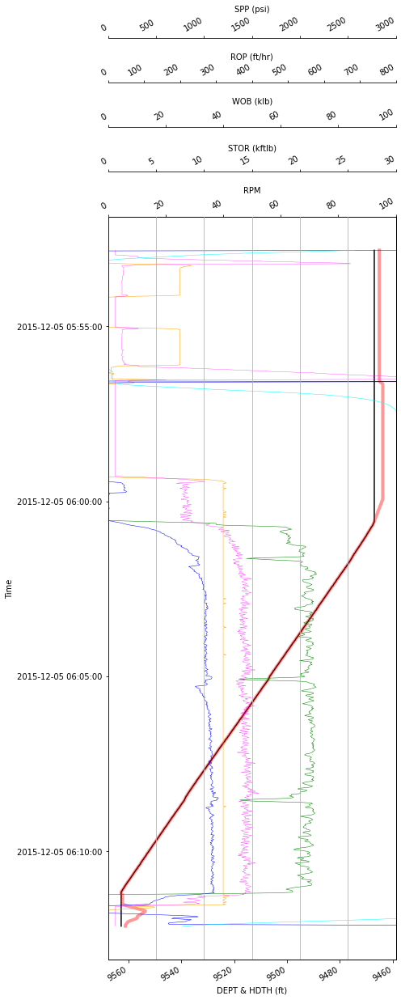

115


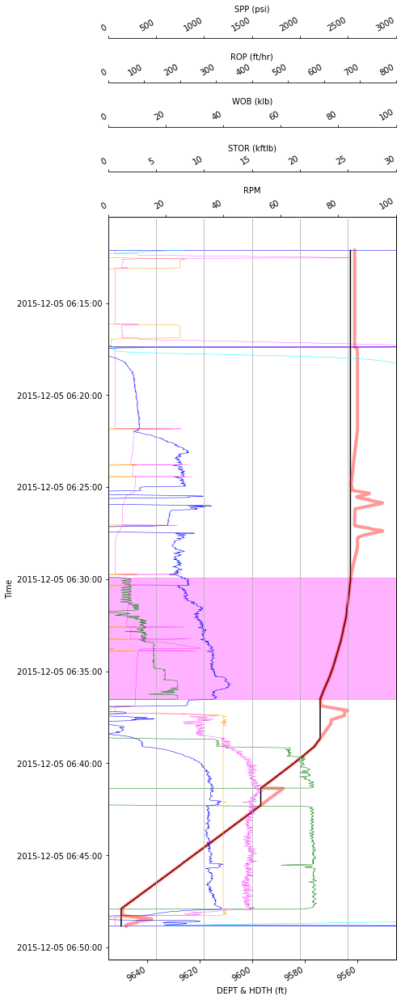

116


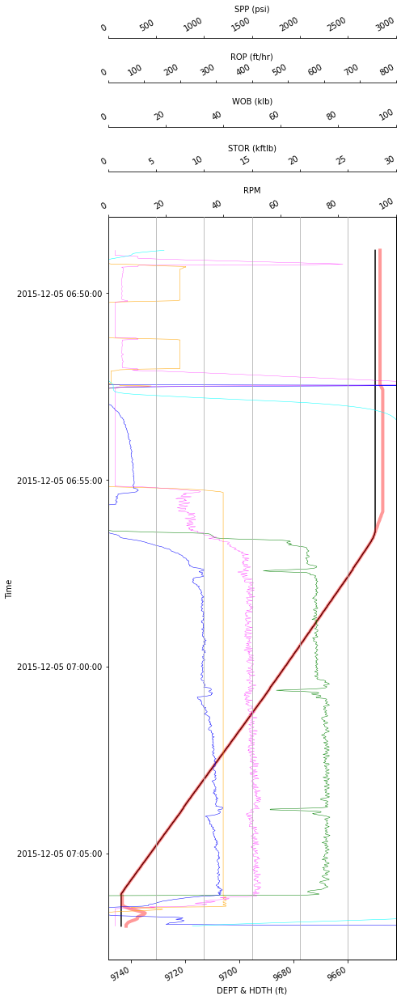

117


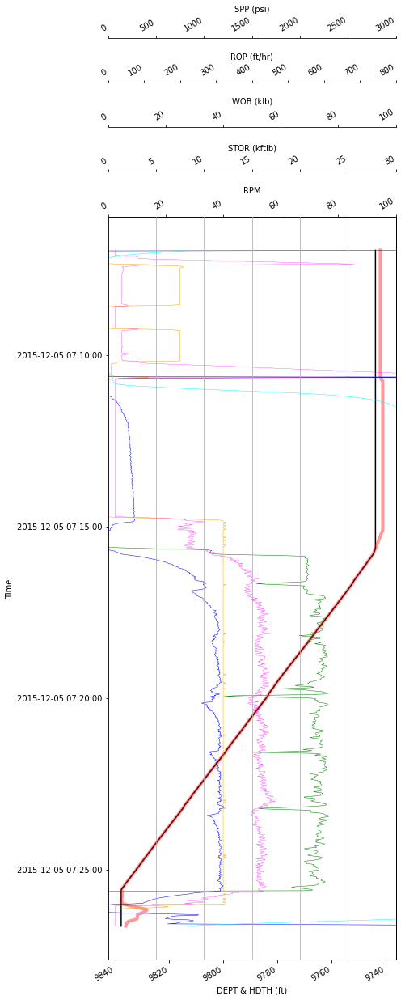

118


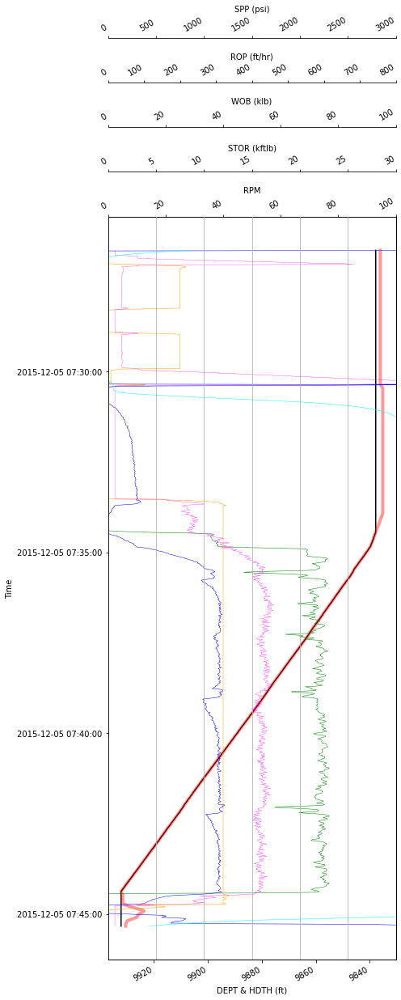

119


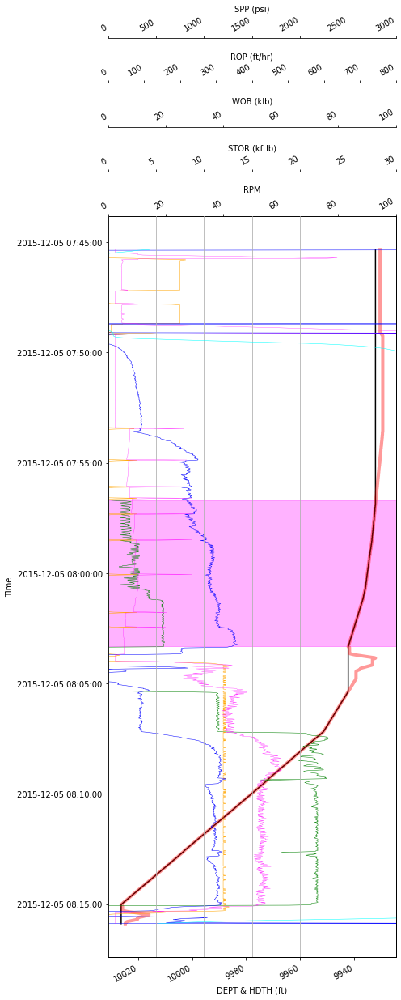

120


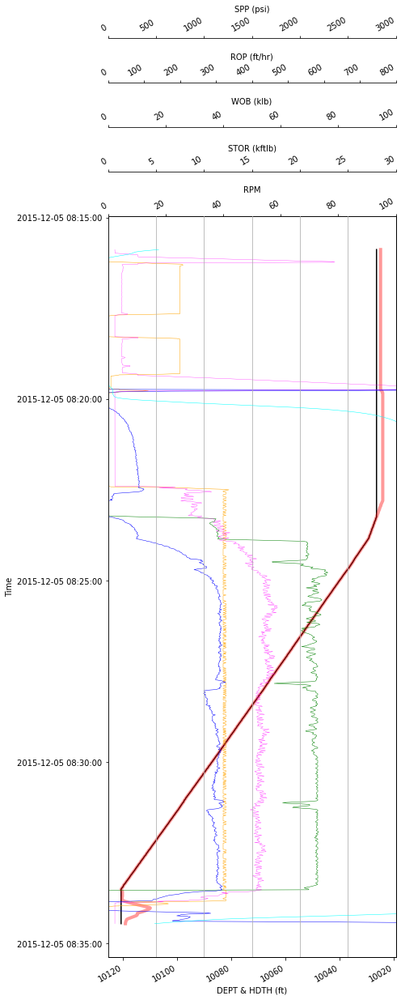

121


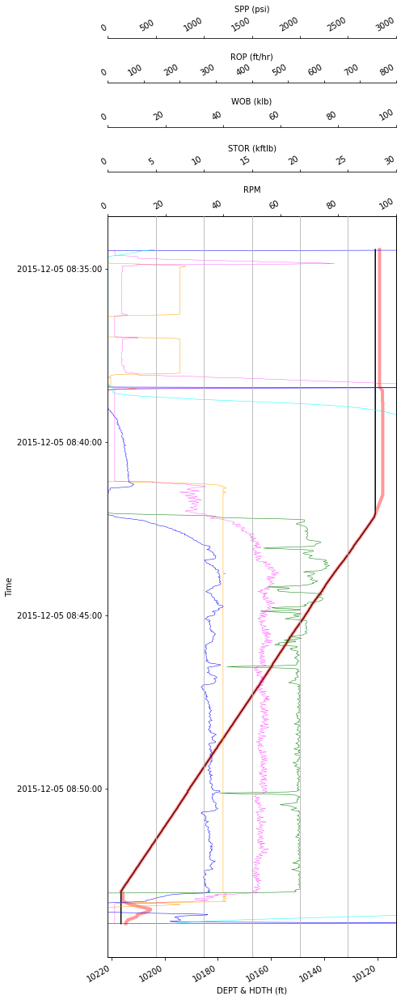

122


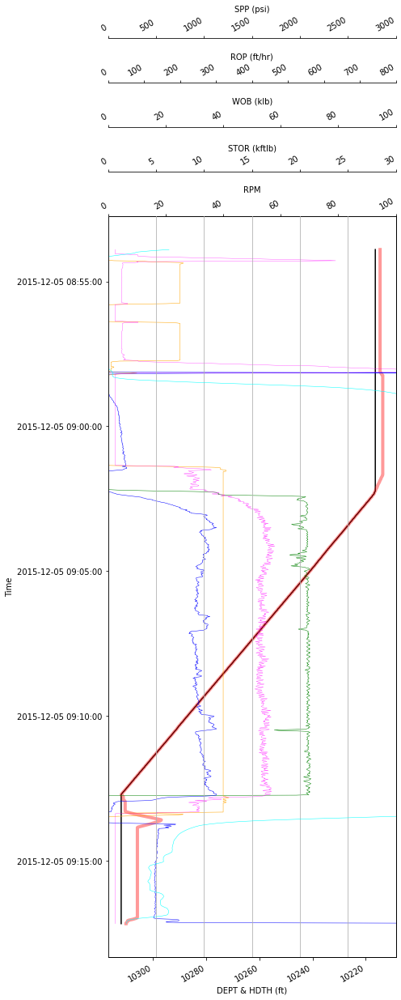

123


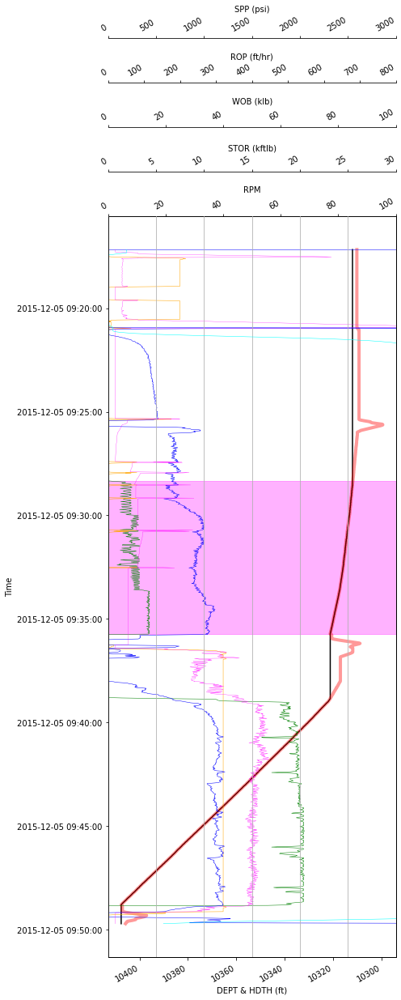

124


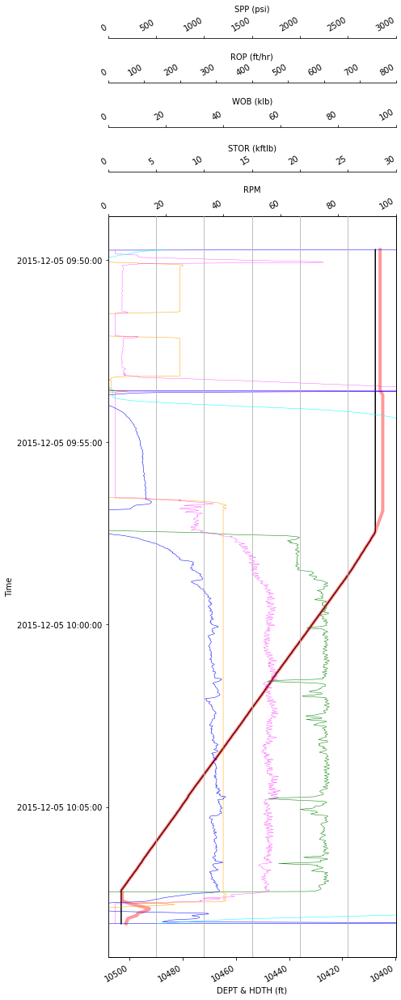

125


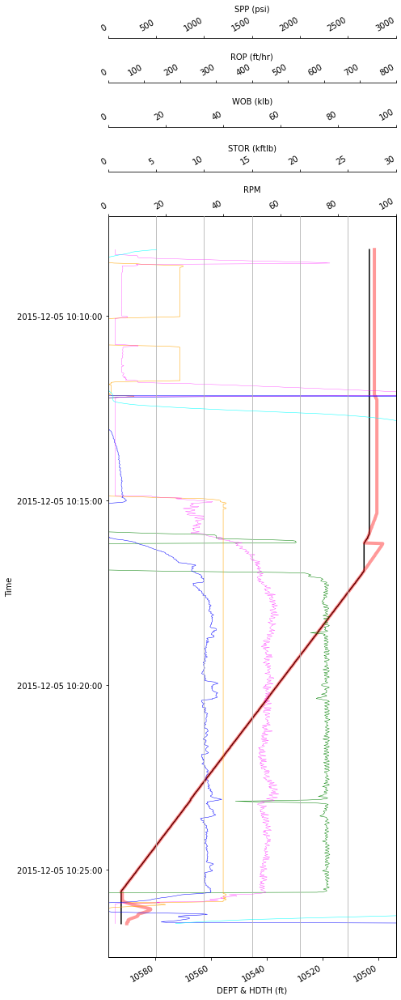

126


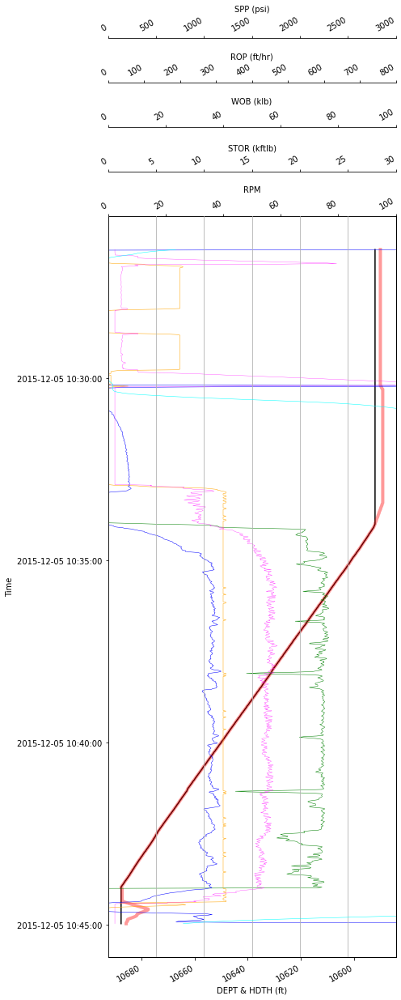

127


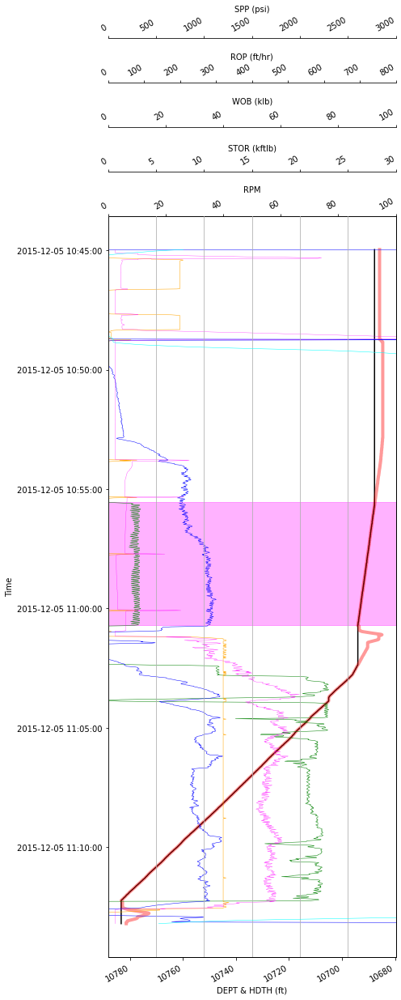

128


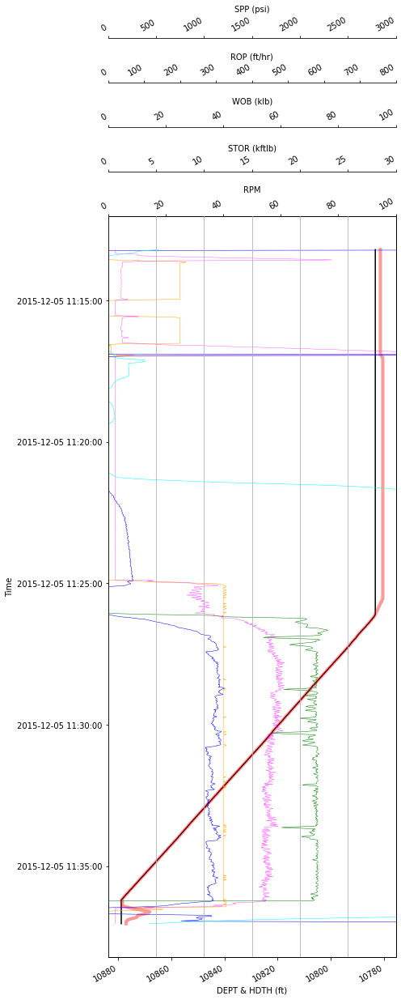

129


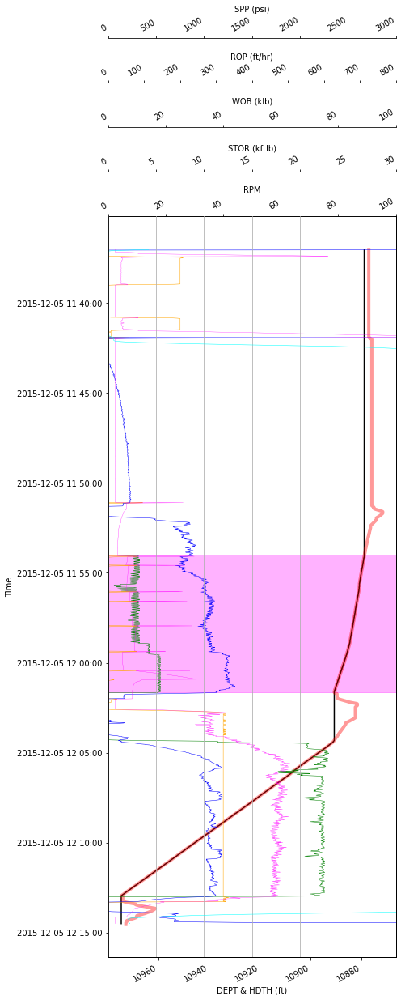

130


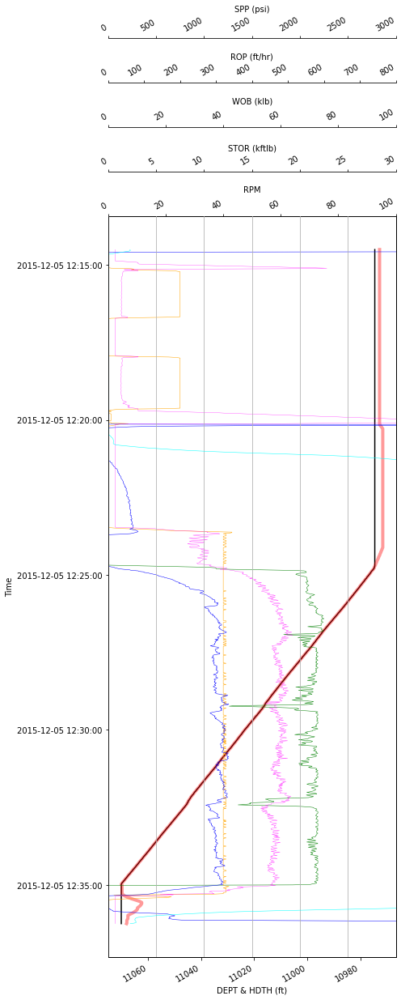

131


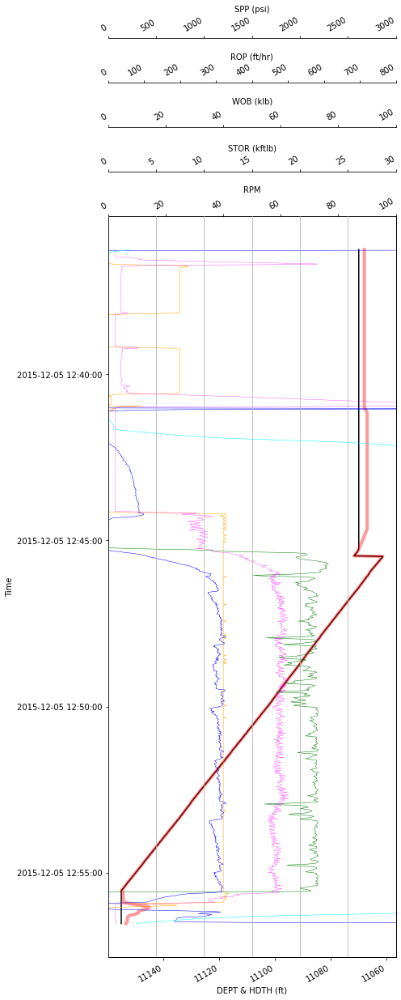

132


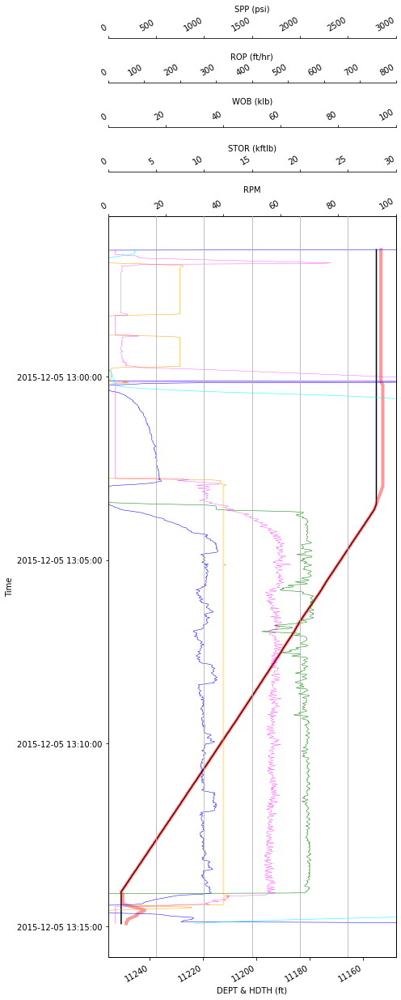

133


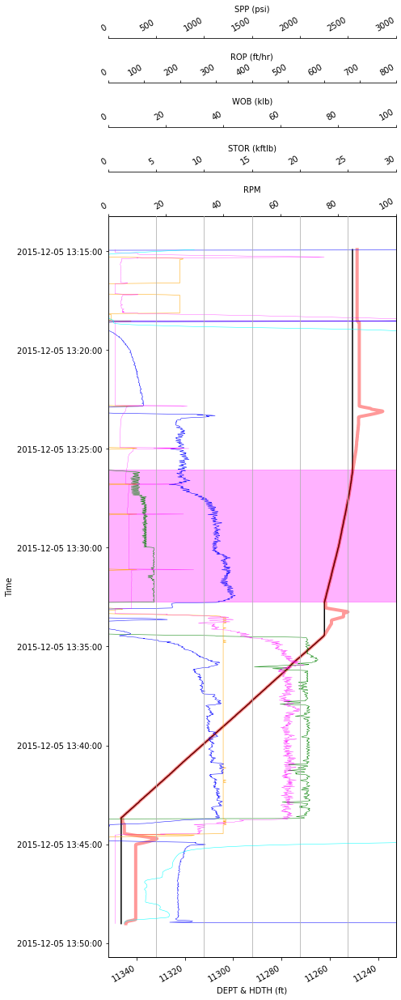

134


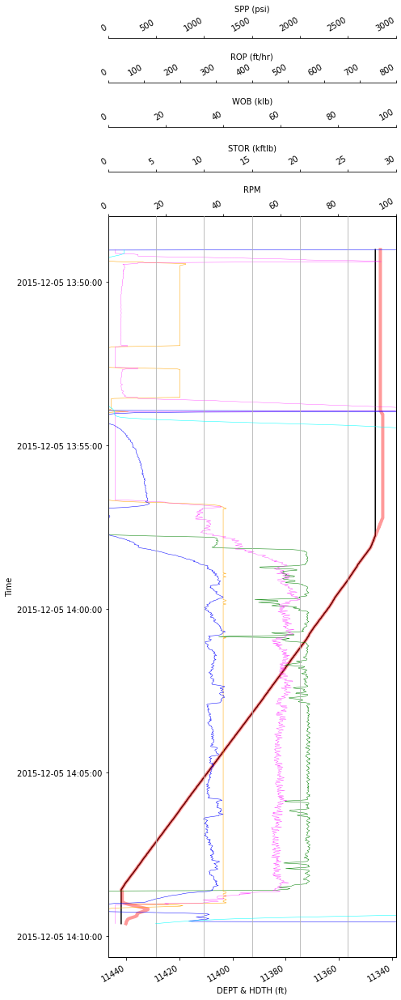

135


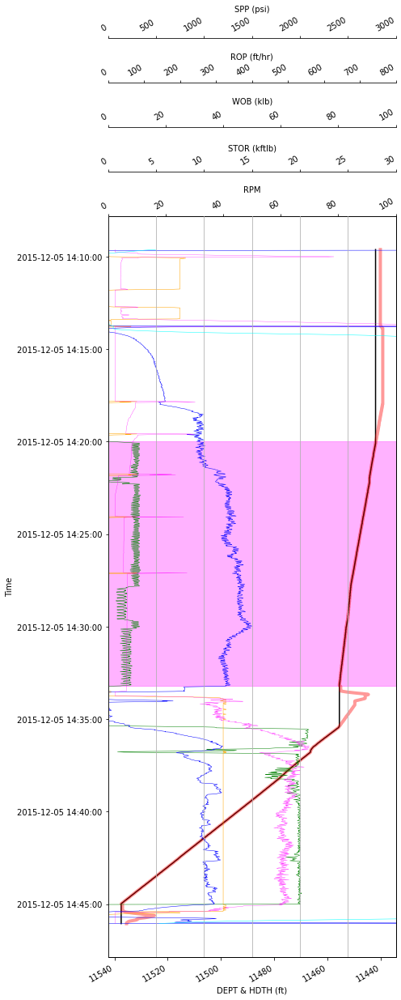

136


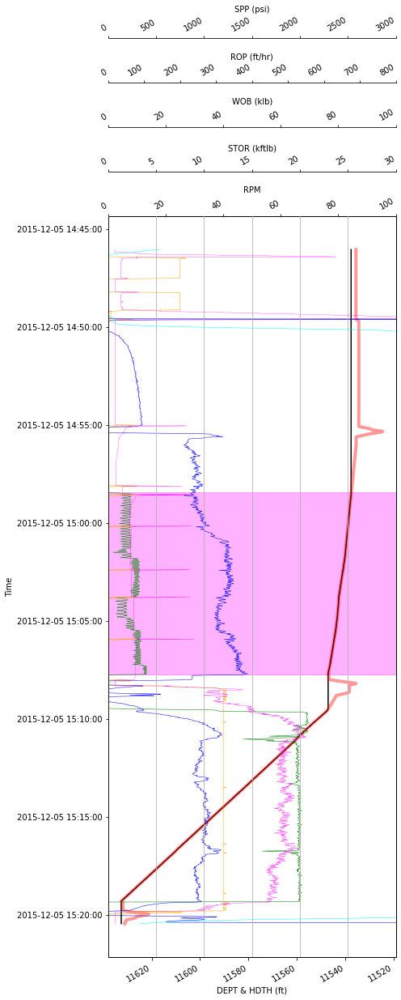

137


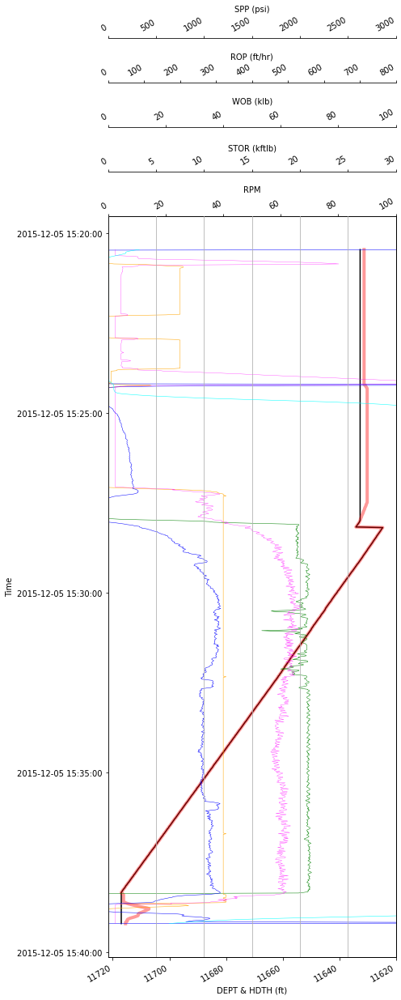

138


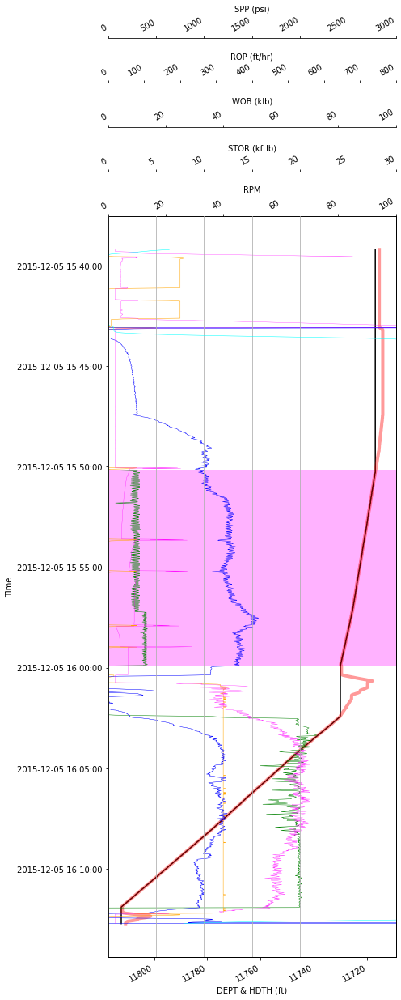

139


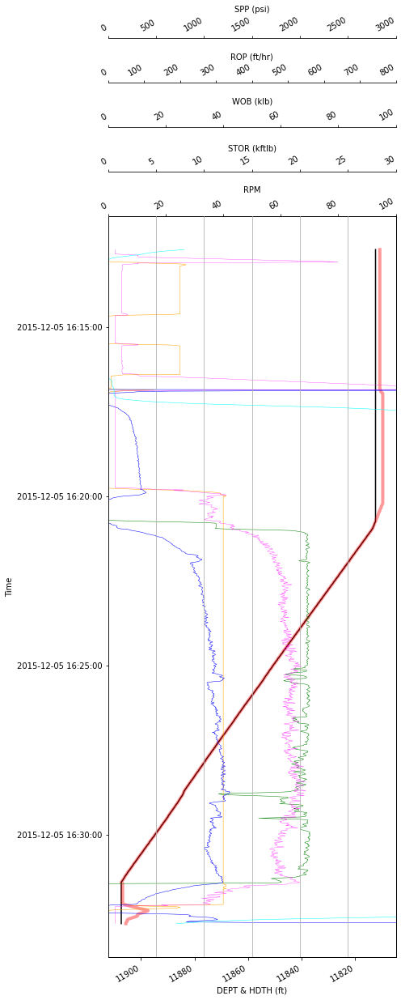

140


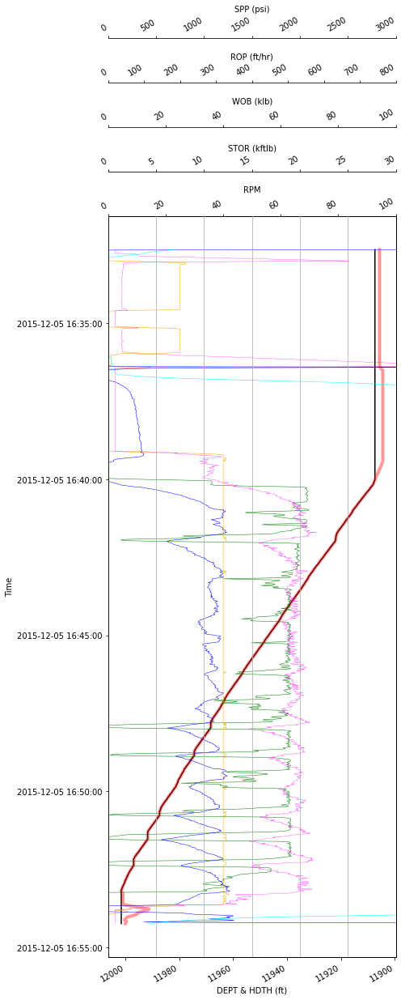

141


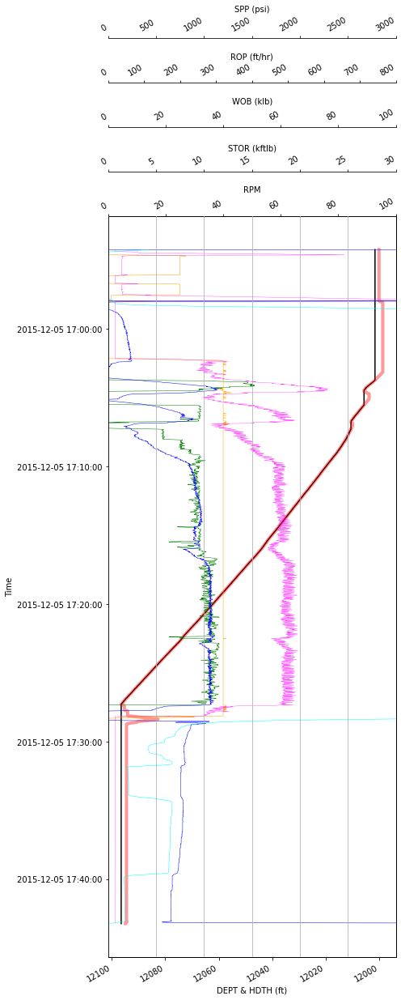

142


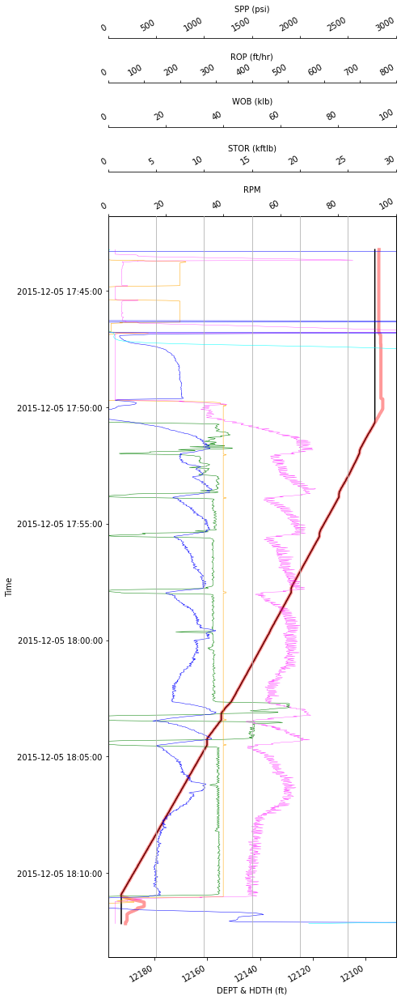

143


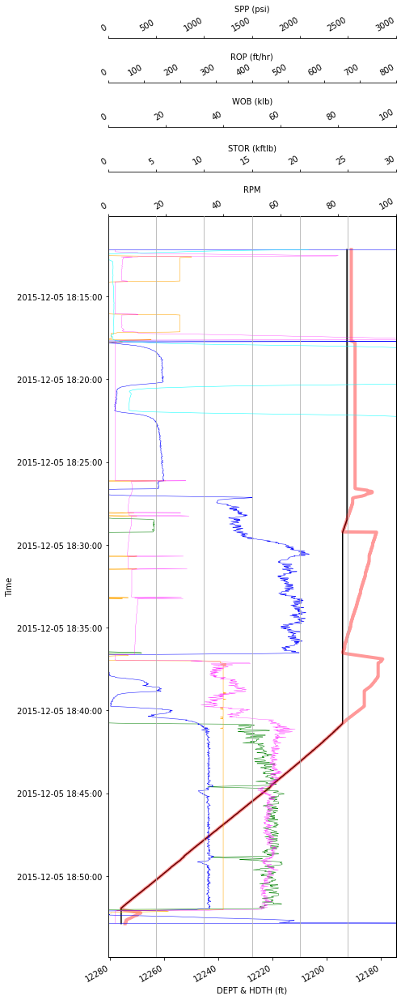

144


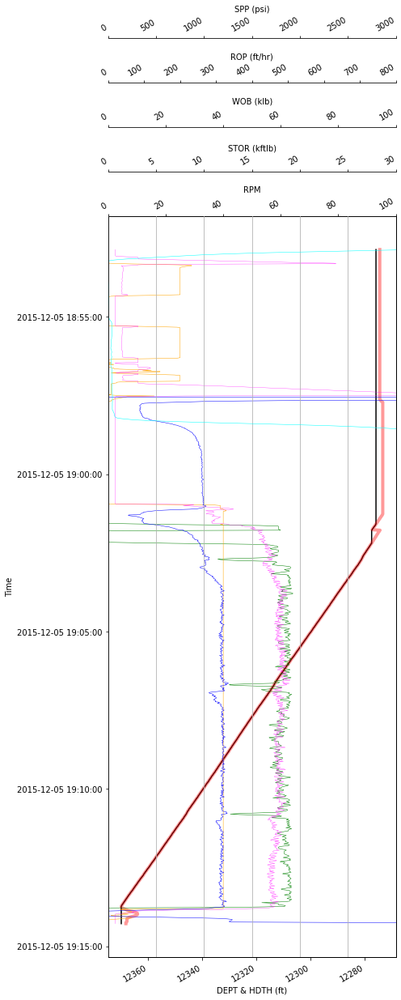

145


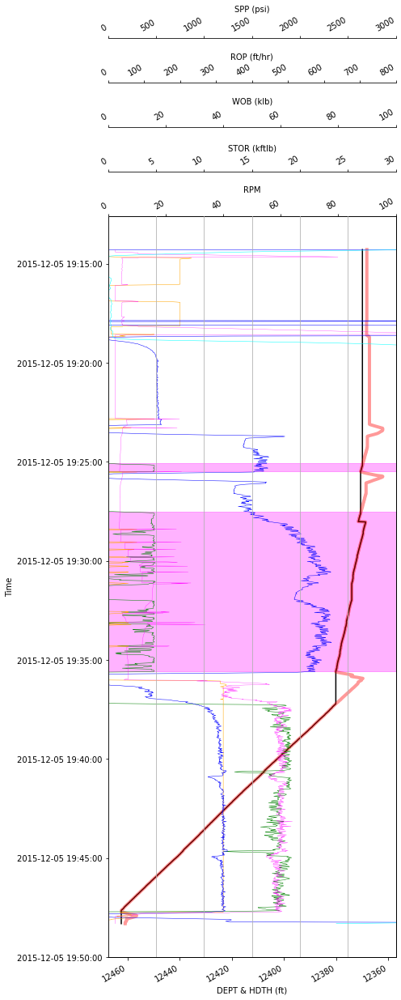

146


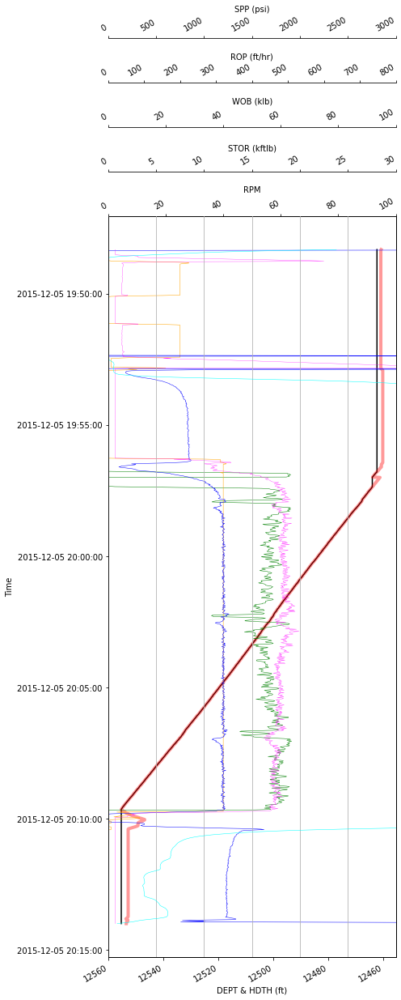

147


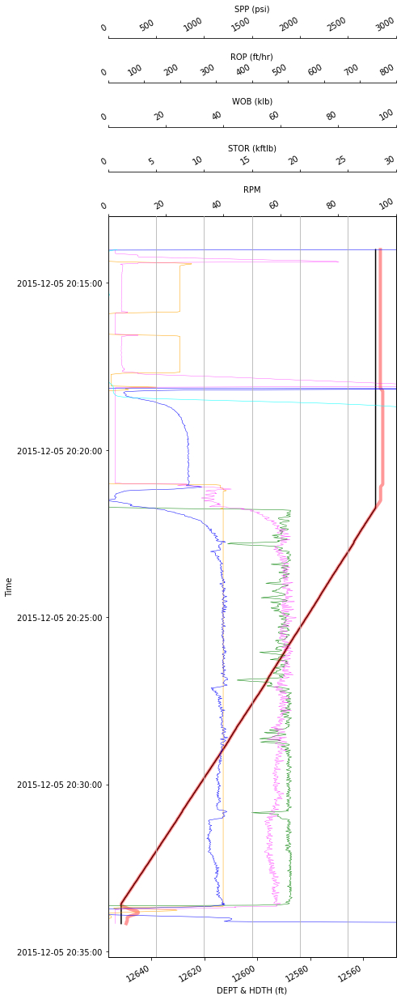

148


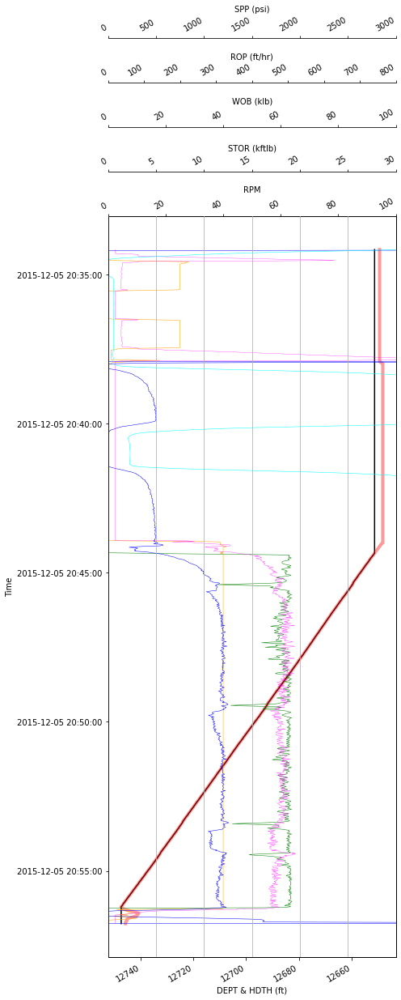

149


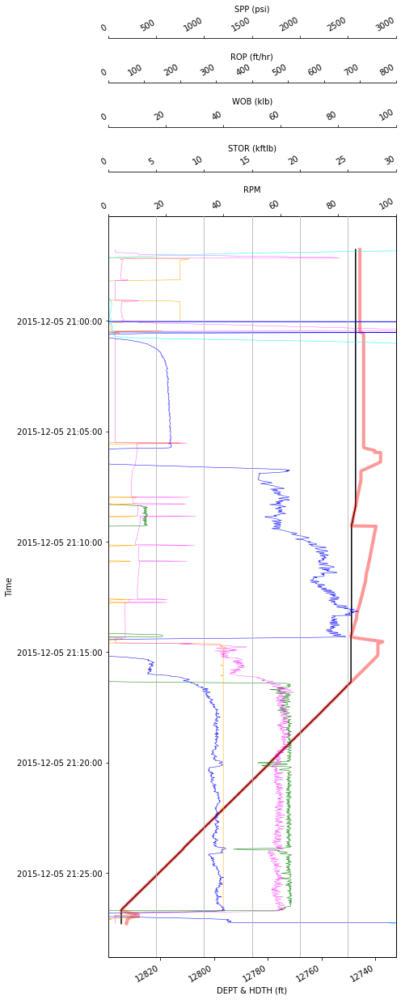

150


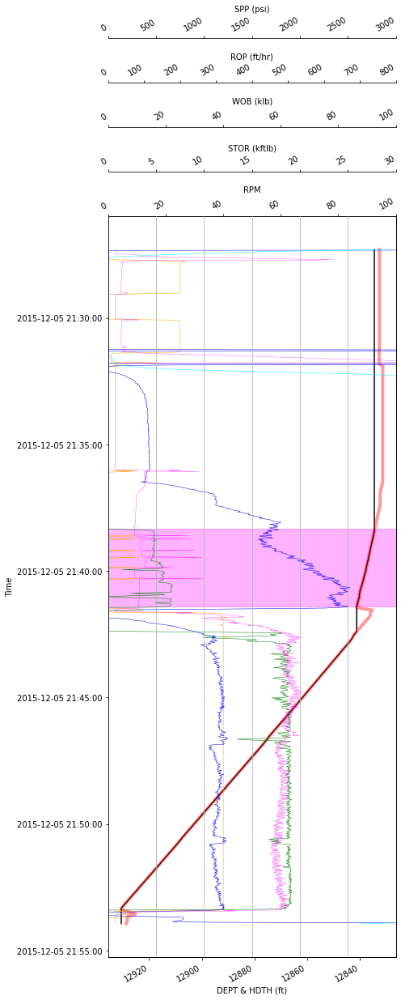

151


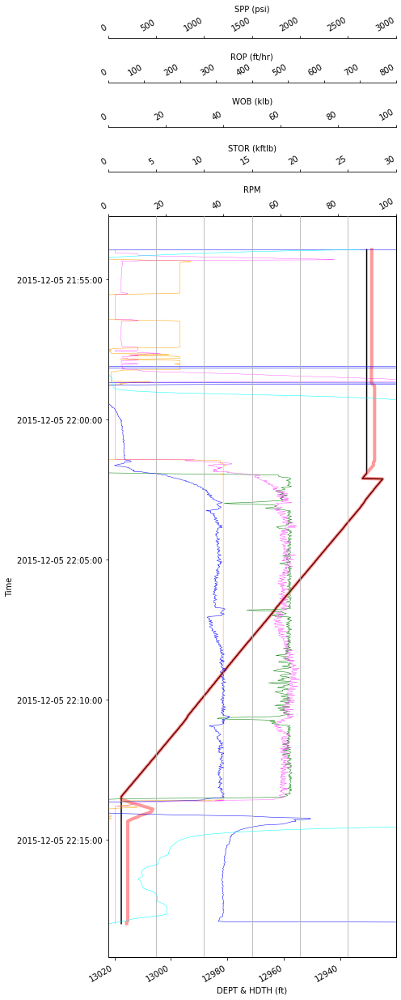

152


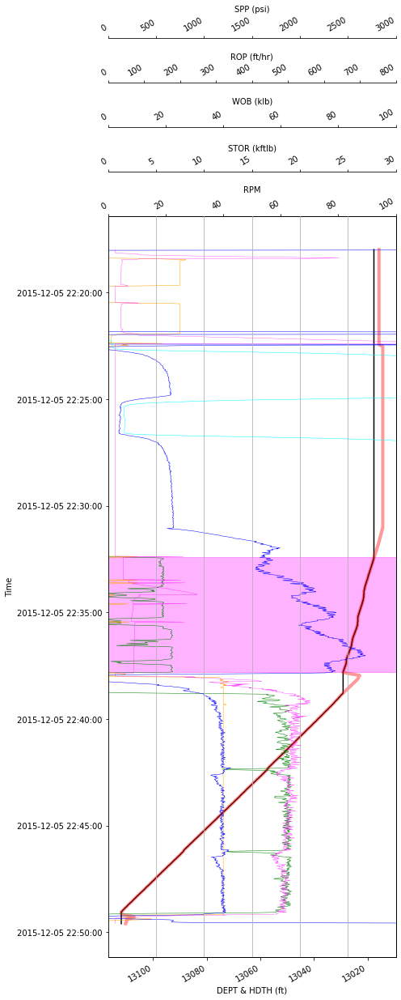

153


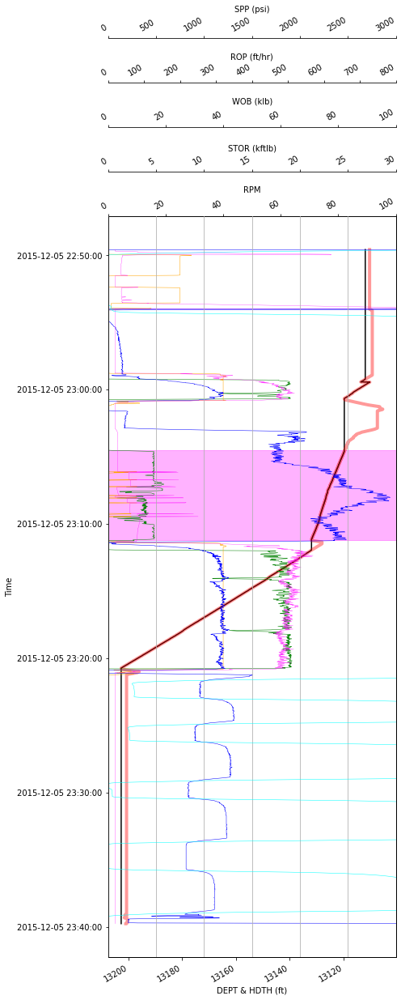

154


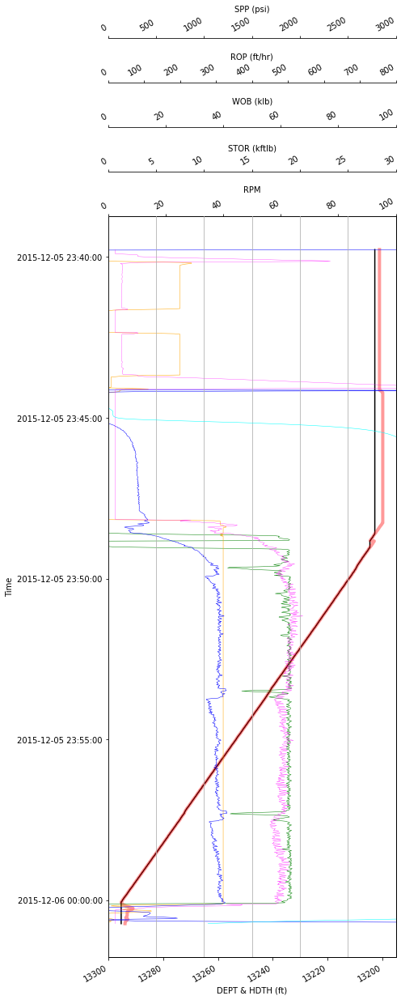

155


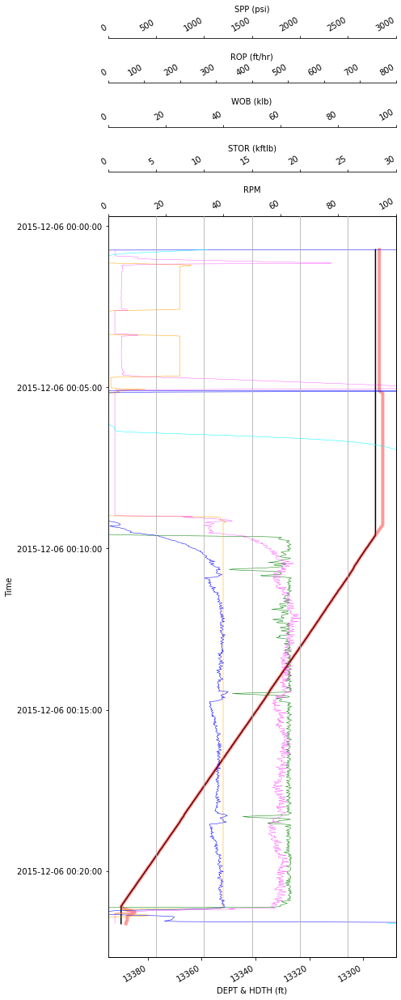

156


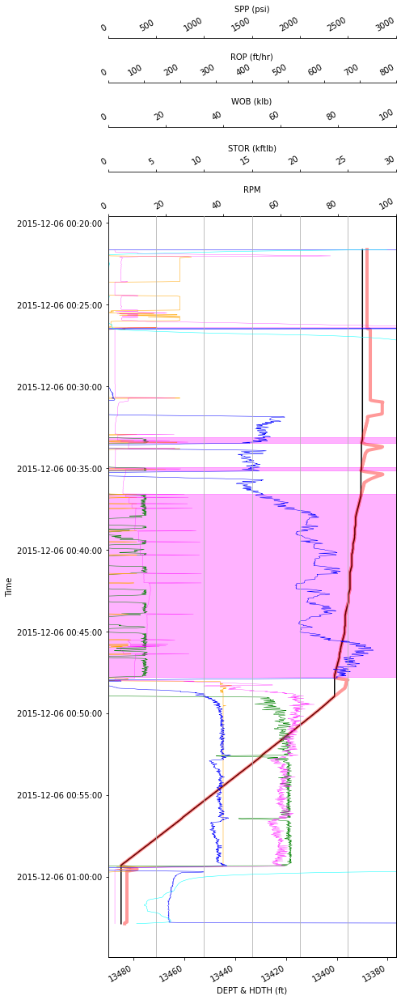

157


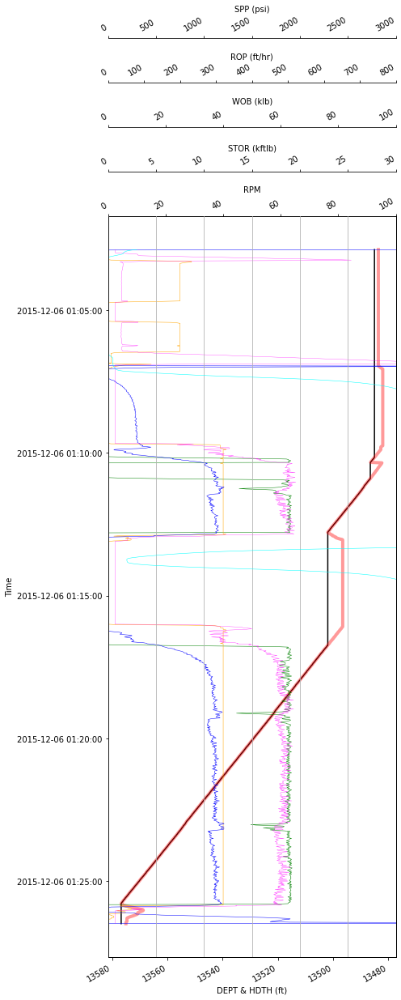

158


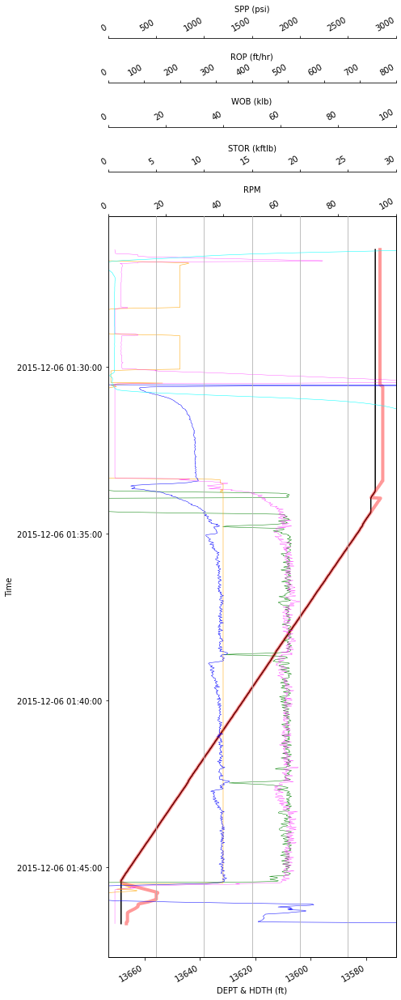

159


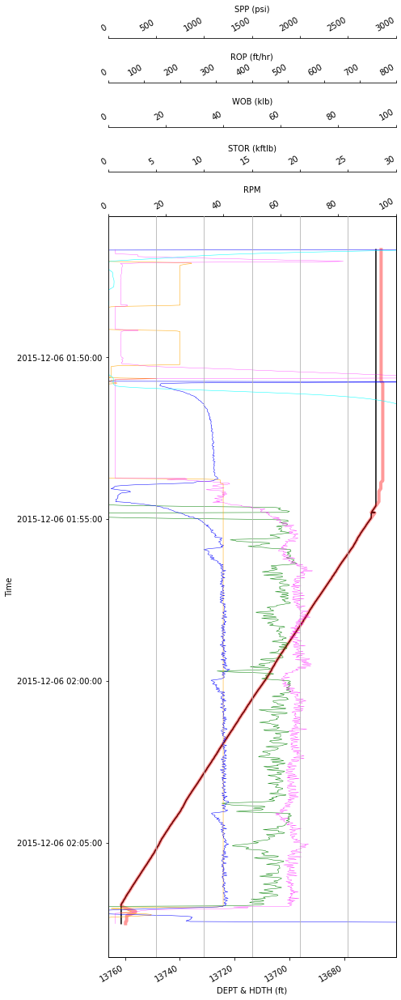

160


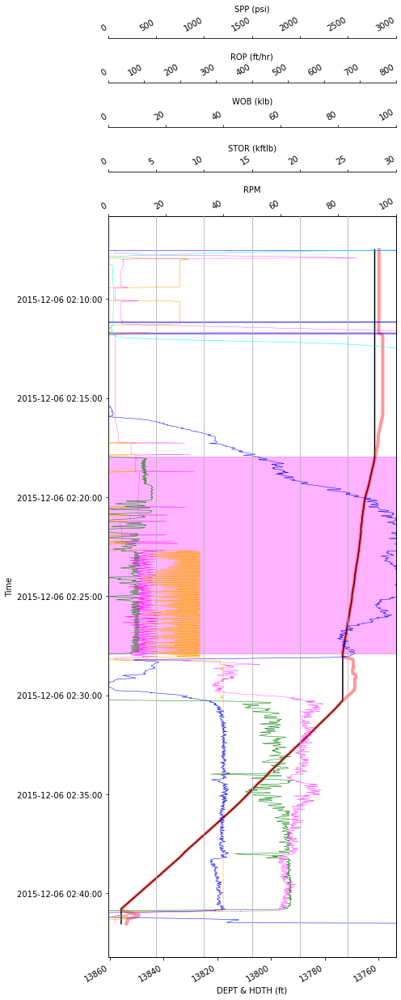

161


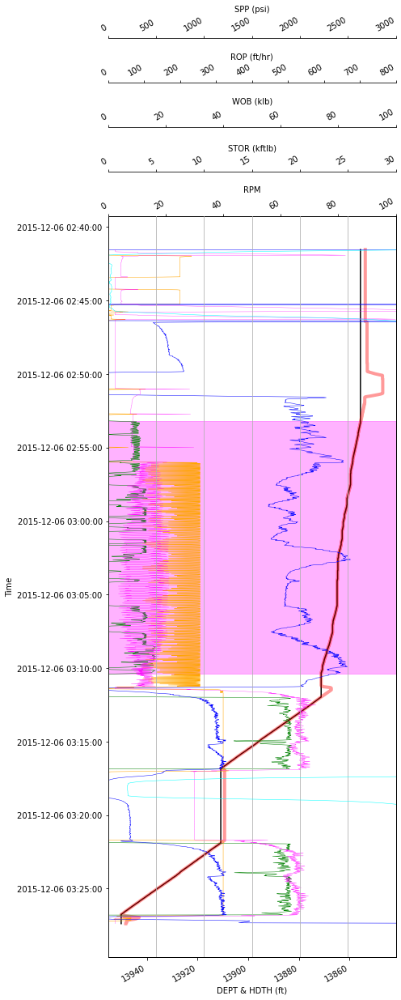

162


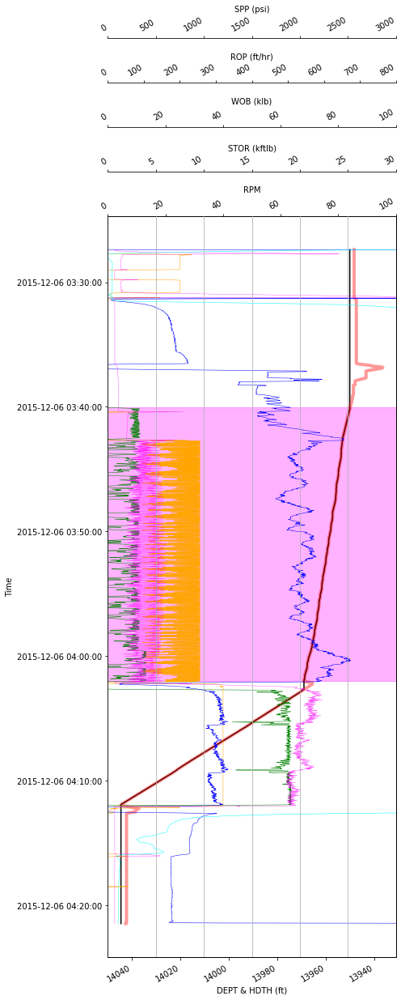

163


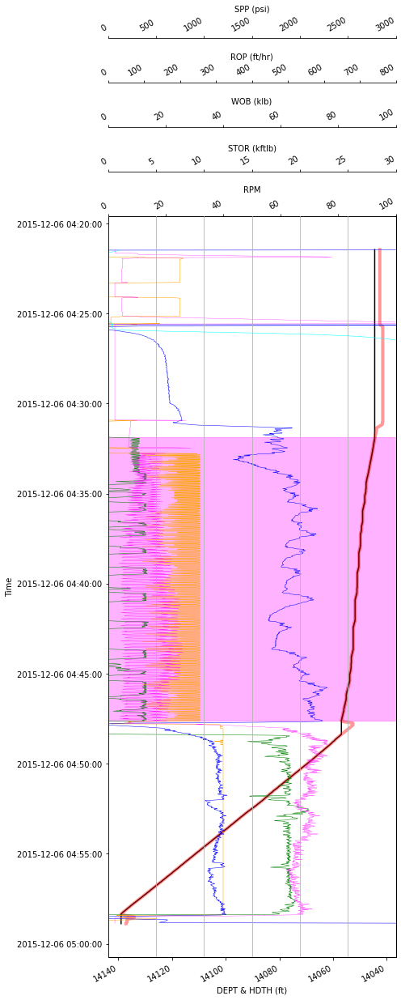

164


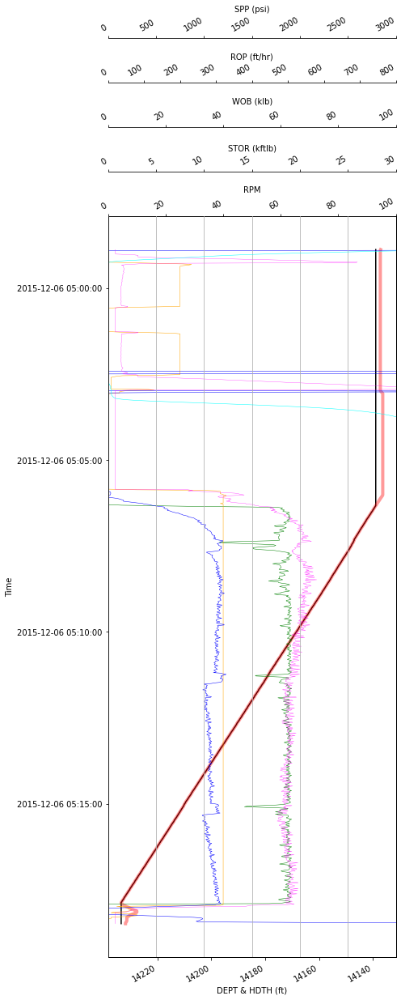

165


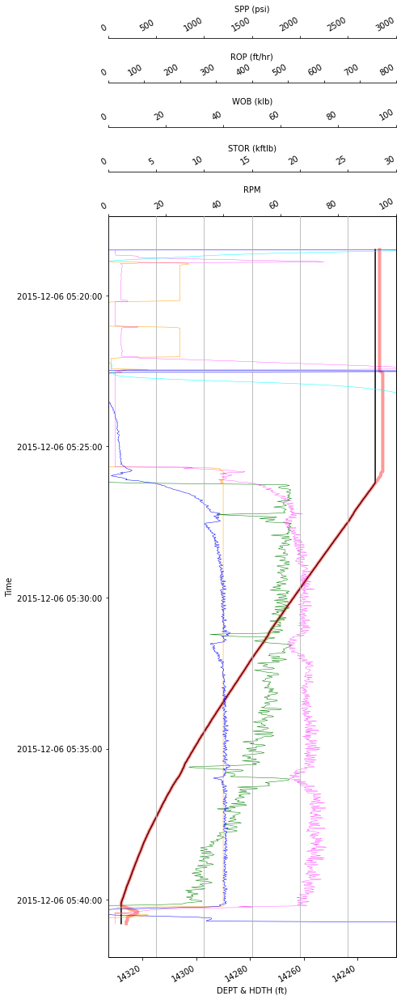

166


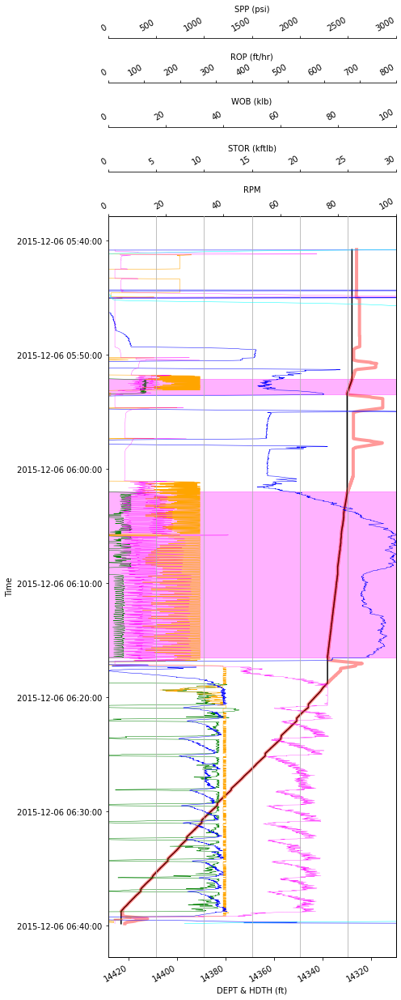

167


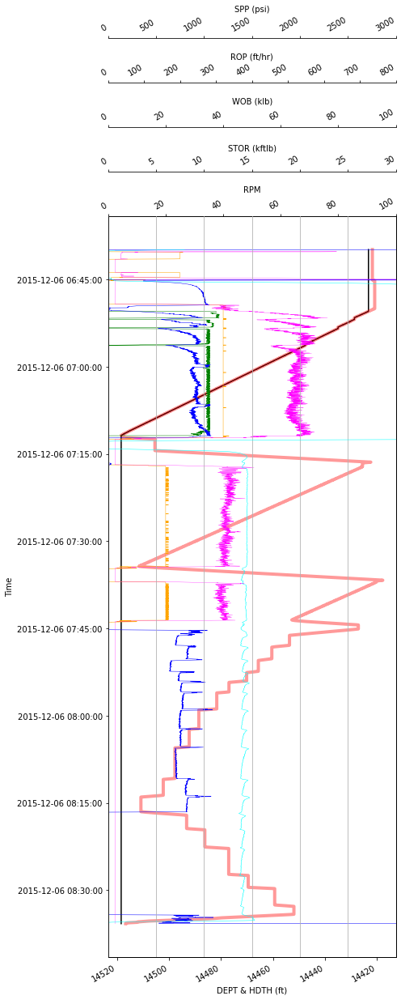

168


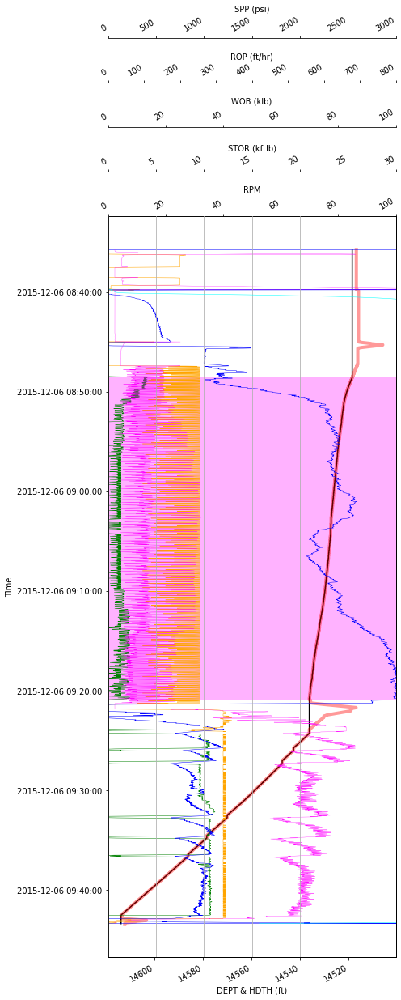

169


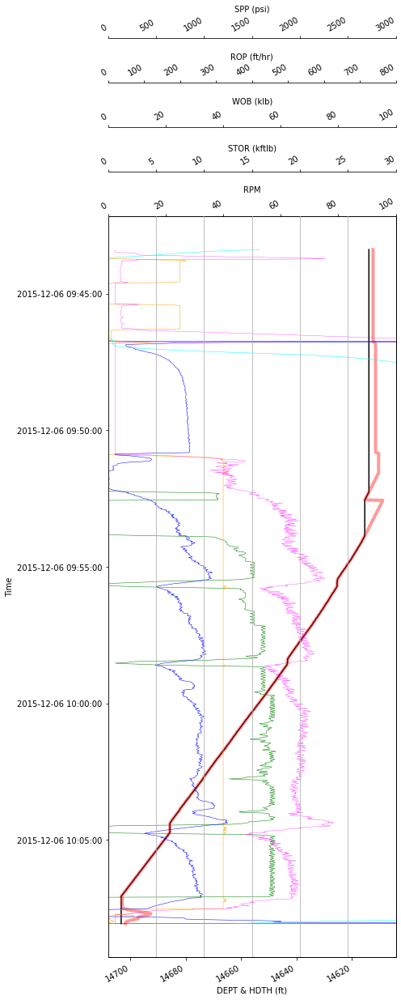

170


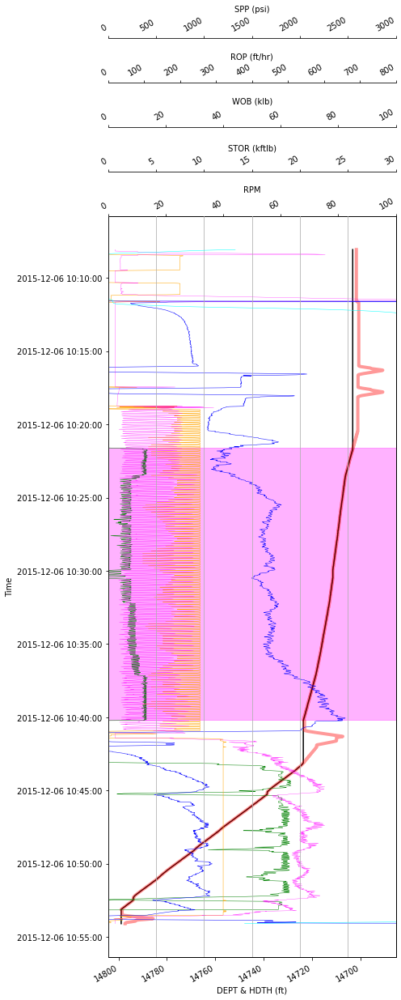

171


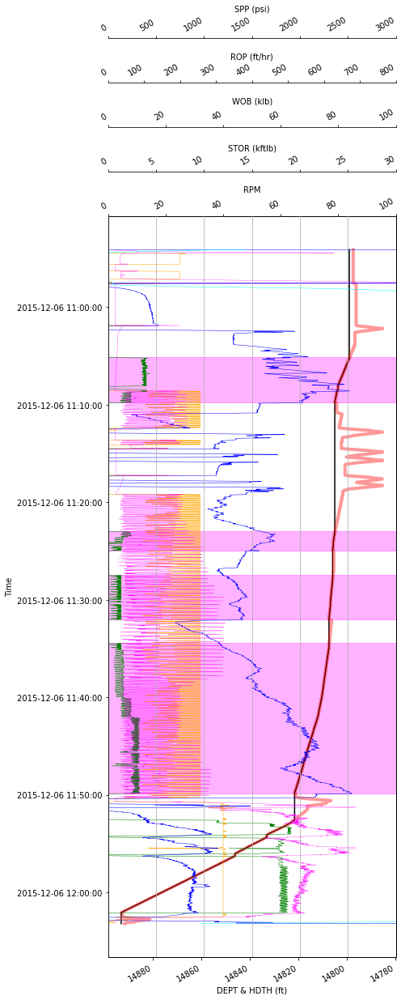

172


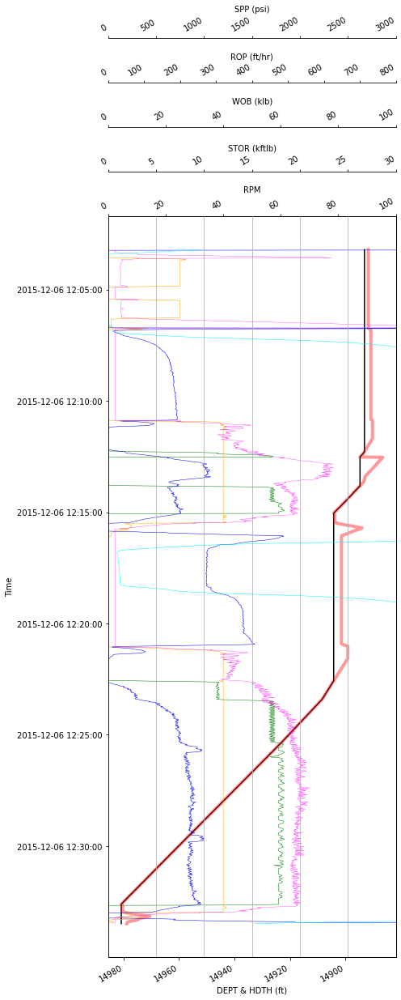

173


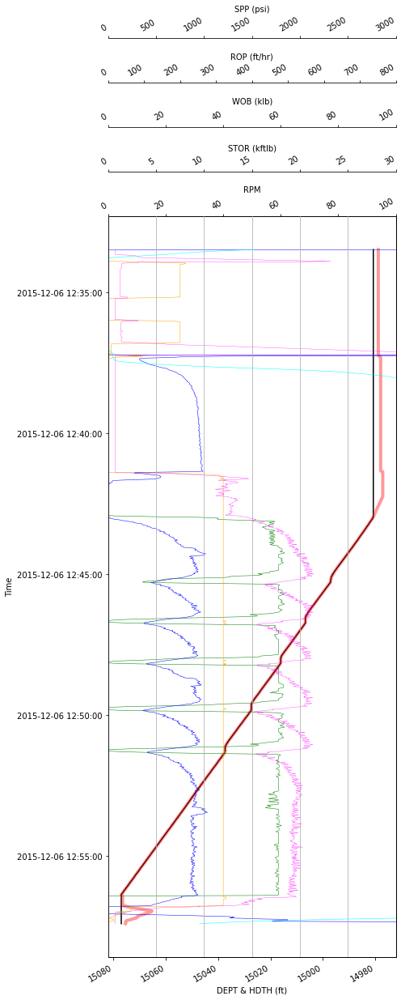

174


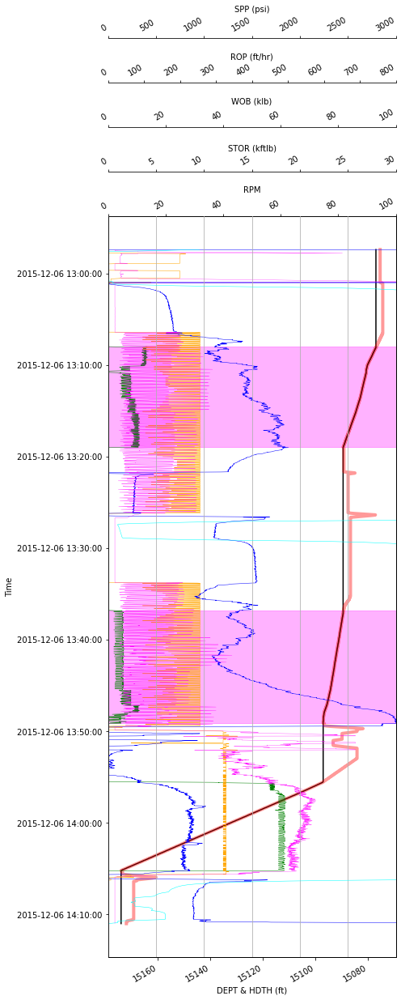

175


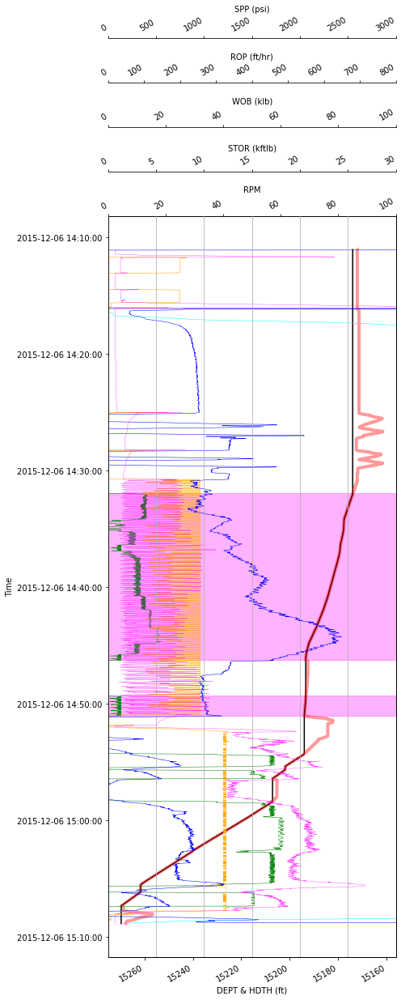

176


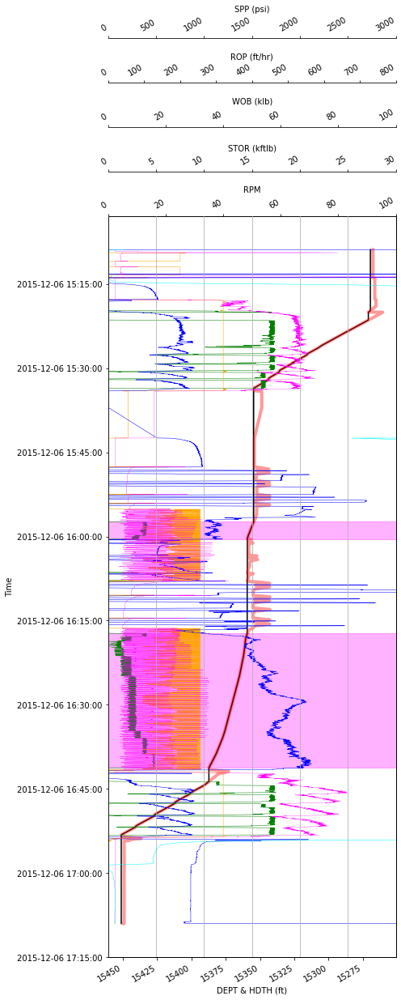

177


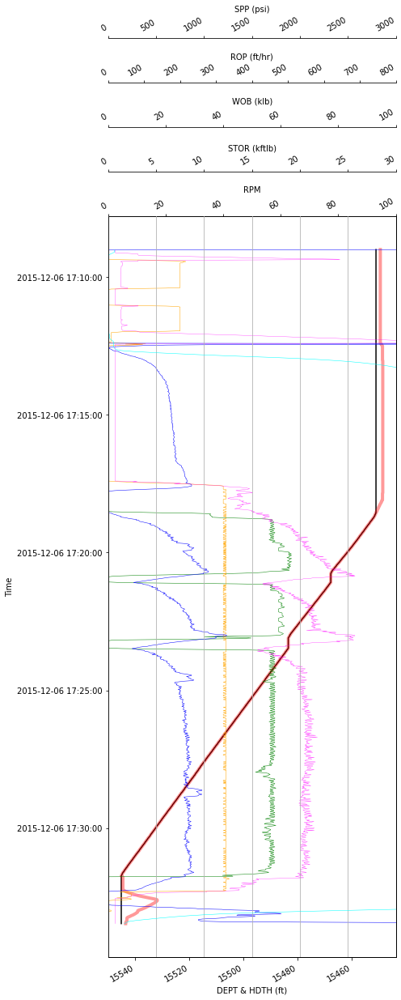

178


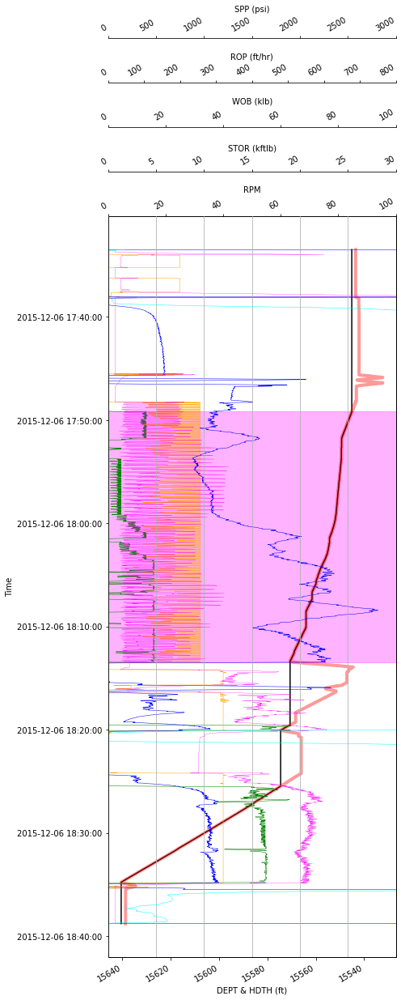

179


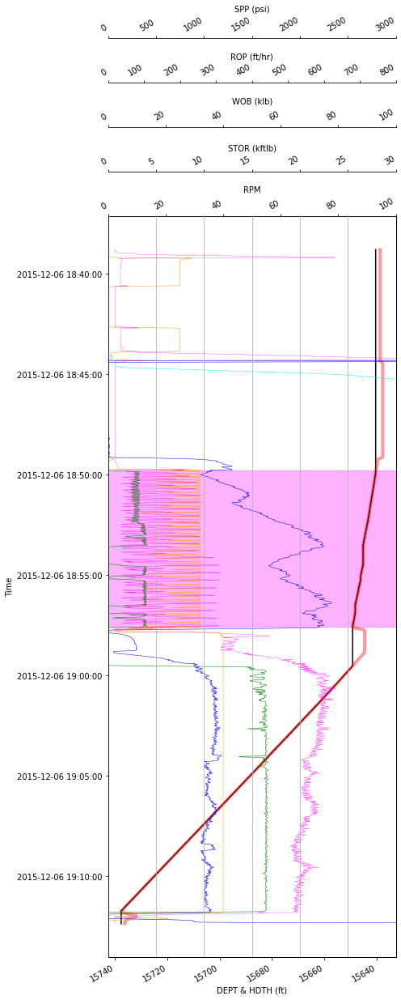

180


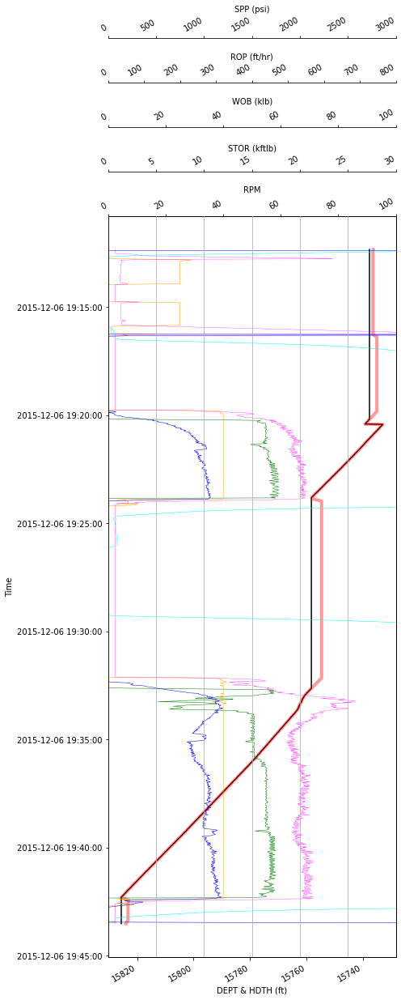

181


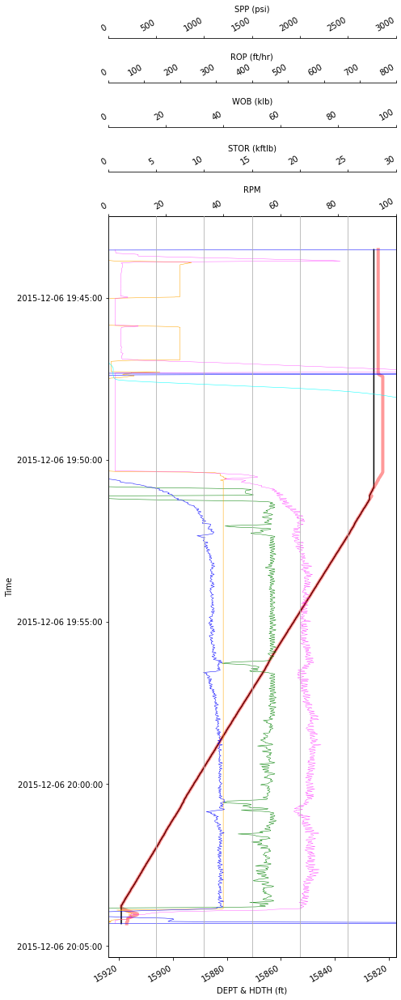

182


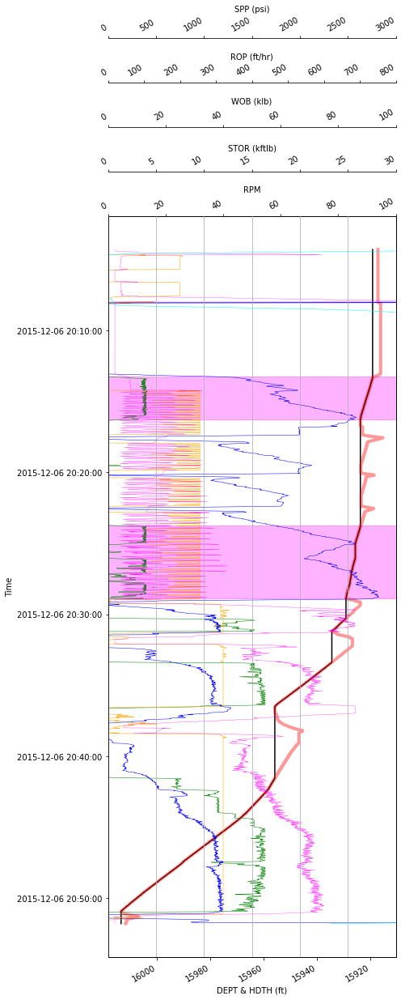

183


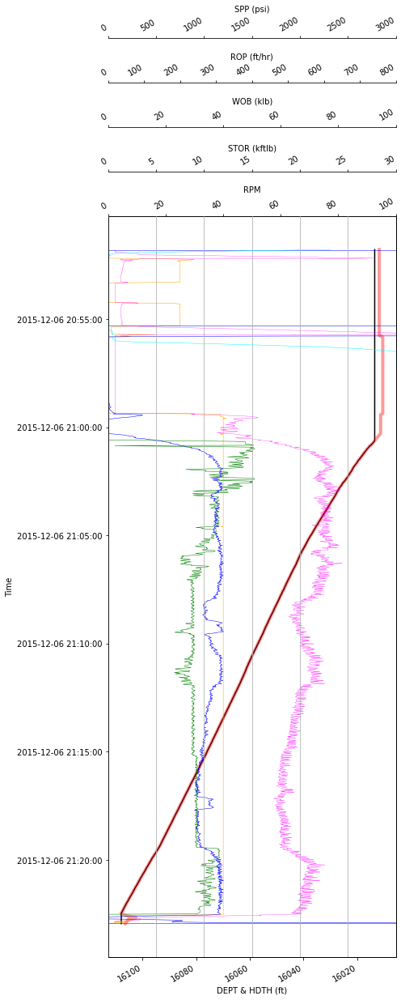

184


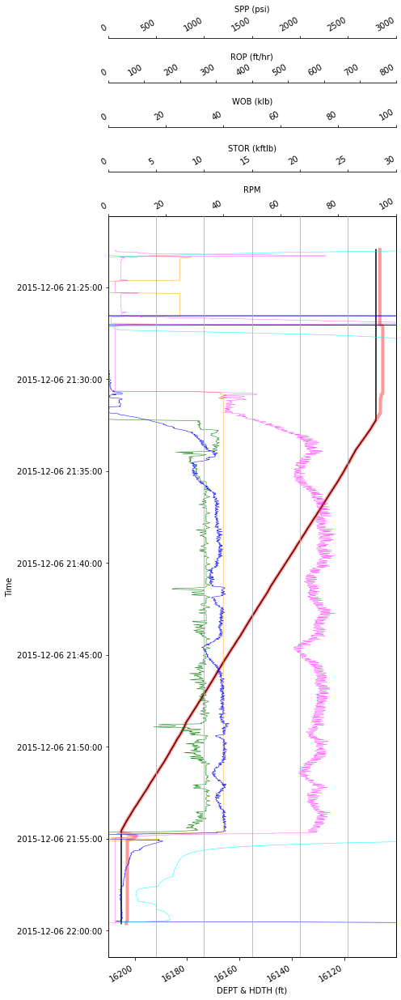

185


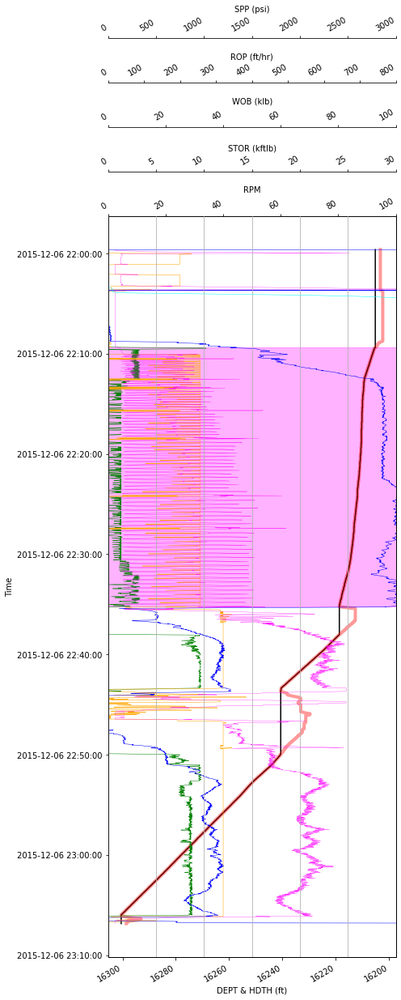

186


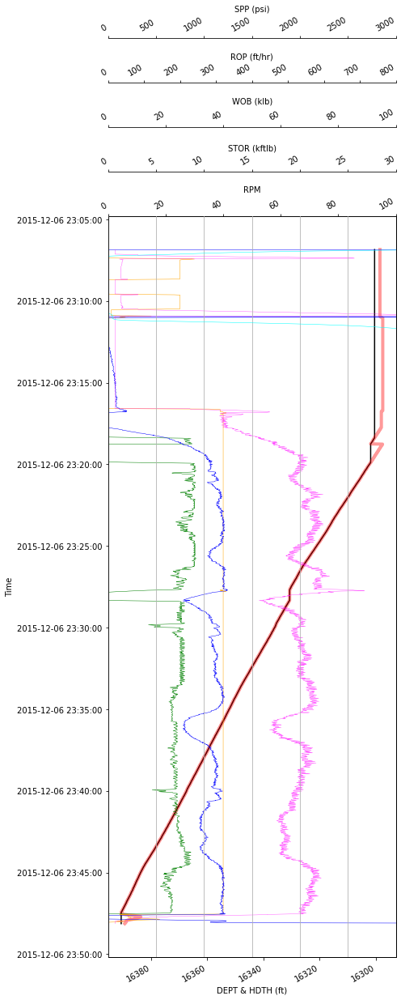

187


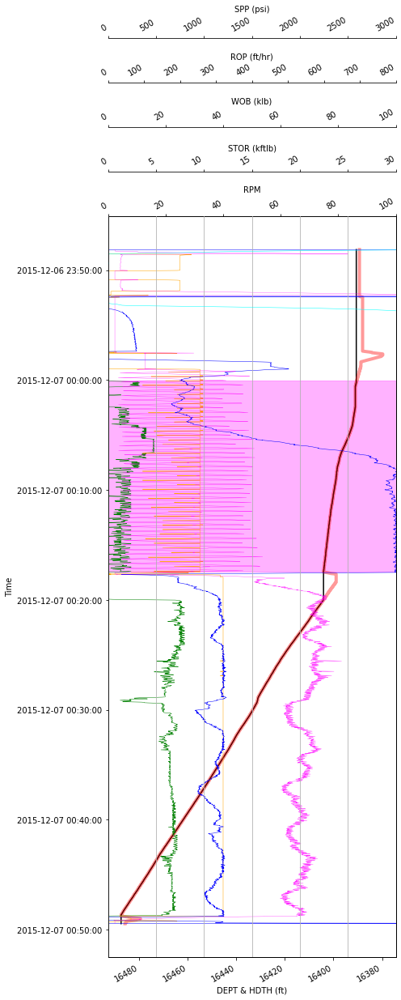

188


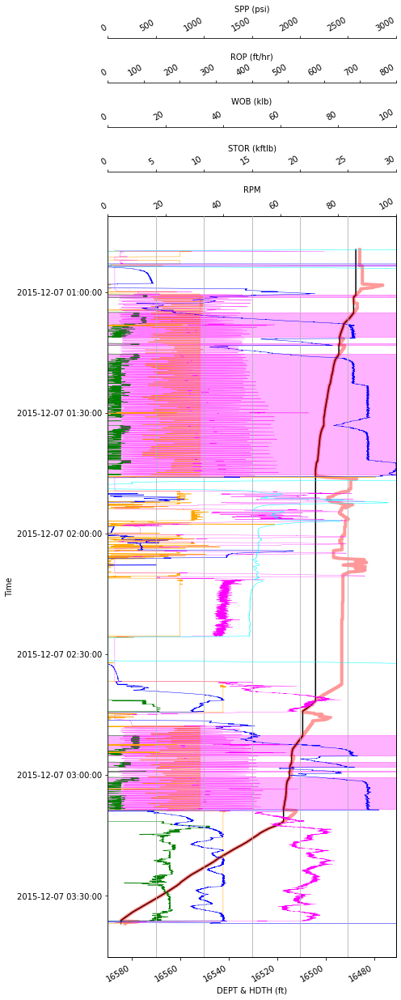

189


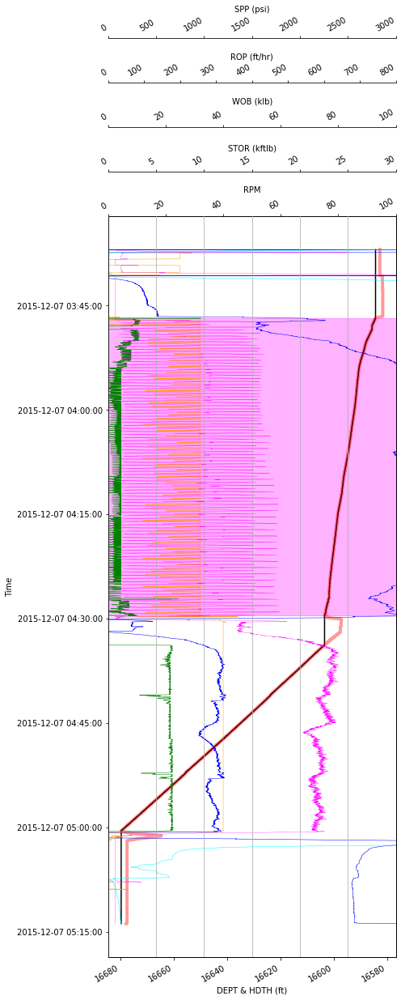

190


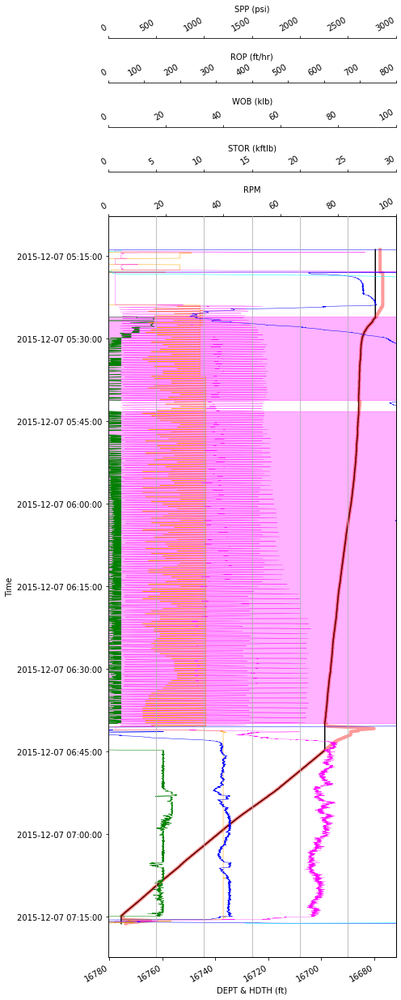

191


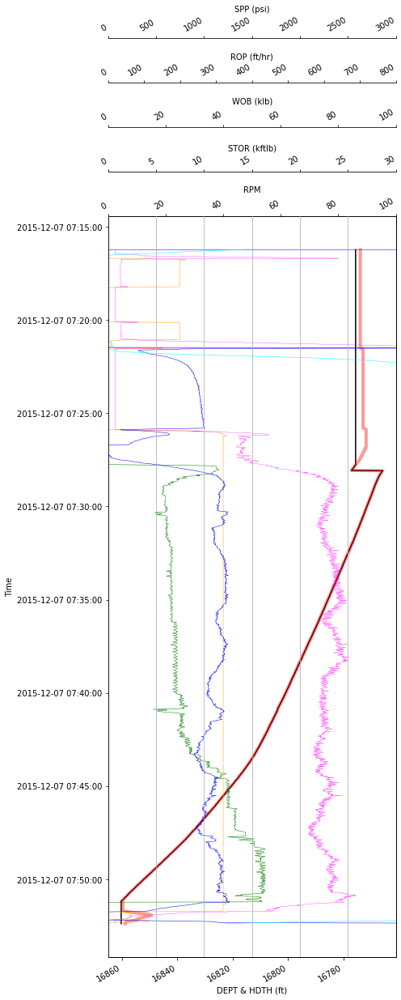

192


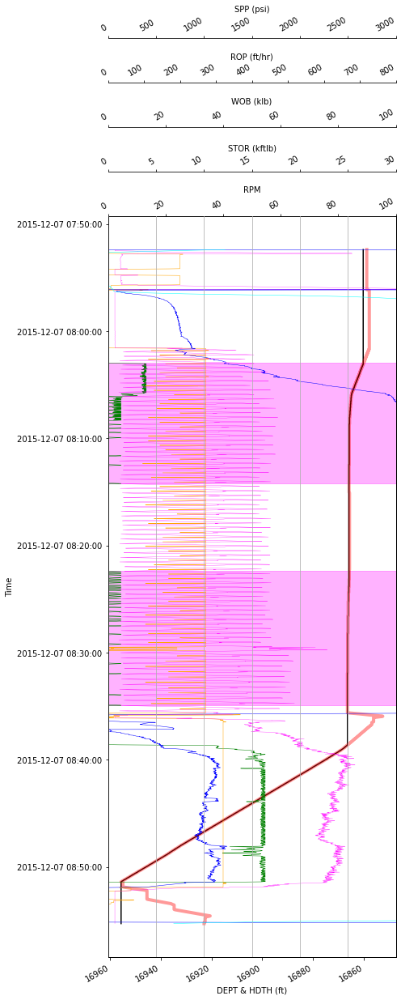

193


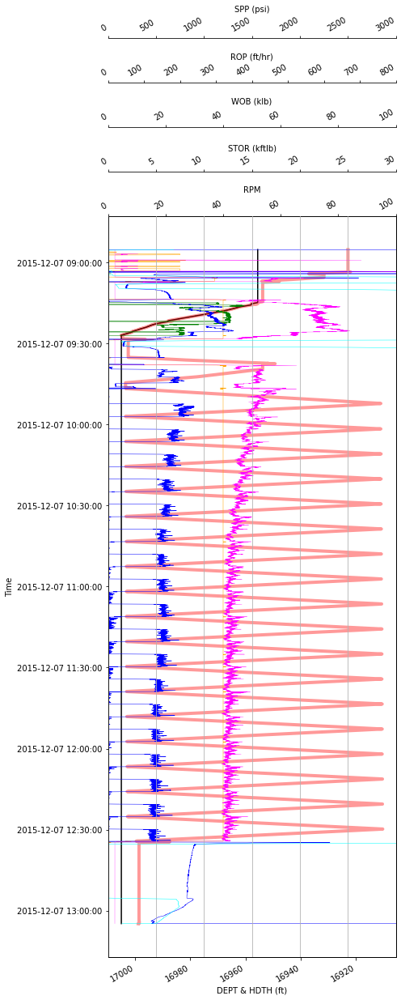

194


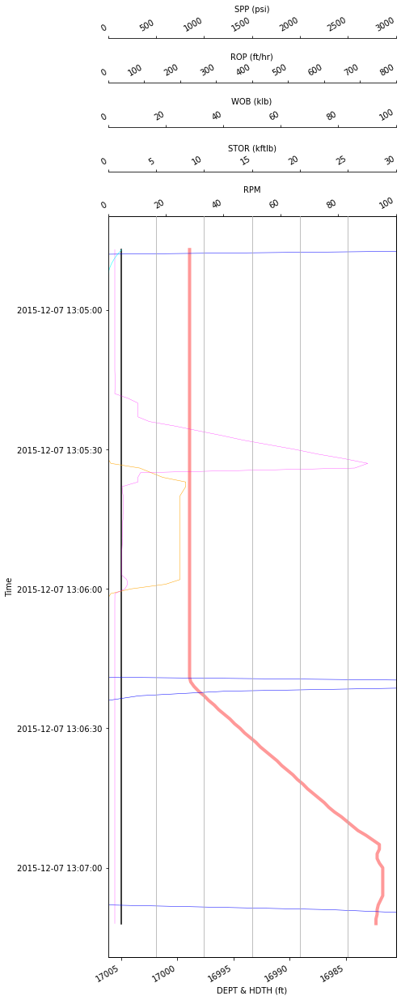

195


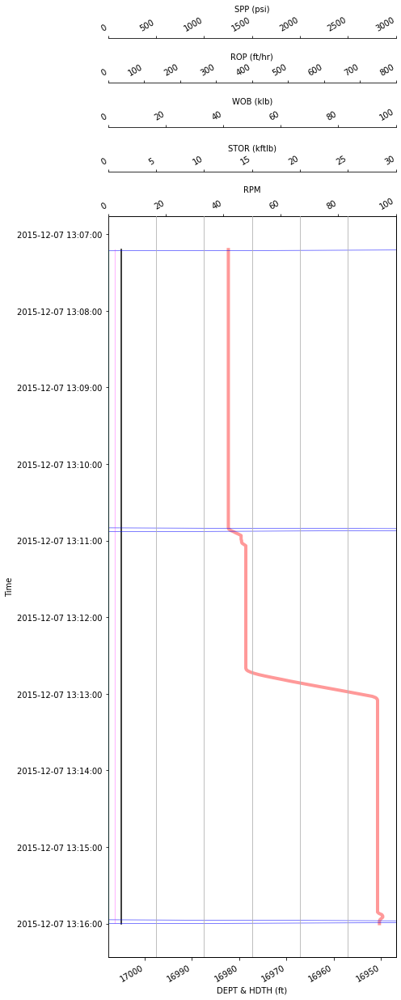

In [38]:
#THIS IS STAND BY STAND VISUALIZATION OF DRILLING DATA WITH SLIDING SHADED

# %pylab

for string_element_partition in tubular_elements[stand_start:stand_end]:#slice the tubular elements to isolate a single stand etc...
    data_ = df[string_element_partition['start_time']:string_element_partition[
                'end_time']] #data_is the new df    

    print(string_element_partition['index'])
    
    datetime_index = pd.to_datetime(data_["Date/Time"])
    fig = plt.figure(figsize = (7, 15))
    ax1 = fig.add_subplot(1,1,1)
    ax1.set_ylabel("Time")
    ax1.set_xlabel('DEPT & HDTH (ft)')

 #-----------------------------------------------------------------------------------------------------------------
          
#     Shading sliding intervals using regular expressions
    
    data_['sliding_state'] = data_['sliding']
    data_['sliding_state'][np.where(data_['sliding']==1)[0]] = 'a'
    data_['sliding_state'][np.where(data_['sliding']!=1)[0]] = 'b'
    string = data_['sliding_state'].values # copying the sliding_state into a variable
    string = ''.join(string) #creating a string out of the array
    shock_expression = re.compile(r'(a+)') # finds continuous string of a's 
    m_iter = shock_expression.finditer(string) 
    sliding = [m.span() for m in m_iter] # finds the start and end couples for the slides
    
    for start, end in sliding:
         ax1.axhspan(datetime_index[start],datetime_index[end-1], color='magenta', alpha = 0.3)

          
 #-----------------------------------------------------------------------------------------------------------------
                      
    ax1.plot(data_['HDTH'].values, datetime_index, 'black', label = 'hdept') # x position, y position 
    ax1.plot(data_['DEPT'].values, datetime_index, 'red', label = 'bdep', linewidth = 4, alpha = 0.4)

    ax2 = ax1.twiny()
    ax2.spines["top"].set_position(("axes", 1.18))    
    ax2.plot(data_['ROP'], datetime_index, 'green', label = 'ROP',linewidth = 0.5)
    ax2.set_xlabel('ROP (ft/hr)')
    ax2.set_xlim([0,800])

    ax4 = ax1.twiny()
    ax4.spines["top"].set_position(("axes", 1.00))    
    ax4.plot(data_['RPM'], datetime_index, 'orange', label = 'RPM',linewidth = 0.5)
    ax4.set_xlabel('RPM')
    ax4.set_xlim([0,100])
    
    ax3 = ax1.twiny()
    ax3.spines["top"].set_position(("axes", 1.12))    
    ax3.plot(data_['SWOB'], datetime_index, 'blue', label = 'WOB',linewidth = 0.5)
    ax3.set_xlabel('WOB (klb)')
    ax3.set_xlim([0,100])
    
    ax5 = ax1.twiny()
    ax5.spines["top"].set_position(("axes", 1.06))    
    ax5.plot(data_['STOR'], datetime_index, 'magenta', label = 'STOR',linewidth = 0.3)
    ax5.set_xlabel('STOR (kftlb)')
    ax5.set_xlim([0,30])

    ax6 = ax1.twiny()
    ax6.spines["top"].set_position(("axes", 1.24))    
    ax6.plot(data_['SPPA'], datetime_index, 'cyan', label = 'SPP',linewidth = 0.5)
    ax6.set_xlabel('SPP (psi)')
    ax6.set_xlim([0,3000])
    
    plt.grid(True)
    
    #-----------------------------------------------------------------------------------------------------------------
          
    ax1.yaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M:%S')) #date format
    plt.gcf().autofmt_xdate()
#     fig.legend()
    fig.tight_layout()
    ax1.invert_xaxis() #reversed axis 1
    ax1.invert_yaxis() #reversed axis 1
    plt.subplots_adjust(top=0.9)
    plt.grid(True)
    mplcursors.cursor(hover=True)
#     plt.savefig(str(string_element_partition['index']), bbox_inches = "tight")
#     plt.close()
    plt.show()  

# plt.subplots_adjust(left=0.0, bottom=0.0, right=1, top=1, wspace=0, hspace=0)


From the visualisation is is clear that we only need to look at data from approximately **'2015-12-03 21:35:00'** to **'2015-12-07 08:50:00'** as that is all that is labelled. 

Furthermore, everything that was not sliding was originally identified as '0', this included data when the the bit is not on bottom, like making a connection or reaming. By filtering the data to only include points where bit depth = hole depth, we are only looking at on bottom drilling data and not working the pipe, tripping etc...This will make the model more accurate and we will be only looking at rotarty drilling vs. sliding now.  


In [12]:
start_time = '2015-12-03 21:35:00' #Truncate data
end_time = '2015-12-07 08:50:00'   #Truncate data
df = df[start_time:end_time][df.HDTH == df.DEPT] # Filter data for when bit on bottom only (drilling)
df.describe().transpose() #check data

,count,mean,std,min,25%,50%,75%,max
RPM,166309.0,29.836359,15.821851,0.0000,28.0000,40.0000,40.0000,42.0000
STOR,166309.0,11.418018,6.856403,0.7100,4.1510,10.5050,18.1040,26.7560
DEPT,166309.0,11049.817785,4305.342955,2467.3999,7374.1001,11537.7998,15086.5996,16945.8008
BPOS,166309.0,66.661695,29.876185,0.0000,41.7000,72.6000,91.6000,116.2000
HDTH,166309.0,11049.817785,4305.342955,2467.3999,7374.1001,11537.7998,15086.5996,16945.8008
HKLD,166309.0,141.015106,27.574311,55.6000,127.4000,146.5000,164.8000,199.2000
SPPA,166309.0,4092.252482,929.799765,1768.0000,3248.0000,4142.0000,5013.0000,5720.0000
ROP,166309.0,320.566264,215.635504,0.0000,110.7500,300.2000,504.4200,813.4100
SWOB,166309.0,39.927715,23.037316,0.0000,28.7000,34.8000,39.8000,120.0000
sliding,166309.0,0.378272,0.484957,0.0000,0.0000,0.0000,1.0000,1.0000


We can see by doing this we have drastically reduce the data set from 544755 points to 166309 points, this will improve processing time as well as ensure only relevant data is fed into the model

# Feature selection

Attempts were made to complete feature selection, though little linear relationships exist, making it hard to use standard feature ranking methods, such as covariance, partial correlation etc... Efforts to then use mutual information failed due to insufficent memory. In the end expert knowledge was simply used to determine which features would add the most value to the model (8 years as a drilling engineer.)

Regardless, it is still important to visualise and check the data or anomolies and outliers and I created a matrix scatter plot. Sliding is represented in the <font color='#ffed24'>yellow</font> and rotary drilling in <font color='purple'>purple</font>.

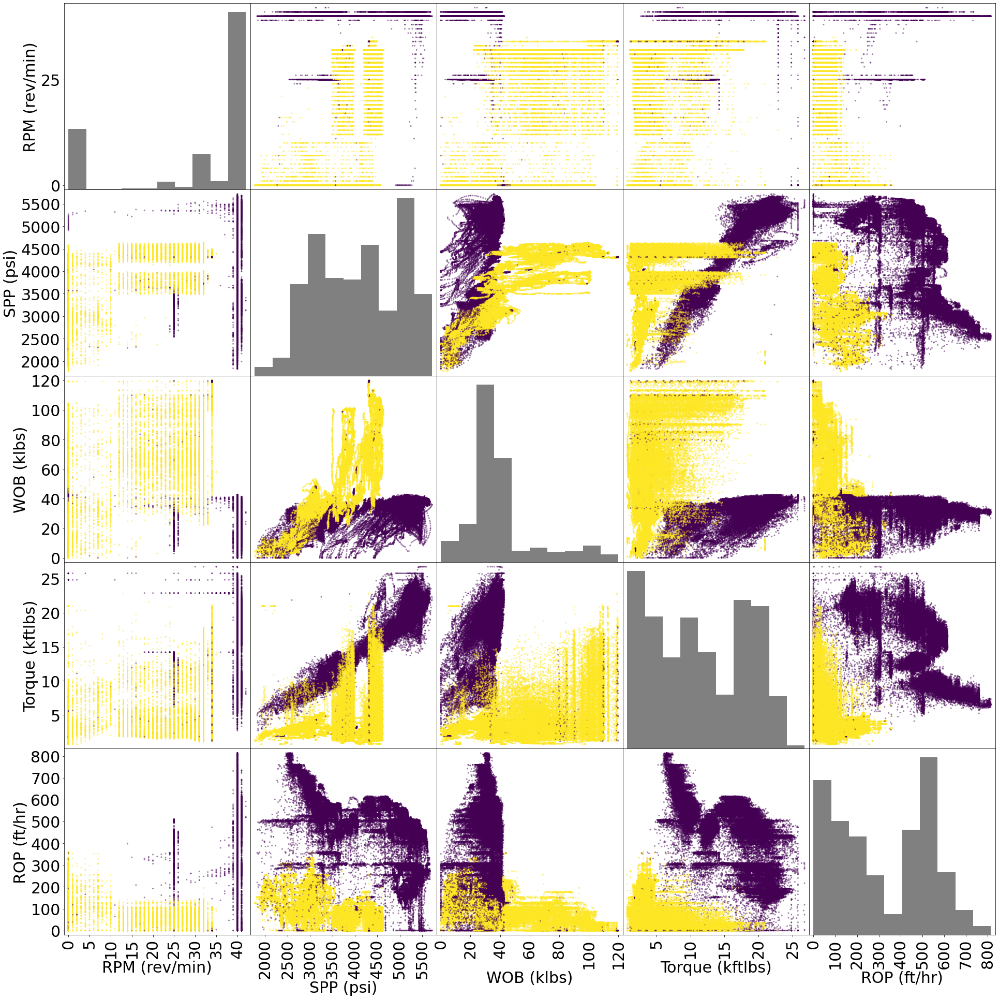

In [13]:
df_plot = df[['RPM','SPPA','SWOB','STOR', 'ROP','sliding']] #create new df to rename columns for scatter plot
df_plot = df_plot.rename(columns={'RPM':"RPM (rev/min)", 
                         'SPPA':'SPP (psi)',
                         'SWOB': 'WOB (klbs)',
                         'STOR': 'Torque (kftlbs)',
                         'ROP': 'ROP (ft/hr)'})

axes = pd_plot.scatter_matrix(df_plot[['RPM (rev/min)','SPP (psi)','WOB (klbs)','Torque (kftlbs)', 'ROP (ft/hr)']], alpha = 0.5,           # pandas matrix scatter plot
    figsize=(5, 5),c = df_plot['sliding'], hist_kwds={'color':['grey']})

#y ticklabels
[plt.setp(item.yaxis.get_majorticklabels(), 'size', 30) for item in axes.ravel()]
#x ticklabels
[plt.setp(item.xaxis.get_majorticklabels(), 'size', 30) for item in axes.ravel()]
#y labels
[plt.setp(item.yaxis.get_label(), 'size', 30) for item in axes.ravel()]
#x labels
[plt.setp(item.xaxis.get_label(), 'size', 30) for item in axes.ravel()]

plt.subplots_adjust(left=0.0, bottom=0.0, right=5, top=5, wspace=0, hspace=0) #ajust plot size 

Visually, although there is a very clear relationship between ROP and sliding/not sliding (see far right of plot), expert knowledge dictates that ROP should not be used to classify sliding vs not sliding. Periods of low ROP for example, could simply be hard drilling. 

More importantly, WOB data can easily be affected as a result of weight transfer issues due to hole deviation. 

As a result, the most reliable features to determine drilling state, in this case, would be <b>RPM</b>, <b>torque</b> and <b>standpipe pressure</b>.

# Artificial neural net using PyTorch

A neural net was trained to identify sliding vs. rotary drilling in the data set. Decision trees/Random Forrest have been used in the past to analyze drilling data. As a sequence of nested if statements, they could have been appropriate for this project, if pipe rocking wasn't occuring. Before pipe rocking, sliding could simply be identified as Bit Depth = Hole Depth and RPM = 0, where as now, pipe rocking whilst sliding, results in RPM values >0, making it hard to differentiate from rotary drilling. However, it is clear the data is complex and non-linear and thus we would require a model that can capture/predict with complicated features, such as an artificial neural network. 

Workflow as follows:


* **1. Remove NaN's and Normalise data**
* **2. Create a random split and define training and testing data sets**
* **3. Check shape and sizes of all the arrays**
* **4. Train model** 
* **5. Evaluate training and testing results**



### 1. Remove NaN's and Normalise data

Loss function requires features to be normalised, so when we feed forward the information, the non-linear transformation is effective and can see the differences and doesnt become insensitive.


In [14]:
df = df.drop(columns =['Date/Time','BLOCK_STATE'],axis = 1) #drop unnecessary columns
df=df.fillna(-1) # pytorch does not work nans so make them -1

df_noindex = df.reset_index(drop=True)# we need to normalize the data for the nn (loss function) , normalizing the entire dataframe and naming as df2

min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(df_noindex.values)

df2 = pd.DataFrame(x_scaled, columns=df_noindex.columns)

df2.describe().transpose() #confirm data is normalised 

,count,mean,std,min,25%,50%,75%,max
RPM,166309.0,0.710389,0.376711,0.0,0.666667,0.952381,0.952381,1.0
STOR,166309.0,0.411119,0.263242,0.0,0.132112,0.376065,0.667818,1.0
DEPT,166309.0,0.592774,0.297363,0.0,0.338898,0.626478,0.871588,1.0
BPOS,166309.0,0.573681,0.257110,0.0,0.358864,0.624785,0.788296,1.0
HDTH,166309.0,0.592774,0.297363,0.0,0.338898,0.626478,0.871588,1.0
HKLD,166309.0,0.594813,0.192022,0.0,0.500000,0.633008,0.760446,1.0
SPPA,166309.0,0.588121,0.235273,0.0,0.374494,0.600709,0.821103,1.0
ROP,166309.0,0.394102,0.265101,0.0,0.136155,0.369064,0.620130,1.0
SWOB,166309.0,0.332731,0.191978,0.0,0.239167,0.290000,0.331667,1.0
sliding,166309.0,0.378272,0.484957,0.0,0.000000,0.000000,1.000000,1.0


### 2. Create a random split and define training and testing data sets

RPM, STOR and SPPA were chosen as the most relevant features to train with and a random 80/20 train/test split was used

In [15]:
# random split

channels = ['RPM', 'STOR', 'SPPA'] #train with RPM, SPPA and STOR only
channel_to_predict = 'sliding'
full_dataset = df2[channels]

train_size = int(0.8 * len(full_dataset)) # number of training data 
test_size = len(full_dataset) - train_size # no of testing data 

training_dataset, test_dataset = torch.utils.data.random_split(full_dataset, [train_size, test_size])

training_target = df2[channel_to_predict][training_dataset.indices] # training: Actual value from sliding column 
test_target = df2[channel_to_predict][test_dataset.indices] # testing: Actual value from sliding column 


### 3. Check shape and sizes of all the arrays

In [16]:
test_dataset_to_input = torch.from_numpy(test_dataset.dataset[channels].loc[test_dataset.indices].values.astype(float))

train_dataset = torch.from_numpy(training_dataset.dataset[channels].loc[training_dataset.indices].values.astype(float))

training_target = np.resize(training_target,(len(training_target),1))

train_target_dataset = torch.from_numpy(training_target.astype(float))

print(test_dataset_to_input.size(),train_dataset.size(),np.shape(training_target),np.shape(train_target_dataset))

torch.Size([33262, 3]) torch.Size([133047, 3]) (133047, 1) torch.Size([133047, 1])


### 4. Train model 

The model created has 3 inputs (as decided through expert knowledge, discussed previously), 2 hidden layers with 5 and 3 nodes respectively and a single output. There are a lot of hyperparameters that can be tweaked/tuned to control the complexity of the model. This configuration was chosen to optimize results whilst minimizing computational time. More neurons/layers can be added to improve accuracy, however this is at the expense of computational time and memory.

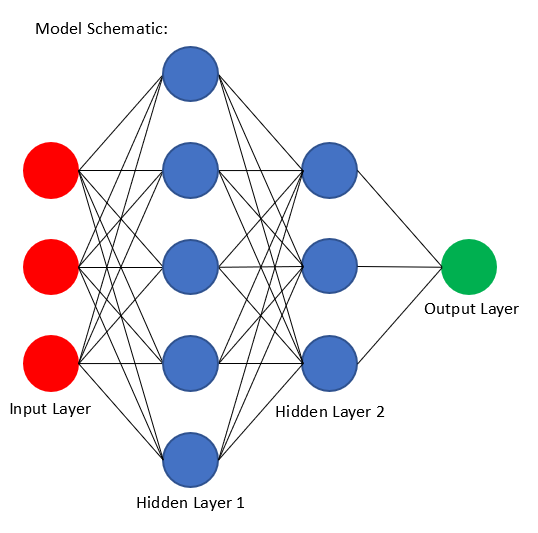

Furthermore, as we are working with probabilities and a single output (1 = sliding, 0 = not sliding) we do not have to do a back transformation on the other side.

#### Activation Functions

Activation functions are important as they introduce non-linear properties to the network (so we don't just have linear regression) and they increase the power for the model to learn complicated patterns:

Here we are using both:

* <b>ReLU</b> (computationally efficient and converges quickly) and;
* <b>Sigmoid</b>

The sigmoid function was used as this is a binary/classification problem, meaning we are just looking for a yes/no answer. Furthermore, the sigmoid function provides a smooth gradient for gradient-based optimization and is computationally cheap.

#### Learning rate and Optimization

The Adam (Adaptive moment estimation) optimizer was used with a learning rate of 0.001. The driver here is that Adam is adaptive to the degree of stability in the system and will slow down or implement the full learning rate depending on the variability of the gradient between batches/epochs. This helps avoid getting stuck in local minimas or overshooting the mark.

#### Epochs and batches

100,000 epochs were chosen for this model. For each epoch we pass through all the training data, forward calculate the error, loss function and then we back propagate and adjust the weights. As we continue to do this, our loss (error in the model) decreases and model accuracy increases. The higher the number of epochs, the lower the overall error. However, the trade off is increased computational time. 


Batches were not used in the iterations, and as a result we have better error estimates, but increased computational time.


In [17]:
class Net(torch.nn.Module): # function editted from Venelin Valkov, https://curiousily.com/posts/build-your-first-neural-network-with-pytorch/
    def __init__(self, n_features):
        super(Net, self).__init__()
        self.fc1 = torch.nn.Linear(n_features, 5)
        self.fc2 = torch.nn.Linear(5, 3)
        self.fc3 = torch.nn.Linear(3, 1)
    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        return torch.sigmoid(self.fc3(x)) #output with 

net = Net(train_dataset.shape[1])

# train_dataset.float()
loss_fn = torch.nn.BCELoss() # Used as we have a sigmoid layer in the network
optimizer = torch.optim.Adam(net.parameters(), lr=0.001)#learning rate determined through brute force 

epoch_list = []
loss_list = []

for t in range(100000):
    
    # Forward pass: Compute predicted y by passing x to the model
    y_pred = net(train_dataset.float())

    # Compute and print loss
    loss = loss_fn(y_pred, train_target_dataset.float())
    if t % 200 ==0:
        epoch_list.append(t)
        loss_list.append(loss.item())
        print(t, loss.item())

    # Zero gradients, perform a backward pass (learn from the errors that is currently making), and update the weights
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

0 0.664556622505188
200 0.5489215850830078
400 0.42735204100608826
600 0.3356262147426605
800 0.25182148814201355
1000 0.2007581740617752
1200 0.1699313074350357
1400 0.1496942788362503
1600 0.13559123873710632
1800 0.12514710426330566
2000 0.1170990988612175
2200 0.11075805127620697
2400 0.10569316148757935
2600 0.10160599648952484
2800 0.09826775640249252
3000 0.0955096110701561
3200 0.09320631623268127
3400 0.09126202762126923
3600 0.08960532397031784
3800 0.08818184584379196
4000 0.0869511216878891
4200 0.08588176965713501
4400 0.08495009690523148
4600 0.08413664996623993
4800 0.08342625945806503
5000 0.08280538767576218
5200 0.08226249366998672
5400 0.08178699016571045
5600 0.08137181401252747
5800 0.08101040124893188
6000 0.08068155497312546
6200 0.08032073825597763
6400 0.07994361966848373
6600 0.07960566878318787
6800 0.07931890338659286
7000 0.07909157127141953
7200 0.07892288267612457
7400 0.07878655195236206
7600 0.078672856092453
7800 0.07857934385538101
8000 0.078502200543

We can visualise the loss function and see it approaches zero as epoch number increases, improving model accuracy:

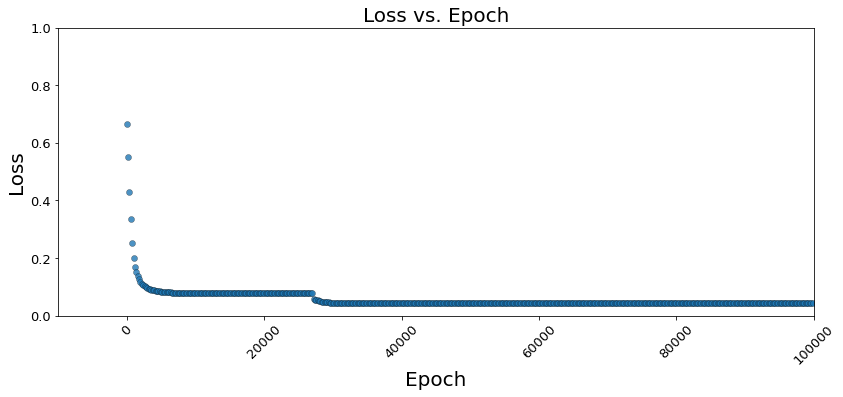

In [18]:
plt.subplot(122)
plt.scatter(epoch_list, loss_list,s=None, marker=None, cmap=None, norm=None, vmin=None, vmax=None, alpha=0.8, linewidths=0.3, verts=None, edgecolors="black")
plt.subplots_adjust(left=0.0, bottom=0.0, right=3.0, top=1, wspace=0.5, hspace=1)
plt.title('Loss vs. Epoch',fontsize=20); plt.xlabel('Epoch',fontsize=20); plt.ylabel('Loss',fontsize=20)
plt.xlim([-10000,100000]);plt.ylim([0,1])
plt.tick_params(axis='both', which='major', labelsize=13) #tick labels
plt.xticks(rotation=45)

plt.subplots_adjust(left=0.0, bottom=0.0, right=3.5, top=1, wspace=0, hspace=0) #ajust plot size 


### 5. Evaluate training and testing results

Using the **training results** we can run summary statistics on the results to evaluate the performance of the model:

In [19]:
## Training results

training_result = y_pred.data.numpy()
y_measured = training_target
y_predicted = training_result.round() # anything greater than 0.5 = sliding 

# print(y_measured)
# print(y_predicted)

rms = sqrt(mean_squared_error(y_measured, y_predicted))
r2 = r2_score(y_measured, y_predicted, sample_weight=None, multioutput='uniform_average')

print('root mean square', rms)
print('r2_score', r2)
print('median_absolute_error',mm.median_absolute_error(y_measured, y_predicted))
print('mean_absolute_error',mean_absolute_error(y_measured, y_predicted))

classes = ['Rotary', 'Sliding']
print(classification_report(y_measured, y_predicted, target_names = classes))

root mean square 0.10969658883068487
r2_score 0.9488645619954422
median_absolute_error 0.0
mean_absolute_error 0.012033341601088337
              precision    recall  f1-score   support

      Rotary       0.99      0.99      0.99     82642
     Sliding       0.98      0.99      0.98     50405

   micro avg       0.99      0.99      0.99    133047
   macro avg       0.99      0.99      0.99    133047
weighted avg       0.99      0.99      0.99    133047



The model is performing well which can be notes the median absolute error = 0 and then the mean error, similarly being 0.02.

Now we can visualise the results from the confusion matrix and can see how the model performs: 

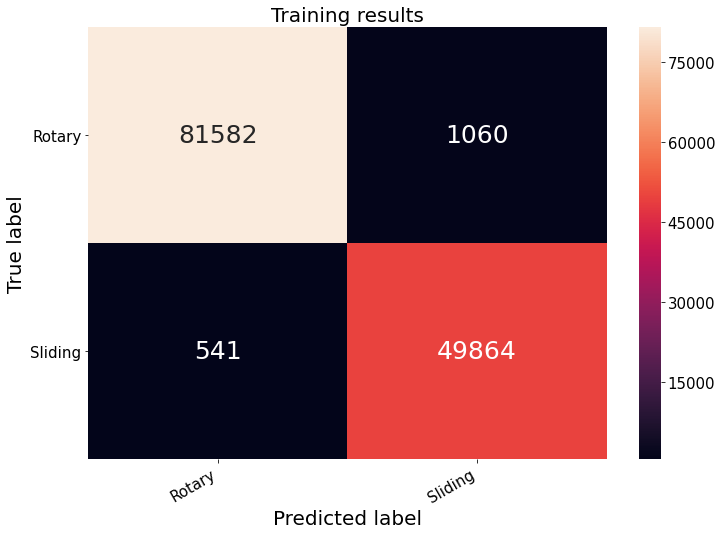

In [20]:
# Visualisation for confusion matrix, 
cm = (confusion_matrix(y_measured, y_predicted)) # function editted from Venelin Valkov, https://curiousily.com/posts/build-your-first-neural-network-with-pytorch/
df_cm = pd.DataFrame(cm, index=classes, columns=classes)
hmap = sns.heatmap(df_cm, annot=True, fmt="d",annot_kws={"fontsize":25})


#formatting
hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right') #ylabel direction 
hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')#xlabel direction 

cbar = hmap.collections[0].colorbar #font size on colour bar
cbar.ax.tick_params(labelsize=15) #font size on colour bar

plt.title('Training results',fontsize=20)
plt.ylabel('True label',fontsize=20)
plt.xlabel('Predicted label',fontsize=20);
plt.tick_params(axis='both', which='major', labelsize=15) #tick labels

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.5, top=1.5, wspace=0, hspace=0) # adjust size





From the confusion matrix above we can observe: 
    
* 81,582 points classified correctly as rotary drilling 
* 541 points misclassified as rotary drilling  
* 49,864 points classified correctly as sliding 
* 1,060 points misclassified as sliding

The model has performed well in training but now we need to evaluate the testing data. Here we are running the 20% **testing** split through model and visualising results:

In [21]:
test_target = np.resize(test_target,(len(test_target),1)) # we need to resize because of Pytorch requirement
model = net #rename model = net 

In [22]:
y_pred_test = model(test_dataset_to_input.float()) #model results
testing_result = y_pred_test.data.numpy() #reformat results for statistical measurements 

In [23]:
# Testing results

y_measured = test_target
y_predicted = testing_result.round()

rms = sqrt(mean_squared_error(y_measured, y_predicted))
r2 = r2_score(y_measured, y_predicted, sample_weight=None, multioutput='uniform_average')

print('root mean square', rms)
print('r2_score', r2)
print('median_absolute_error',mm.median_absolute_error(y_measured, y_predicted))
print('mean_absolute_error',mean_absolute_error(y_measured, y_predicted))

classes = ['Rotary', 'Sliding']
print(classification_report(y_measured, y_predicted, target_names = classes))

root mean square 0.1136998909565685
r2_score 0.9448978514293565
median_absolute_error 0.0
mean_absolute_error 0.012927665203535567
              precision    recall  f1-score   support

      Rotary       0.99      0.99      0.99     20757
     Sliding       0.98      0.99      0.98     12505

   micro avg       0.99      0.99      0.99     33262
   macro avg       0.99      0.99      0.99     33262
weighted avg       0.99      0.99      0.99     33262



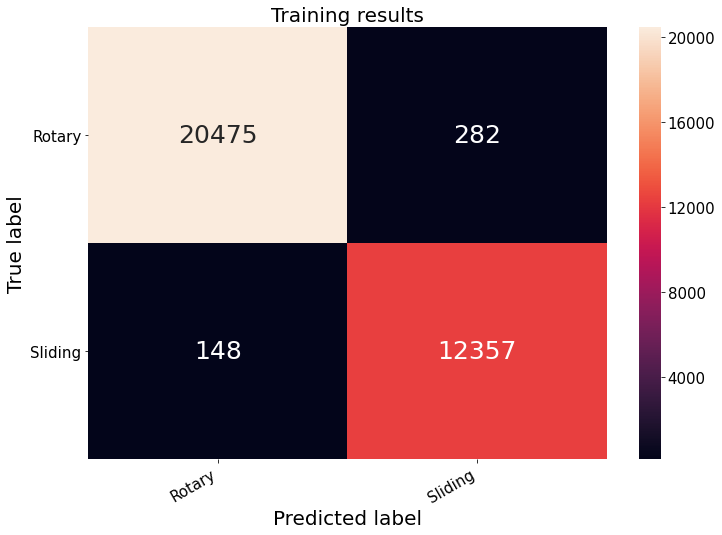

In [24]:
# Visualisation for confusion matrix, 
cm = (confusion_matrix(y_measured, y_predicted)) # function editted from Venelin Valkov, https://curiousily.com/posts/build-your-first-neural-network-with-pytorch/
df_cm = pd.DataFrame(cm, index=classes, columns=classes)
hmap = sns.heatmap(df_cm, annot=True, fmt="d",annot_kws={"fontsize":25})


#formatting
hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right') #ylabel direction 
hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')#xlabel direction 

cbar = hmap.collections[0].colorbar #font size on colour bar
cbar.ax.tick_params(labelsize=15) #font size on colour bar

plt.title('Training results',fontsize=20)
plt.ylabel('True label',fontsize=20)
plt.xlabel('Predicted label',fontsize=20);
plt.tick_params(axis='both', which='major', labelsize=15) #tick labels

plt.subplots_adjust(left=0.0, bottom=0.0, right=1.5, top=1.5, wspace=0, hspace=0) # adjust size

From the confusion matrix above we can observe: 
    
* 20,475 points classified correctly as rotary drilling 
* 148 points misclassified as rotary drilling  
* 12,357 points classified correctly as sliding 
* 282 points misclassified as sliding

### Results

The results show that when using accurately labelled data and features such as RPM, STOR and SPPA we are able to accurately classify sliding vs. rotary drilling. In both cases, median error was 0 and mean error ~1.2%
The choice of predictor features did effect the model. To test the hypothesis, I attempted to model RPM, STOR and SWOB. The result was a consistent loss of ~60%, regardless of epoch number. This would be a direct result of the inaccuracy of the SWOB data due to the hole deviation. Standpipe pressure, although it is also a function of GPM, mud weight etc..., is a much better predictor feature as it can reflect the WOB in highly deviated wells (through differential pressure measurements (on vs. off bottom). Thus, it is important to sense check and understand the nature of the data being fed into the model to ensure optimum model performance, as one size does not fit all.

The choice of learning rate, Adam optimizer and number of epochs helped reduce the model error. The large number of epochs meant we were able to back propagate and adjust the weights numerous times, improving the accuracy of the model. However, this was at the expense of computational time as the model was slow (~56 mins to train). By using batches, we could have improved the computational time, and although we could have noisier estimates of  error, this would have allowed us to run more epochs more efficiently and create a more robust model. Furthermore, by using batches and creating stochasticity, we could also prevent over fitting of the model and further improve results in testing. 
Also, as mentioned earlier the design of the model could also have tuned to improve accuracy. Currently, the model only has two hidden layers with 5 and 3 nodes, respectively. More neurons/layers could be added to improve accuracy, however this would be at the expense of computational time and memory. 

Finally, although all efforts were made to accurately label the data, it is as possible that small errors in labelling (i.e inaccurately identifying the transition periods between sliding and rotary drilling by 30 or so seconds) could have influenced the small amount of error seen. However, to enure 100% accuracy, this would have to be done manually and require large amounts of time.

Machine learning is an optimization problem between model error and computational time. Given infinite processing power and time, the most robust and accurate models could be created. However, in real world situations compromises need to be made to ensure the models are practical and functional for accessibility  and deployment.   

Possible future work:

* **Incorporate batches into the model**
* **Run a seconded labelled dataset through the model for further validation** 
* **Build a decision tree/Random Forrest model and compare results, to evaluate decision tree analysis as a means of rig state detection** 





I hope this was helpful,

Ysabel Witt-Doerring

___________________

#### Work Supervised by:

### Michael Pyrcz, Associate Professor, University of Texas at Austin 
*Novel Data Analytics, Geostatistics and Machine Learning Subsurface Solutions*

With over 17 years of experience in subsurface consulting, research and development, Michael has returned to academia driven by his passion for teaching and enthusiasm for enhancing engineers' and geoscientists' impact in subsurface resource development. 

For more about Michael check out these links:

#### [Twitter](https://twitter.com/geostatsguy) | [GitHub](https://github.com/GeostatsGuy) | [Website](http://michaelpyrcz.com) | [GoogleScholar](https://scholar.google.com/citations?user=QVZ20eQAAAAJ&hl=en&oi=ao) | [Book](https://www.amazon.com/Geostatistical-Reservoir-Modeling-Michael-Pyrcz/dp/0199731446) | [YouTube](https://www.youtube.com/channel/UCLqEr-xV-ceHdXXXrTId5ig)  | [LinkedIn](https://www.linkedin.com/in/michael-pyrcz-61a648a1)

#### Want to Work Together?

I hope this content is helpful to those that want to learn more about subsurface modeling, data analytics and machine learning. Students and working professionals are welcome to participate.

* Want to invite me to visit your company for training, mentoring, project review, workflow design and / or consulting? I'd be happy to drop by and work with you! 

* Interested in partnering, supporting my graduate student research or my Subsurface Data Analytics and Machine Learning consortium (co-PIs including Profs. Foster, Torres-Verdin and van Oort)? My research combines data analytics, stochastic modeling and machine learning theory with practice to develop novel methods and workflows to add value. We are solving challenging subsurface problems!

* I can be reached at mpyrcz@austin.utexas.edu.

I'm always happy to discuss,

*Michael*

Michael Pyrcz, Ph.D., P.Eng. Associate Professor The Hildebrand Department of Petroleum and Geosystems Engineering, Bureau of Economic Geology, The Jackson School of Geosciences, The University of Texas at Austin
